In [1]:
import torch
from torchsummary import summary
import torch 
import os
import numpy as np
import nibabel as nib
import imageio.v2 as im
import matplotlib.pyplot as plt
import glob
from torch.utils.data import Dataset, DataLoader, TensorDataset, random_split
from torchvision import transforms, utils
import pdb
import datetime
from torchmetrics import JaccardIndex
from torch.utils.tensorboard import SummaryWriter
from ResUnet7TFLAIR import *
import tqdm
import gc
torch.cuda.get_device_name(0)

GPU available: True


'NVIDIA A100-PCIE-40GB'

In [2]:
class DiceLoss(nn.Module):

    def __init__(self):
        super(DiceLoss, self).__init__()
        self.smooth = 1.0

    def forward(self, y_pred, y_true):
        assert y_pred.size() == y_true.size()
        y_pred = y_pred[:, 0].contiguous().view(-1)
        y_true = y_true[:, 0].contiguous().view(-1)
        intersection = (y_pred * y_true).sum()
        dsc = (2. * intersection + self.smooth) / (
            y_pred.sum() + y_true.sum() + self.smooth
        )
        return 1. - dsc

In [3]:
config = {
    'batch_size': 64, # Increase this if your GPU can handle it
    'lr': 0.0001,
    'epochs': 100, # 10 epochs is recommended ONLY for the early submission - you will have to train for much longer typically.
    # Include other parameters as needed.
}

criterion = DiceLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=config['lr'], betas=(0.9, 0.999), eps=1e-08, weight_decay=0)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode="min", factor=0.8, patience=2)

In [4]:
def readImage(path,subjN):
    img_array = []
    img_dir = []
    affine_array = []
    counter = 0
    for directory_path in path:
        img_dir.append(directory_path)
    img_dir.sort()
    for path_i in img_dir:
        img = nib.load(path_i).get_fdata()
        img = img/np.max(img)
        affine = nib.load(path_i).affine
        img_array.append(img)
        affine_array.append(affine)
        counter += 1
        if counter >= subjN: break

    img_array = np.array(img_array)
    affine_array = np.array(affine_array)
    print(path_i)
    return img_array, affine_array


In [5]:
def sliceImage(image, output_size):
    image_stack = []
    new_h, new_w = output_size    
    for img in image:
        h, w, z = np.shape(img)
        
        if h < new_h:
            pad_size = int((new_h - h)/2)
            img = np.pad(img, ((pad_size, pad_size), (0,0), (0,0)))
        elif h > new_h:
            crop_size = int((h - new_h)/2)
            img = img[crop_size:h-crop_size, :, :]

        if w < new_w:
            pad_size = int((new_w - w)/2)
            img = np.pad(img, ((0,0), (pad_size, pad_size), (0,0)))
        elif w > new_w:
            crop_size = int((w - new_w)/2)
            img = img[:, crop_size:w-crop_size, :]
    
        for z in range(np.shape(img)[2]):
            img_z = np.rot90(img[:,:,z])
            img_z = np.expand_dims(img_z, 0)
            image_stack.append(img_z)

        
    return np.array(image_stack)


In [6]:
def load_train_val(train, val, size, num):
    img_train = glob.glob(train['img'])
    mask_train = glob.glob(train['mask'])
    
    img_test = glob.glob(val['img'])
    mask_test = glob.glob(val['mask'])
    
    img_train = natsorted(img_train)
    mask_train = natsorted(mask_train)
    
    img_test = natsorted(img_test)
    mask_test = natsorted(mask_test)
    
    FLAIR_train, FLAIR_train_affine = readImage(img_train, num)
    FLAIR_train_mask, _ = readImage(mask_train, num)
    FLAIR_train_stack = sliceImage(FLAIR_train, size)
    mask_train_stack = sliceImage(FLAIR_train_mask, size)
    
    FLAIR_test, FLAIR_test_affine = readImage(img_test, num)
    FLAIR_test_mask, _ = readImage(mask_test, num)
    FLAIR_test_stack = sliceImage(FLAIR_test, size)
    mask_test_stack = sliceImage(FLAIR_test_mask, size)
    
    flair_trainset = TensorDataset(torch.tensor(FLAIR_train_stack), torch.tensor(mask_train_stack))
    flair_testset = TensorDataset(torch.tensor(FLAIR_test_stack), torch.tensor(mask_test_stack))
    
    return flair_trainset, flair_testset
    

In [32]:

# train = {'img': '/ihome/tibrahim/jil202/02-Unet_segmentation/7T_data/7TSVD/nii/FLAIR/*.nii.gz', 
#         'mask': '/ihome/tibrahim/jil202/02-Unet_segmentation/7T_data/7TSVD/nii/wmh_mask/*.nii.gz'}

# test = {'img': '/ihome/tibrahim/jil202/02-Unet_segmentation/7T_data/7TSVD/nii/FLAIR/holdout/*.nii.gz',
#        'mask': '/ihome/tibrahim/jil202/02-Unet_segmentation/7T_data/7TSVD/nii/wmh_mask/holdout/*.nii.gz'}


train = {'img': '/ihome/tibrahim/jil202/02-Unet_segmentation/3T_data/3T_KLU_APC2/nii/FLAIR/*.nii', 
        'mask': '/ihome/tibrahim/jil202/02-Unet_segmentation/3T_data/3T_KLU_APC2/nii/wmh_mask/*.nii'}

test = {'img': '/ihome/tibrahim/jil202/02-Unet_segmentation/3T_data/3T_KLU_APC2/nii/FLAIR/holdout/*.nii',
       'mask': '/ihome/tibrahim/jil202/02-Unet_segmentation/3T_data/3T_KLU_APC2/nii/wmh_mask/holdout/*.nii'}

flair_trainset, flair_testset = load_train_val(train, test, [256, 256], 120)

train_loader = DataLoader(flair_trainset, batch_size = 32, shuffle=True)
test_loader = DataLoader(flair_testset, batch_size = 32, shuffle=True)


/scratch/slurm-417028/ipykernel_26538/3085948637.py:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  img_array = np.array(img_array)


/ihome/tibrahim/jil202/02-Unet_segmentation/3T_data/3T_KLU_APC2/nii/FLAIR/804200_FLAIR.nii
/ihome/tibrahim/jil202/02-Unet_segmentation/3T_data/3T_KLU_APC2/nii/wmh_mask/804200_FLAIR_wmh.nii
/ihome/tibrahim/jil202/02-Unet_segmentation/3T_data/3T_KLU_APC2/nii/FLAIR/holdout/802593_FLAIR.nii
/ihome/tibrahim/jil202/02-Unet_segmentation/3T_data/3T_KLU_APC2/nii/wmh_mask/holdout/802593_FLAIR_wmh.nii


In [33]:
state_dict = torch.load('/ihome/tibrahim/jil202/02-Unet_segmentation/wmh_pytorch_development/7T_No_Norm.pth')
model.load_state_dict(state_dict['model_state_dict'])

<All keys matched successfully>

In [9]:
def train(model, epoch, dataloader, optimizer, criterion):
    model.train()
    running_loss = 0
    IOU = 0
    batch_bar = tqdm.tqdm(total=len(dataloader), dynamic_ncols=True, leave=False, position=0, desc='Train', ncols=5)
    for i, data in enumerate(dataloader, 0):
        images, labels = data[0].to(device), data[1].to(device)
        outputs = model(images.float())
        loss = criterion(outputs, labels.float())

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        jaccard = JaccardIndex(num_classes=2).to(device)
        acc = jaccard(outputs, labels.int())
        
        acc = torch.Tensor.cpu(acc)
        IOU += acc
        
        batch_bar.set_postfix(
            acc='{:.04f}%'.format(100*IOU/(i+1)),
            loss='{:.04f}'.format(float(running_loss)/(i+1)),
            lr='{:.04f}'.format(float(optimizer.param_groups[0]['lr'])))
        batch_bar.update()
    batch_bar.close()

    epoch_acc = IOU/len(dataloader)
    epoch_loss = float(running_loss/len(dataloader))
    

    return epoch_acc * 100, epoch_loss
        

In [10]:
def validate(model, dataloader, criterion):
    model.eval()
    batch_bar = tqdm.tqdm(total=len(dataloader), dynamic_ncols=True, position=0, leave=False, desc='Val', ncols=5)

    IOU = 0.0
    running_loss = 0.0

    for i, data in enumerate(dataloader):
        
        # Move images to device
        images, labels = data[0].to(device), data[1].to(device)
        
        
        # Get model outputs
        with torch.inference_mode():
            outputs = model(images.float())
            loss = criterion(outputs, labels)
        
        jaccard = JaccardIndex(num_classes=2).to(device)
        acc = jaccard(outputs, labels.int())
        acc = torch.Tensor.cpu(acc)
        IOU += acc
        running_loss += float(loss.item())

        batch_bar.set_postfix(
            acc="{:.04f}%".format(100 * IOU / (i + 1)),
            loss="{:.04f}".format(float(running_loss / (i + 1))))

        batch_bar.update()
        
        if i % 9 == 0:
            test_input = images[0,:,:,:].expand(1,-1, -1, -1) 
            test_output = model(test_input.float())
            test_output = torch.Tensor.cpu(test_output)
            test_output = test_output.detach().numpy()
            test_input = torch.Tensor.cpu(test_input)
            label_img = torch.Tensor.cpu(labels[0,:,:,:])
            label_img = label_img.detach().numpy()



            plt.figure(1)
            f, axs = plt.subplots(2,2,figsize=(15,15))
            plt.subplot(141)
            plt.imshow(test_output[0,0,:,:], cmap = 'gray')
            plt.subplot(142)
            plt.imshow(test_input[0,0,:,:], cmap = 'gray')
            plt.subplot(143)
            plt.imshow(test_input[0,0,:,:], cmap = 'gray')
            plt.imshow(test_output[0,0,:,:], cmap = 'gray', alpha = 0.5)
            plt.subplot(144)
            plt.imshow(test_input[0,0,:,:], cmap = 'gray')
            plt.imshow(label_img[0,:,:], cmap = 'gray', alpha = 0.5)

            plt.show()

        
    batch_bar.close()
    
    epoch_acc = IOU/len(dataloader)
    epoch_loss = float(running_loss/len(dataloader))

    return epoch_acc * 100, epoch_loss


In [34]:
torch.cuda.empty_cache()
gc.collect()

2309

In [40]:
epoch_test_loss

0.28005299924390864

Val:   0%|                                                       | 0/133 [00:00<?, ?it/s, acc=73.7496%, loss=0.3569]

<Figure size 432x288 with 0 Axes>

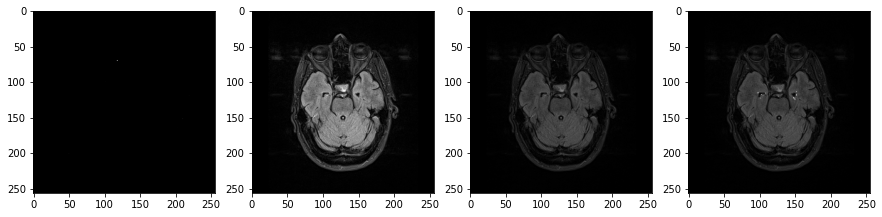

Val:   8%|███▍                                          | 10/133 [00:01<00:14,  8.73it/s, acc=79.7598%, loss=0.2564]

<Figure size 432x288 with 0 Axes>

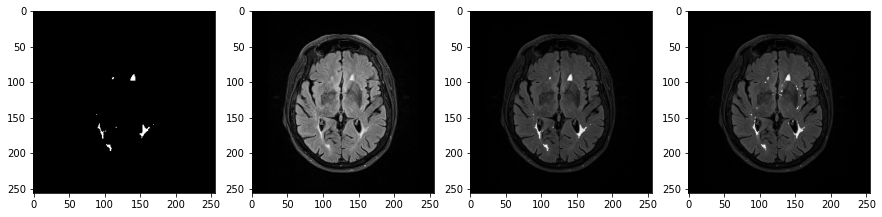

Val:  14%|██████▏                                       | 18/133 [00:02<00:10, 10.53it/s, acc=78.7722%, loss=0.2719]

<Figure size 432x288 with 0 Axes>

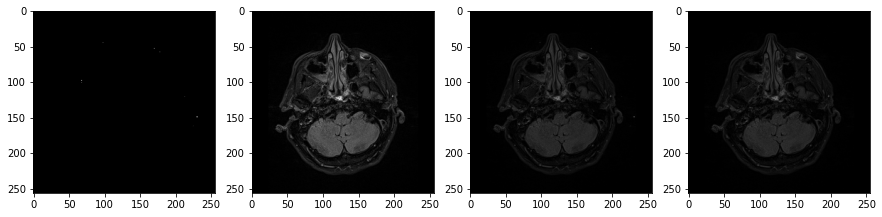

Val:  21%|█████████▋                                    | 28/133 [00:02<00:08, 12.06it/s, acc=78.8924%, loss=0.2703]

<Figure size 432x288 with 0 Axes>

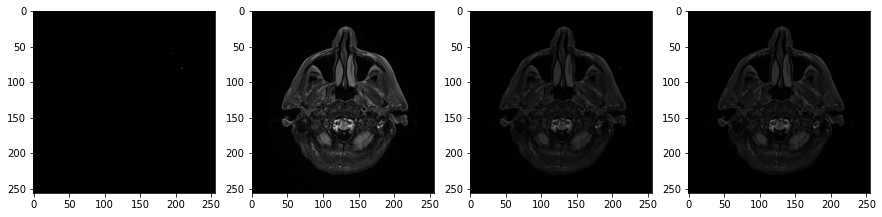

Val:  27%|████████████▍                                 | 36/133 [00:04<00:09, 10.38it/s, acc=78.5736%, loss=0.2755]

<Figure size 432x288 with 0 Axes>

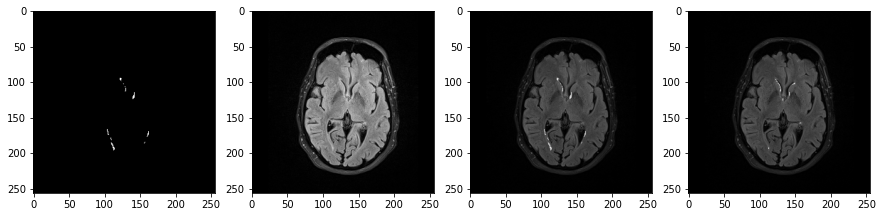

Val:  35%|███████████████▉                              | 46/133 [00:04<00:07, 11.91it/s, acc=78.7157%, loss=0.2732]

<Figure size 432x288 with 0 Axes>

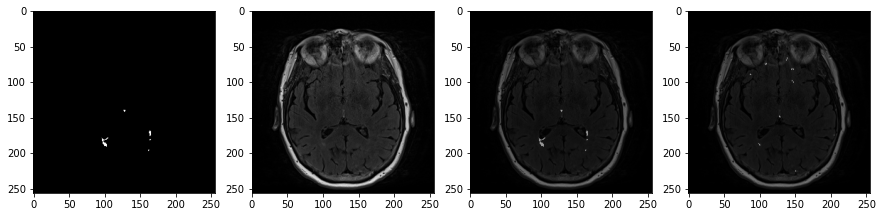

Val:  41%|██████████████████▋                           | 54/133 [00:05<00:06, 11.32it/s, acc=78.5119%, loss=0.2764]

<Figure size 432x288 with 0 Axes>

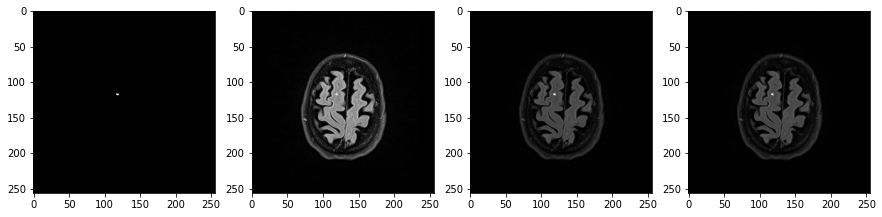

Val:  48%|██████████████████████▏                       | 64/133 [00:06<00:05, 12.09it/s, acc=78.8134%, loss=0.2715]

<Figure size 432x288 with 0 Axes>

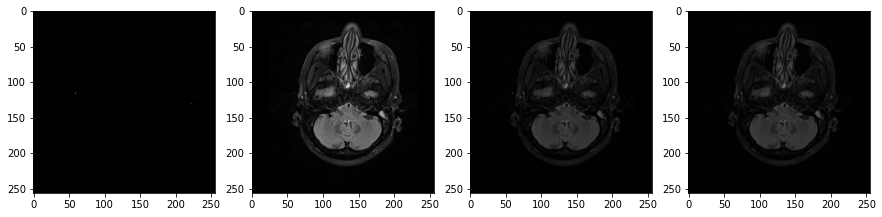

Val:  54%|████████████████████████▉                     | 72/133 [00:07<00:05, 10.65it/s, acc=78.8047%, loss=0.2716]

<Figure size 432x288 with 0 Axes>

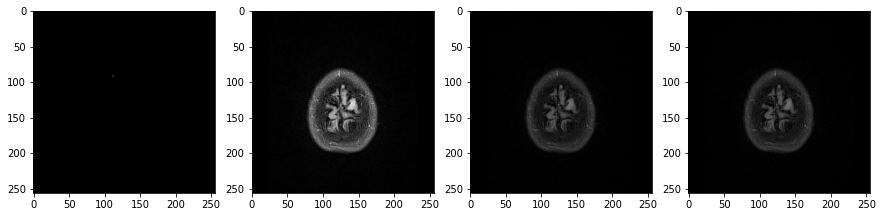

Val:  62%|████████████████████████████▎                 | 82/133 [00:08<00:04, 11.99it/s, acc=78.3756%, loss=0.2786]

<Figure size 432x288 with 0 Axes>

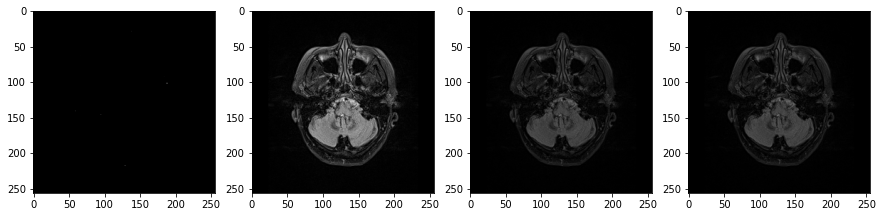

Val:  68%|███████████████████████████████▏              | 90/133 [00:09<00:03, 11.43it/s, acc=78.5322%, loss=0.2762]

<Figure size 432x288 with 0 Axes>

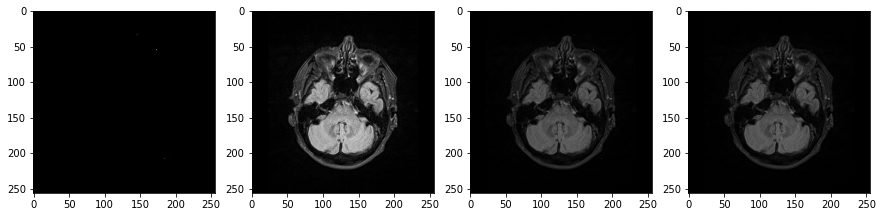

Val:  75%|█████████████████████████████████▊           | 100/133 [00:10<00:02, 12.09it/s, acc=78.4857%, loss=0.2769]

<Figure size 432x288 with 0 Axes>

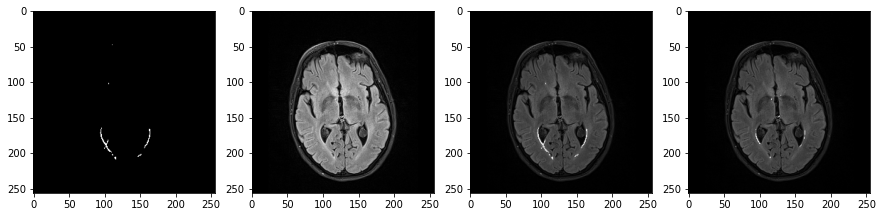

Val:  81%|████████████████████████████████████▌        | 108/133 [00:11<00:02, 10.67it/s, acc=78.3914%, loss=0.2785]

<Figure size 432x288 with 0 Axes>

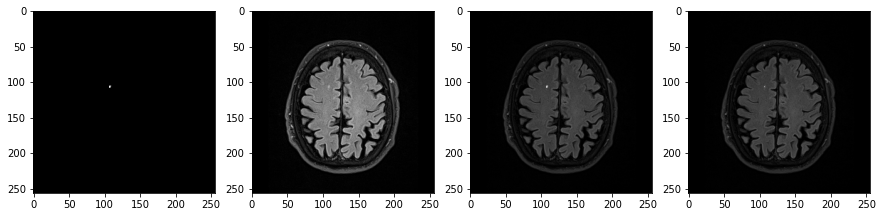

Val:  89%|███████████████████████████████████████▉     | 118/133 [00:12<00:01, 11.77it/s, acc=78.2753%, loss=0.2804]

<Figure size 432x288 with 0 Axes>

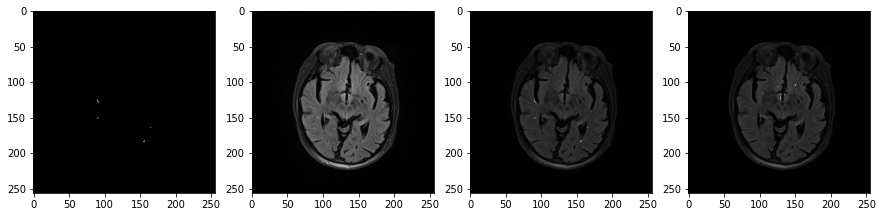

Val:  95%|██████████████████████████████████████████▋  | 126/133 [00:13<00:00, 11.19it/s, acc=78.3204%, loss=0.2797]

<Figure size 432x288 with 0 Axes>

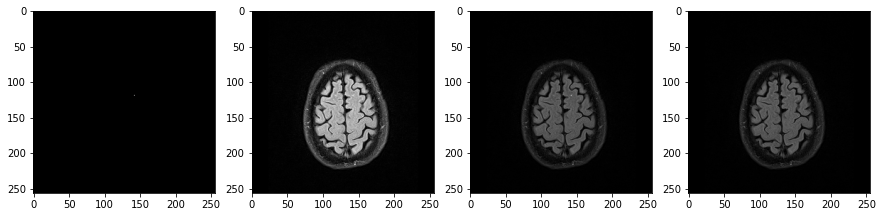

In [38]:
# epoch_train_acc, epoch_train_loss = train(model, 0, train_loader, optimizer, criterion)
epoch_test_acc, epoch_test_loss = validate(model, train_loader, criterion)

In [20]:
epoch_train_loss

0.11152771665791797

In [20]:
import wandb
wandb.login(key="b42a073c864343de9cbe5ec9cc0ef1873a03fa36")

# Create your wandb run
run = wandb.init(
    name = "7T_FLAIR_noNorm", ## Wandb creates random run names if you skip this field
    reinit = True, ### Allows reinitalizing runs when you re-run this cell
    # run_id = ### Insert specific run id here if you want to resume a previous run
    # resume = "must", ### You need this to resume previous runs, but comment out reinit = True when using this
    project = "3T_7T_FLAIR", ### Project should be created in your wandb account 
    config = config ### Wandb Config for your run
)

wandb: Currently logged in as: jinghangli21. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /ihome/tibrahim/jil202/.netrc


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=73.7969%, loss=0.3541]


Epoch 1/100: 
Train Acc 80.8100%	 Train Loss 0.2397	 Learning Rate 0.0001


<Figure size 432x288 with 0 Axes>

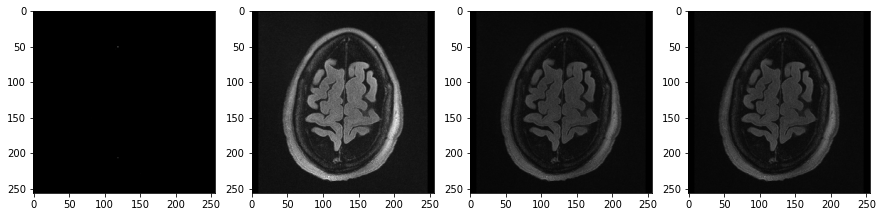

Val:  31%|███▍       | 10/32 [00:01<00:02,  7.91it/s, acc=76.6660%, loss=0.3059]

<Figure size 432x288 with 0 Axes>

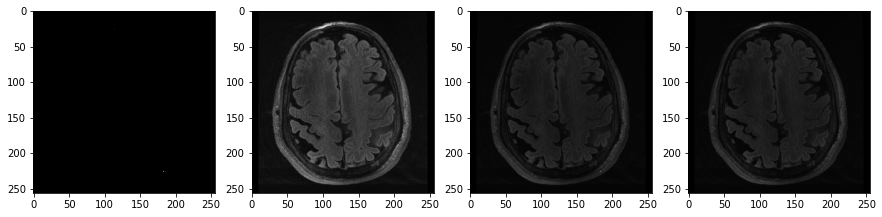

Val:  56%|██████▏    | 18/32 [00:02<00:01,  9.79it/s, acc=77.1517%, loss=0.2974]

<Figure size 432x288 with 0 Axes>

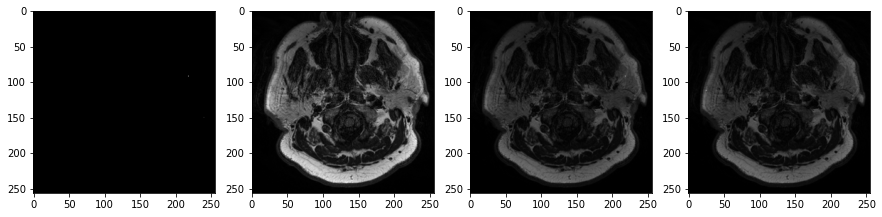

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 11.38it/s, acc=76.7721%, loss=0.3043]

<Figure size 432x288 with 0 Axes>

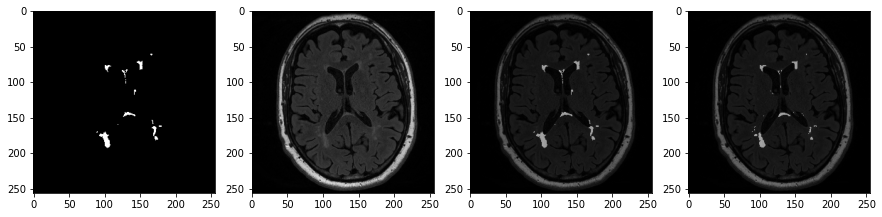

Val Acc 76.7698%	 Val Loss 0.3043
Saving model


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=79.3122%, loss=0.2603]


Epoch 2/100: 
Train Acc 82.7509%	 Train Loss 0.2099	 Learning Rate 0.0001


<Figure size 432x288 with 0 Axes>

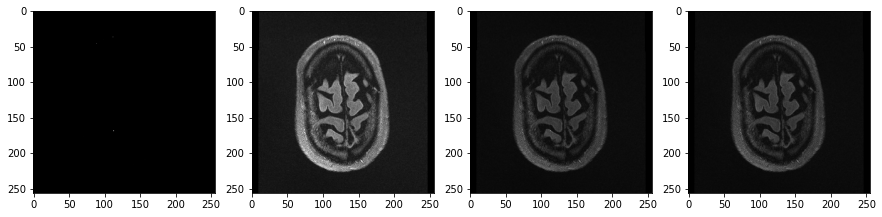

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.04it/s, acc=75.6898%, loss=0.3244]

<Figure size 432x288 with 0 Axes>

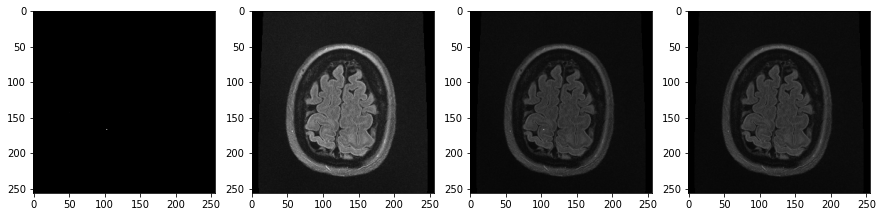

Val:  56%|██████▏    | 18/32 [00:02<00:01,  9.49it/s, acc=76.1698%, loss=0.3178]

<Figure size 432x288 with 0 Axes>

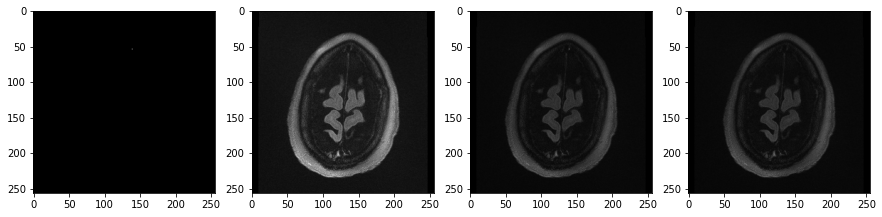

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 11.21it/s, acc=76.6892%, loss=0.3081]

<Figure size 432x288 with 0 Axes>

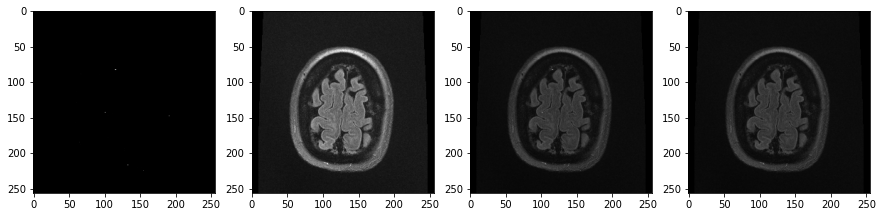

Train:   1%| | 1/157 [00:00<00:30,  5.11it/s, acc=86.6425%, loss=0.1549, lr=0.00

Val Acc 76.4809%	 Val Loss 0.3114


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=74.7191%, loss=0.3369]


Epoch 3/100: 
Train Acc 83.5492%	 Train Loss 0.1985	 Learning Rate 0.0001


<Figure size 432x288 with 0 Axes>

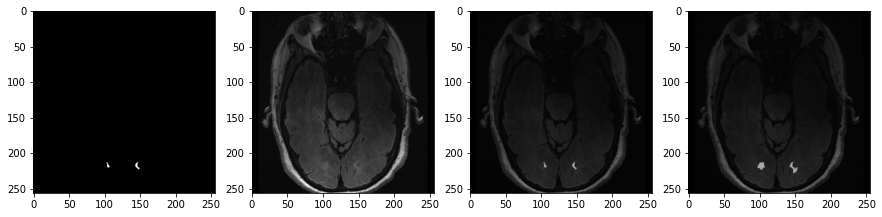

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.98it/s, acc=76.3743%, loss=0.3111]

<Figure size 432x288 with 0 Axes>

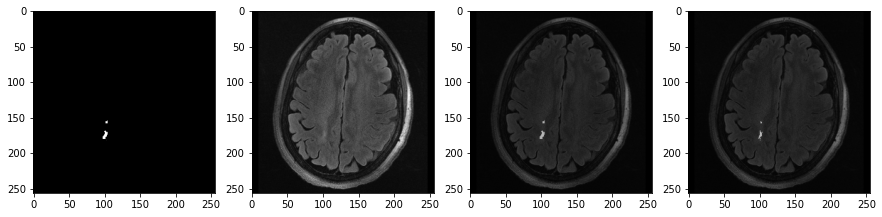

Val:  56%|██████▏    | 18/32 [00:02<00:01,  9.49it/s, acc=75.9561%, loss=0.3184]

<Figure size 432x288 with 0 Axes>

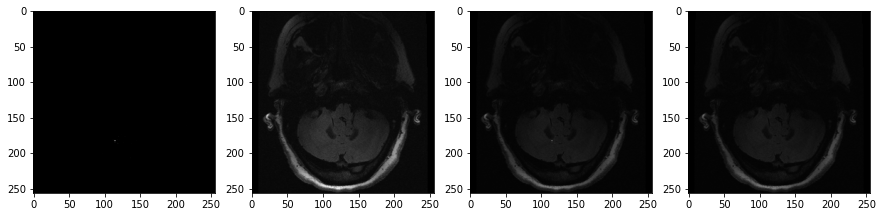

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 10.92it/s, acc=76.0675%, loss=0.3167]

<Figure size 432x288 with 0 Axes>

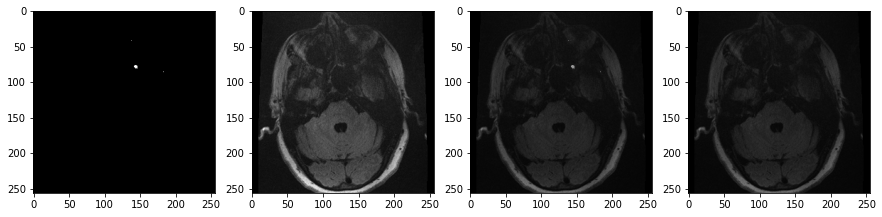

Train:   1%| | 1/157 [00:00<00:30,  5.10it/s, acc=84.0066%, loss=0.1905, lr=0.00

Val Acc 75.9986%	 Val Loss 0.3179


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=73.9184%, loss=0.3523]


Epoch 4/100: 
Train Acc 84.2493%	 Train Loss 0.1882	 Learning Rate 0.0001


<Figure size 432x288 with 0 Axes>

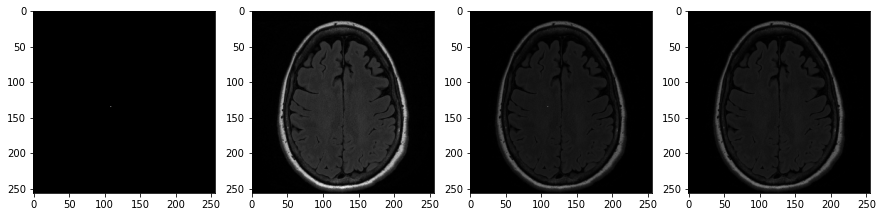

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.99it/s, acc=75.8306%, loss=0.3203]

<Figure size 432x288 with 0 Axes>

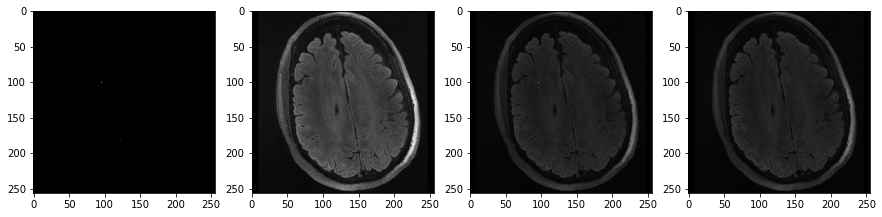

Val:  56%|██████▏    | 18/32 [00:02<00:01,  9.47it/s, acc=75.6168%, loss=0.3252]

<Figure size 432x288 with 0 Axes>

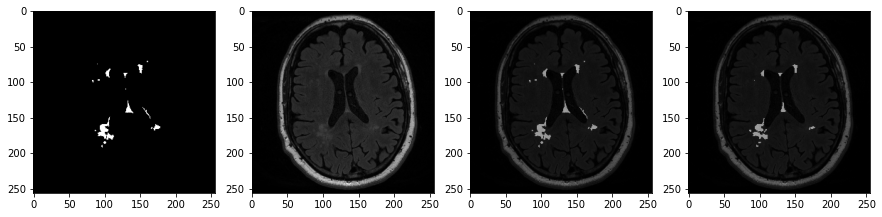

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 11.15it/s, acc=76.1590%, loss=0.3152]

<Figure size 432x288 with 0 Axes>

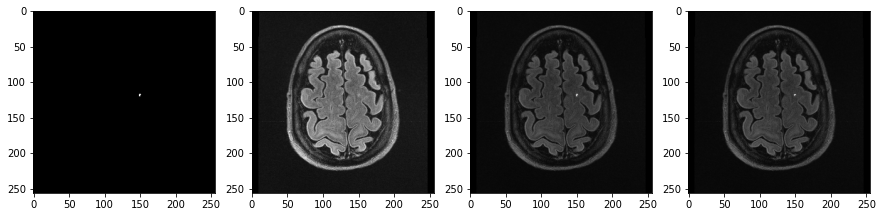

Train:   0%|      | 0/157 [00:00<?, ?it/s, acc=87.5541%, loss=0.1425, lr=0.0001]

Val Acc 75.9872%	 Val Loss 0.3182


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=77.3261%, loss=0.2921]


Epoch 5/100: 
Train Acc 85.5941%	 Train Loss 0.1695	 Learning Rate 0.0001


<Figure size 432x288 with 0 Axes>

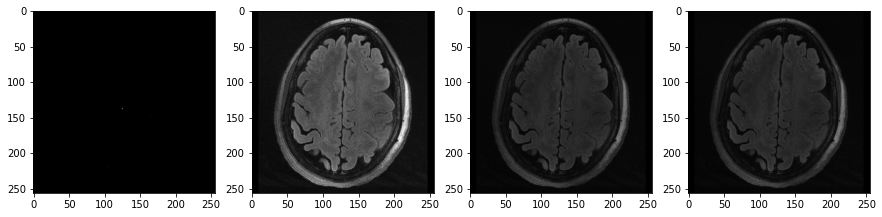

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.97it/s, acc=76.8164%, loss=0.3046]

<Figure size 432x288 with 0 Axes>

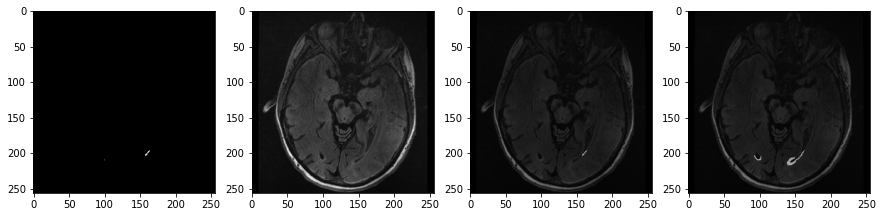

Val:  56%|██████▏    | 18/32 [00:02<00:01, 10.22it/s, acc=77.0135%, loss=0.3009]

<Figure size 432x288 with 0 Axes>

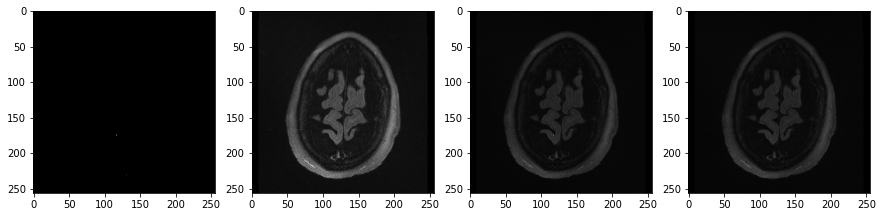

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 10.92it/s, acc=76.5280%, loss=0.3100]

<Figure size 432x288 with 0 Axes>

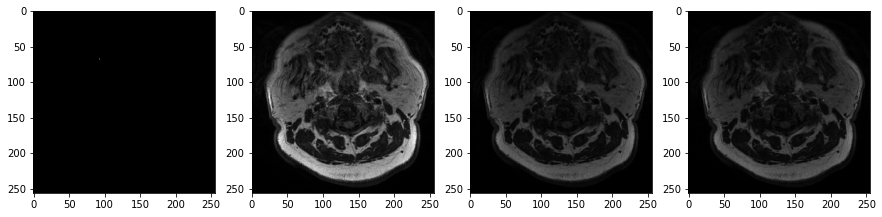

Train:   0%|      | 0/157 [00:00<?, ?it/s, acc=86.6553%, loss=0.1540, lr=0.0001]

Val Acc 76.6098%	 Val Loss 0.3084


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=71.6851%, loss=0.3950]


Epoch 6/100: 
Train Acc 86.0770%	 Train Loss 0.1629	 Learning Rate 0.0001


<Figure size 432x288 with 0 Axes>

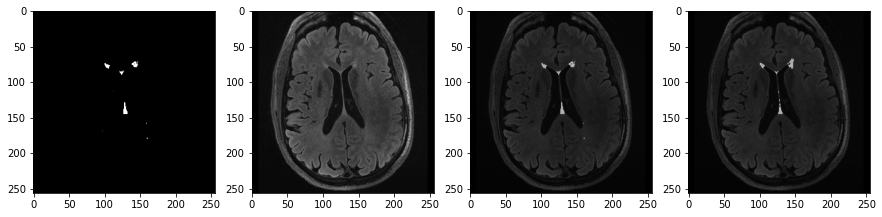

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.80it/s, acc=74.5704%, loss=0.3421]

<Figure size 432x288 with 0 Axes>

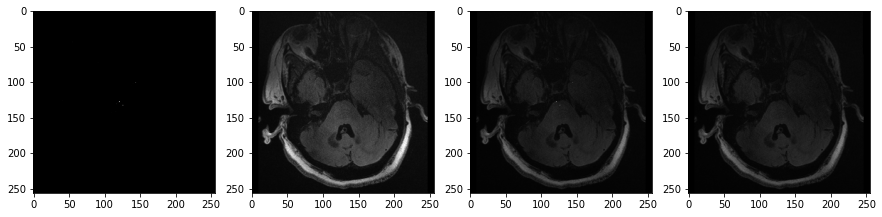

Val:  56%|██████▏    | 18/32 [00:02<00:01, 10.11it/s, acc=75.7966%, loss=0.3208]

<Figure size 432x288 with 0 Axes>

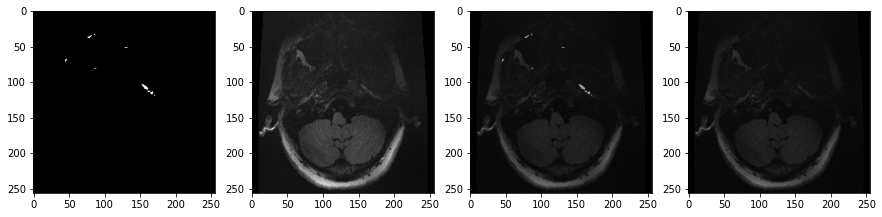

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 10.78it/s, acc=75.2202%, loss=0.3312]

<Figure size 432x288 with 0 Axes>

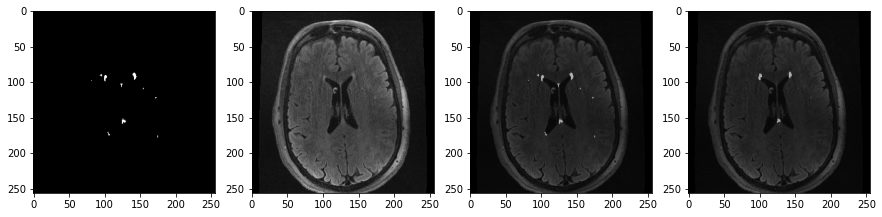

Train:   1%| | 1/157 [00:00<00:30,  5.07it/s, acc=86.9085%, loss=0.1511, lr=0.00

Val Acc 75.2540%	 Val Loss 0.3306


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=79.1400%, loss=0.2646]


Epoch 7/100: 
Train Acc 86.6231%	 Train Loss 0.1556	 Learning Rate 0.0001


<Figure size 432x288 with 0 Axes>

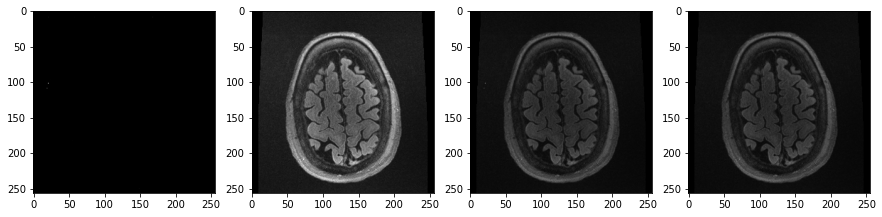

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.02it/s, acc=75.9865%, loss=0.3175]

<Figure size 432x288 with 0 Axes>

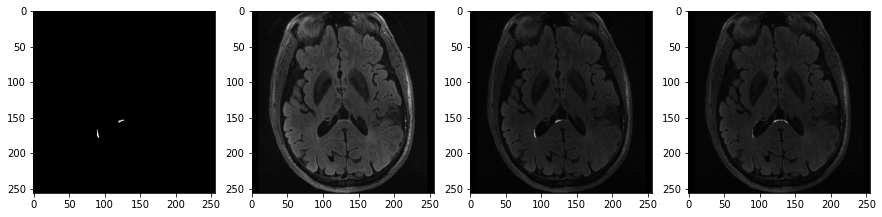

Val:  56%|██████▏    | 18/32 [00:02<00:01, 10.23it/s, acc=76.4331%, loss=0.3101]

<Figure size 432x288 with 0 Axes>

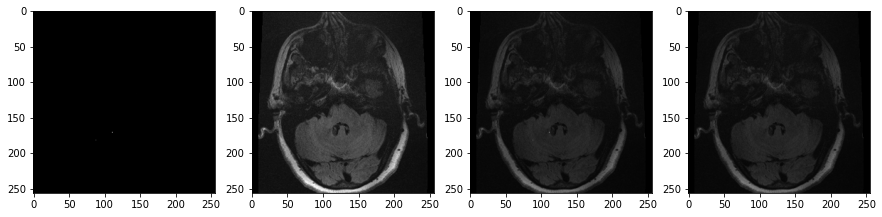

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 10.92it/s, acc=77.1992%, loss=0.2972]

<Figure size 432x288 with 0 Axes>

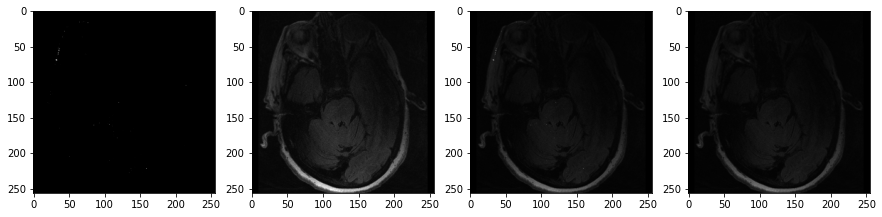

Val Acc 77.0493%	 Val Loss 0.2998
Saving model


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=76.1159%, loss=0.3139]


Epoch 8/100: 
Train Acc 86.6981%	 Train Loss 0.1545	 Learning Rate 0.0001


<Figure size 432x288 with 0 Axes>

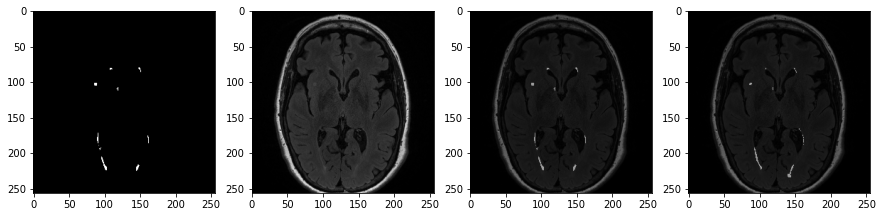

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.96it/s, acc=76.3817%, loss=0.3106]

<Figure size 432x288 with 0 Axes>

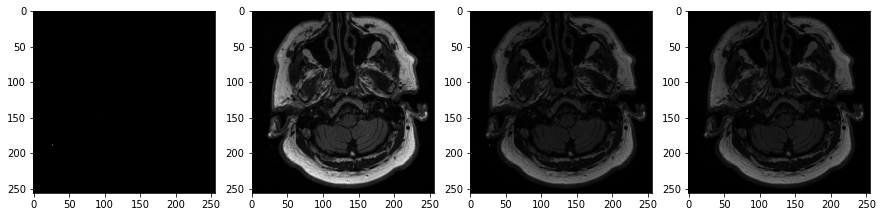

Val:  56%|██████▏    | 18/32 [00:02<00:01, 10.30it/s, acc=76.5055%, loss=0.3088]

<Figure size 432x288 with 0 Axes>

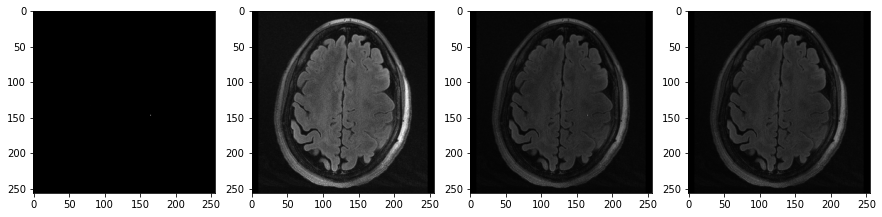

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.43it/s, acc=76.6735%, loss=0.3061]

<Figure size 432x288 with 0 Axes>

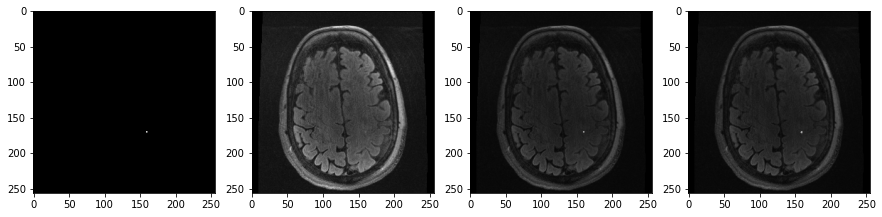

Train:   0%|      | 0/157 [00:00<?, ?it/s, acc=87.6049%, loss=0.1419, lr=0.0001]

Val Acc 76.9996%	 Val Loss 0.3007


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=78.0681%, loss=0.2812]


Epoch 9/100: 
Train Acc 87.3264%	 Train Loss 0.1461	 Learning Rate 0.0001


<Figure size 432x288 with 0 Axes>

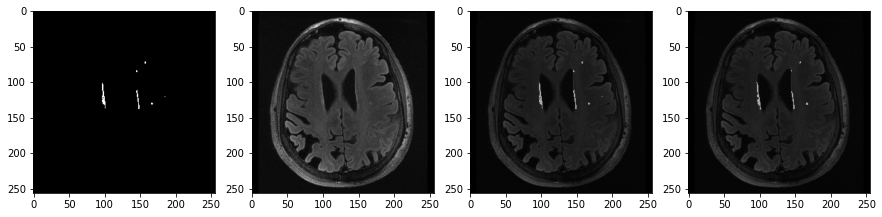

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.96it/s, acc=77.5058%, loss=0.2917]

<Figure size 432x288 with 0 Axes>

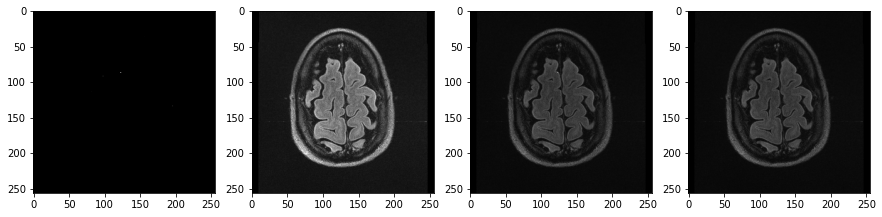

Val:  56%|██████▏    | 18/32 [00:02<00:01, 10.29it/s, acc=77.2533%, loss=0.2964]

<Figure size 432x288 with 0 Axes>

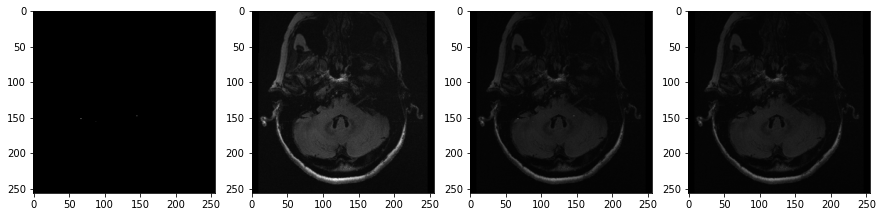

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.47it/s, acc=77.0968%, loss=0.2987]

<Figure size 432x288 with 0 Axes>

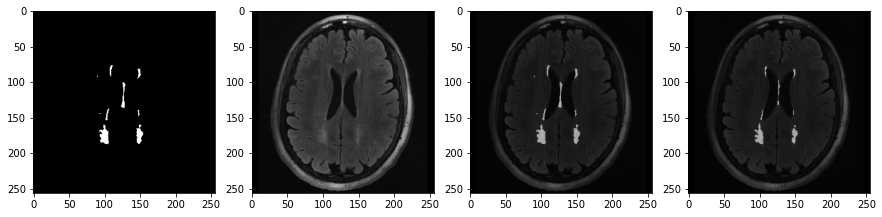

Val Acc 77.1295%	 Val Loss 0.2983
Saving model


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=75.9807%, loss=0.3164]


Epoch 10/100: 
Train Acc 87.6915%	 Train Loss 0.1414	 Learning Rate 0.0001


<Figure size 432x288 with 0 Axes>

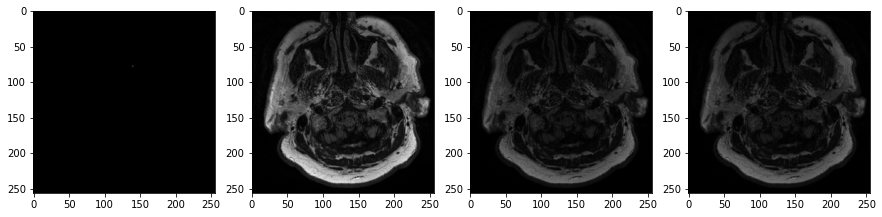

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.92it/s, acc=76.5202%, loss=0.3082]

<Figure size 432x288 with 0 Axes>

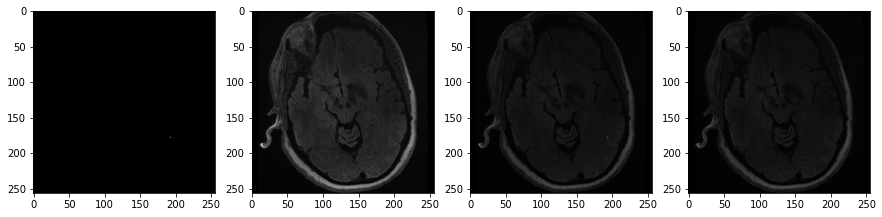

Val:  56%|██████▏    | 18/32 [00:02<00:01, 10.14it/s, acc=76.7959%, loss=0.3037]

<Figure size 432x288 with 0 Axes>

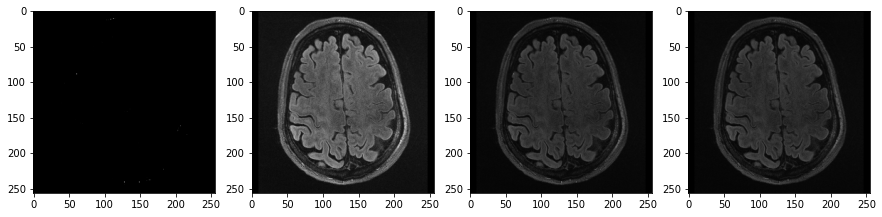

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 11.37it/s, acc=76.7973%, loss=0.3037]

<Figure size 432x288 with 0 Axes>

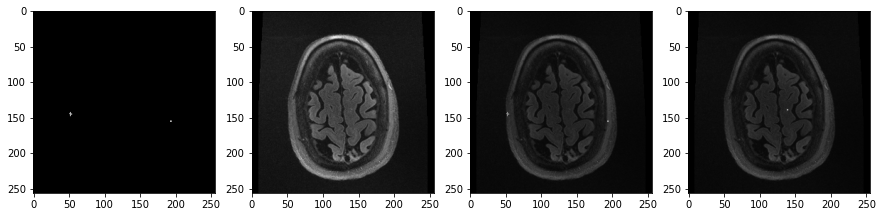

Train:   1%| | 1/157 [00:00<00:30,  5.07it/s, acc=89.6399%, loss=0.1155, lr=0.00

Val Acc 76.5672%	 Val Loss 0.3075


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=69.1778%, loss=0.4465]


Epoch 11/100: 
Train Acc 87.8404%	 Train Loss 0.1394	 Learning Rate 0.0001


<Figure size 432x288 with 0 Axes>

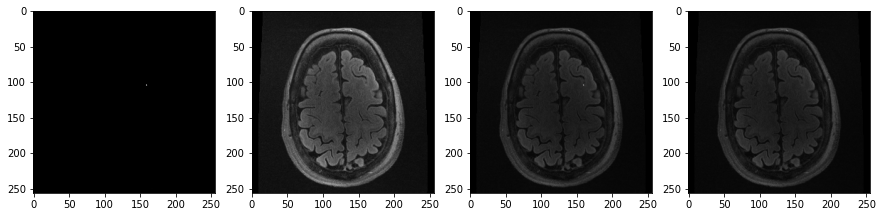

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.91it/s, acc=74.7009%, loss=0.3402]

<Figure size 432x288 with 0 Axes>

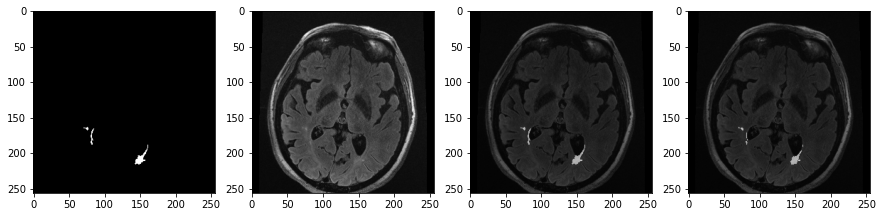

Val:  56%|██████▏    | 18/32 [00:02<00:01, 10.17it/s, acc=75.8472%, loss=0.3211]

<Figure size 432x288 with 0 Axes>

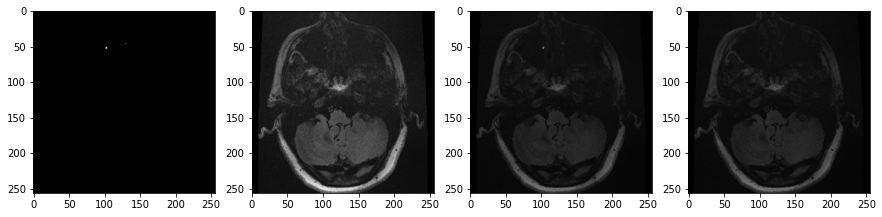

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 11.55it/s, acc=75.9148%, loss=0.3199]

<Figure size 432x288 with 0 Axes>

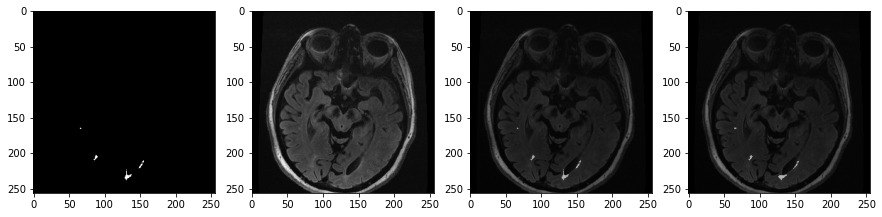

Train:   1%| | 1/157 [00:00<00:30,  5.04it/s, acc=87.6853%, loss=0.1411, lr=0.00

Val Acc 76.1948%	 Val Loss 0.3153


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=79.7217%, loss=0.2555]


Epoch 12/100: 
Train Acc 87.8818%	 Train Loss 0.1389	 Learning Rate 0.0001


<Figure size 432x288 with 0 Axes>

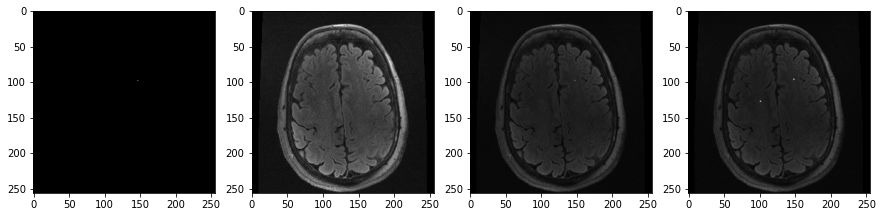

Val:  28%|███▍        | 9/32 [00:01<00:02,  8.26it/s, acc=76.6669%, loss=0.3069]

<Figure size 432x288 with 0 Axes>

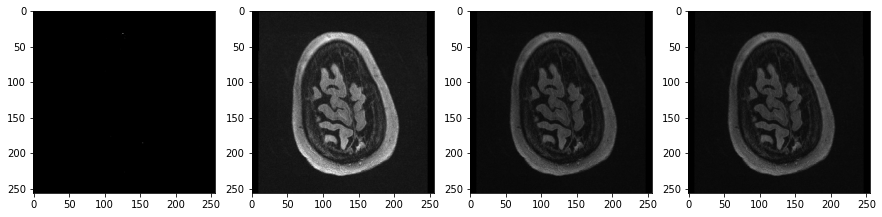

Val:  59%|██████▌    | 19/32 [00:02<00:01, 10.87it/s, acc=75.9653%, loss=0.3196]

<Figure size 432x288 with 0 Axes>

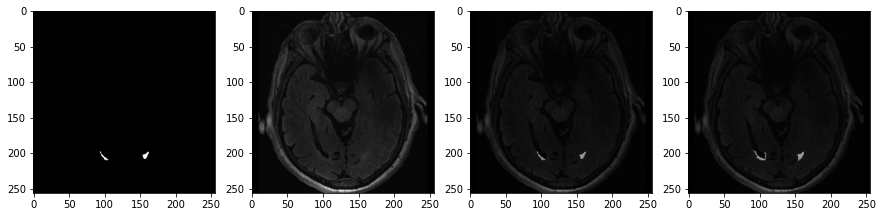

Val:  84%|█████████▎ | 27/32 [00:03<00:00, 10.79it/s, acc=76.0915%, loss=0.3175]

<Figure size 432x288 with 0 Axes>

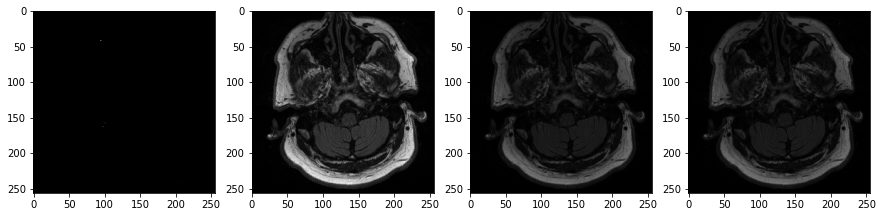

Train:   1%| | 1/157 [00:00<00:30,  5.12it/s, acc=87.2419%, loss=0.1462, lr=0.00

Val Acc 76.2473%	 Val Loss 0.3150


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=74.5943%, loss=0.3395]


Epoch 13/100: 
Train Acc 88.2450%	 Train Loss 0.1341	 Learning Rate 0.0001


<Figure size 432x288 with 0 Axes>

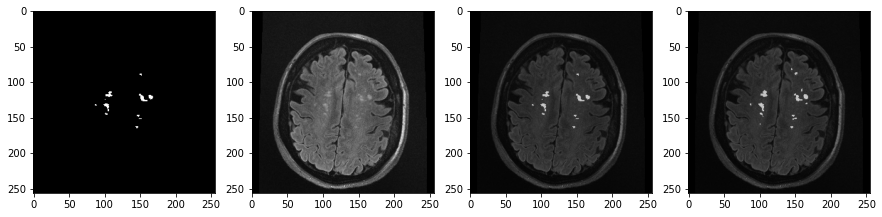

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.87it/s, acc=76.2705%, loss=0.3119]

<Figure size 432x288 with 0 Axes>

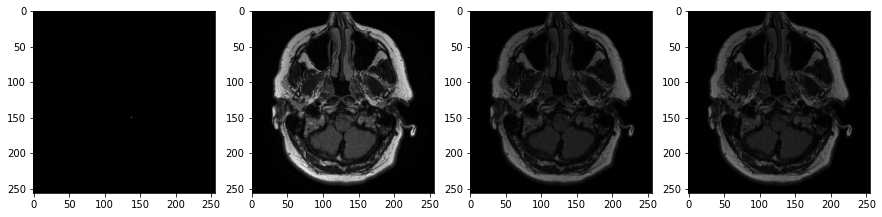

Val:  56%|██████▏    | 18/32 [00:02<00:01, 10.12it/s, acc=76.3247%, loss=0.3123]

<Figure size 432x288 with 0 Axes>

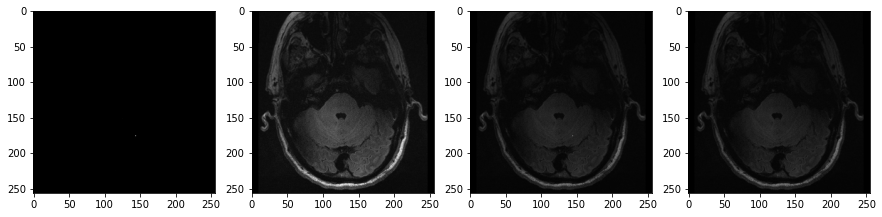

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 11.01it/s, acc=76.6687%, loss=0.3072]

<Figure size 432x288 with 0 Axes>

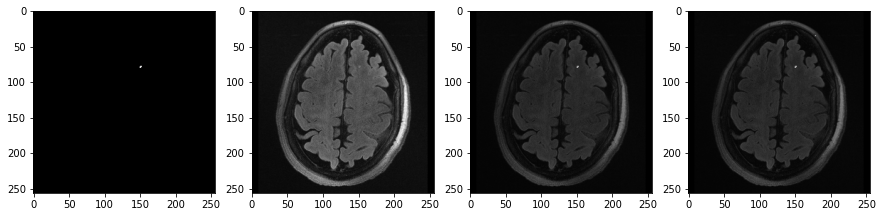

Train:   1%| | 1/157 [00:00<00:30,  5.10it/s, acc=87.5528%, loss=0.1437, lr=0.00

Val Acc 76.7386%	 Val Loss 0.3058


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=75.0896%, loss=0.3341]


Epoch 14/100: 
Train Acc 88.7893%	 Train Loss 0.1274	 Learning Rate 0.0001


<Figure size 432x288 with 0 Axes>

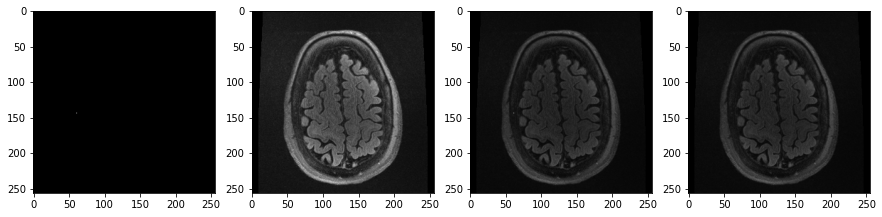

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.37it/s, acc=77.2727%, loss=0.2964]

<Figure size 432x288 with 0 Axes>

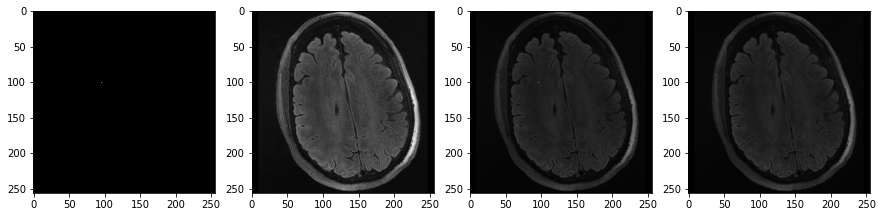

Val:  56%|██████▏    | 18/32 [00:02<00:01,  9.95it/s, acc=76.0431%, loss=0.3181]

<Figure size 432x288 with 0 Axes>

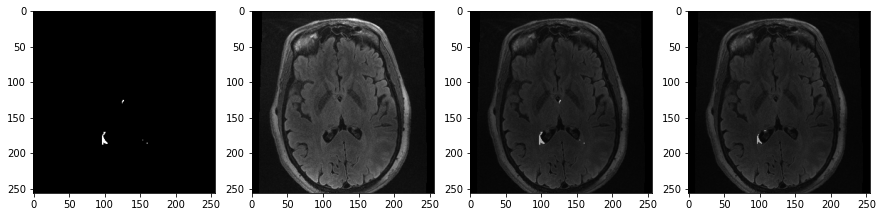

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 11.51it/s, acc=75.9164%, loss=0.3201]

<Figure size 432x288 with 0 Axes>

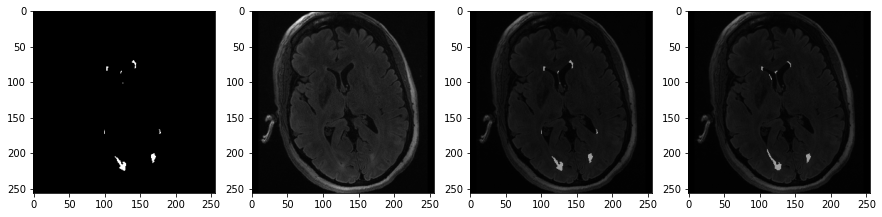

Train:   1%| | 1/157 [00:00<00:30,  5.11it/s, acc=85.9213%, loss=0.1646, lr=0.00

Val Acc 76.2193%	 Val Loss 0.3149


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=74.4125%, loss=0.3453]


Epoch 15/100: 
Train Acc 88.8908%	 Train Loss 0.1260	 Learning Rate 0.0001


<Figure size 432x288 with 0 Axes>

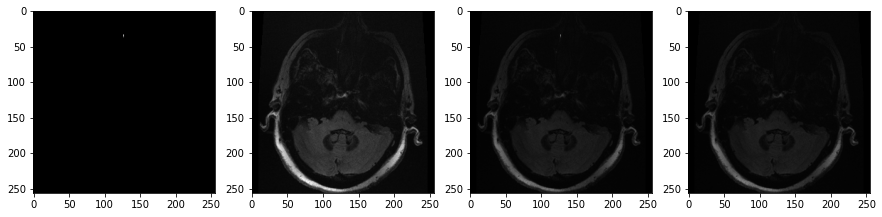

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.82it/s, acc=77.9628%, loss=0.2841]

<Figure size 432x288 with 0 Axes>

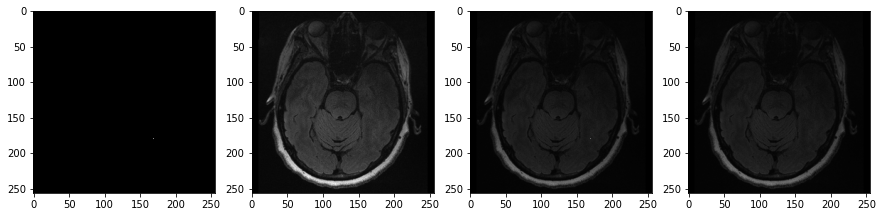

Val:  56%|██████▏    | 18/32 [00:02<00:01, 10.14it/s, acc=76.7010%, loss=0.3061]

<Figure size 432x288 with 0 Axes>

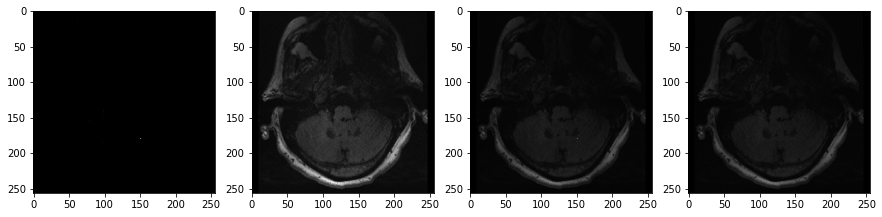

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 11.48it/s, acc=77.0417%, loss=0.2999]

<Figure size 432x288 with 0 Axes>

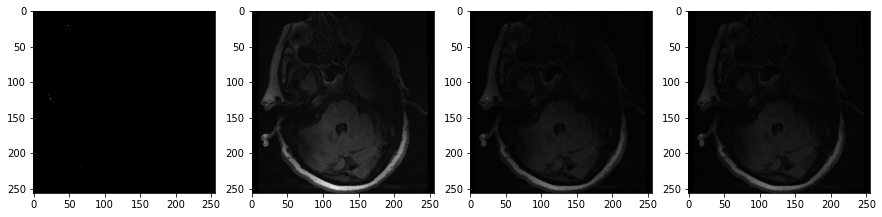

Train:   1%| | 1/157 [00:00<00:30,  5.08it/s, acc=88.5960%, loss=0.1290, lr=0.00

Val Acc 76.8335%	 Val Loss 0.3033


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=81.2066%, loss=0.2322]


Epoch 16/100: 
Train Acc 89.7268%	 Train Loss 0.1153	 Learning Rate 0.0001


<Figure size 432x288 with 0 Axes>

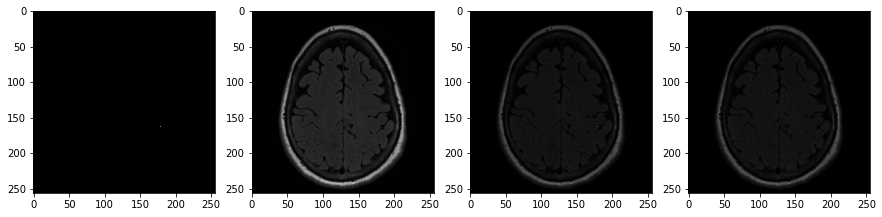

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.95it/s, acc=79.2192%, loss=0.2660]

<Figure size 432x288 with 0 Axes>

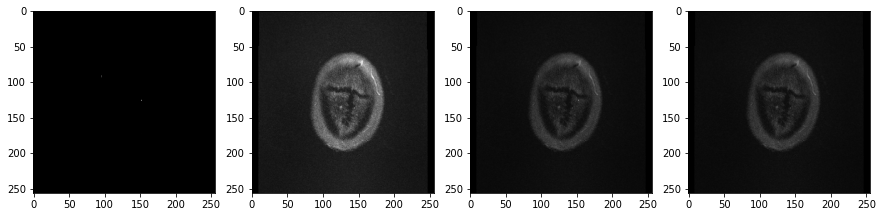

Val:  56%|██████▏    | 18/32 [00:02<00:01, 10.12it/s, acc=77.7373%, loss=0.2895]

<Figure size 432x288 with 0 Axes>

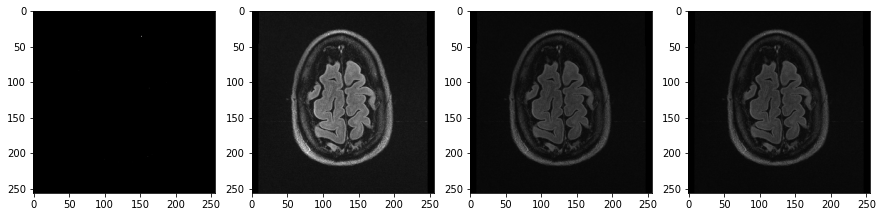

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 11.44it/s, acc=77.5573%, loss=0.2917]

<Figure size 432x288 with 0 Axes>

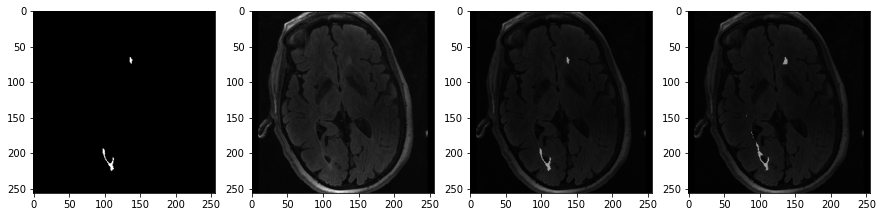

Val Acc 77.4443%	 Val Loss 0.2935
Saving model


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=74.5588%, loss=0.3403]


Epoch 17/100: 
Train Acc 90.1227%	 Train Loss 0.1106	 Learning Rate 0.0001


<Figure size 432x288 with 0 Axes>

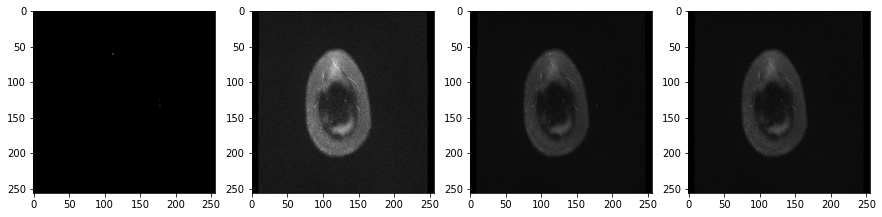

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.84it/s, acc=78.1611%, loss=0.2811]

<Figure size 432x288 with 0 Axes>

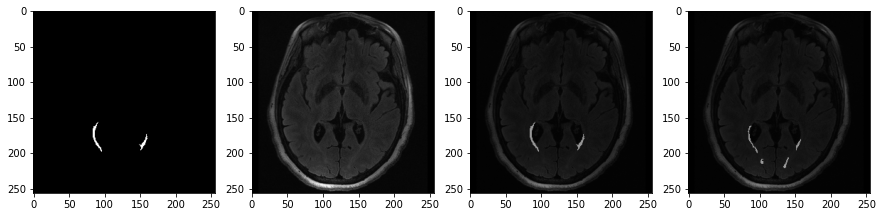

Val:  56%|██████▏    | 18/32 [00:02<00:01, 10.25it/s, acc=77.8462%, loss=0.2865]

<Figure size 432x288 with 0 Axes>

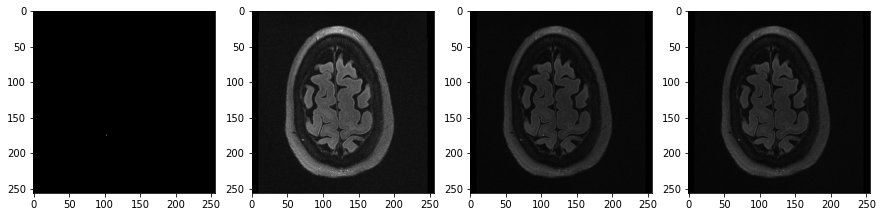

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 10.98it/s, acc=77.2480%, loss=0.2969]

<Figure size 432x288 with 0 Axes>

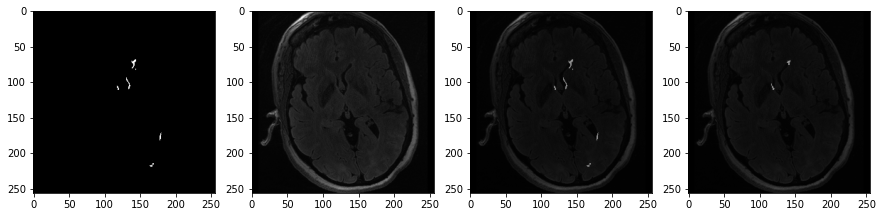

Train:   0%|      | 0/157 [00:00<?, ?it/s, acc=91.1650%, loss=0.0977, lr=0.0001]

Val Acc 77.2669%	 Val Loss 0.2963


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=78.5870%, loss=0.2721]


Epoch 18/100: 
Train Acc 90.2739%	 Train Loss 0.1086	 Learning Rate 0.0001


<Figure size 432x288 with 0 Axes>

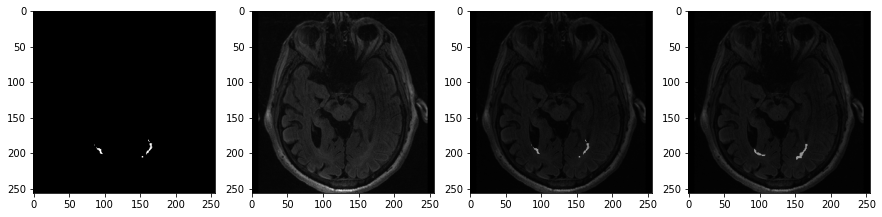

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.95it/s, acc=77.3312%, loss=0.2946]

<Figure size 432x288 with 0 Axes>

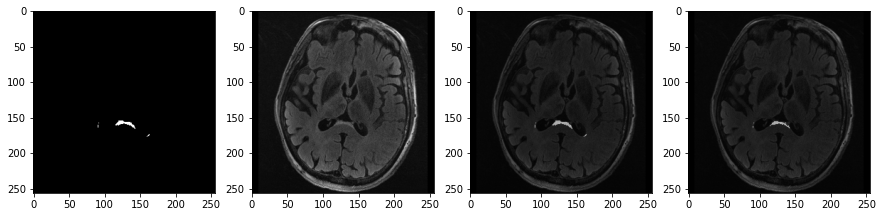

Val:  56%|██████▏    | 18/32 [00:02<00:01, 10.17it/s, acc=77.3928%, loss=0.2940]

<Figure size 432x288 with 0 Axes>

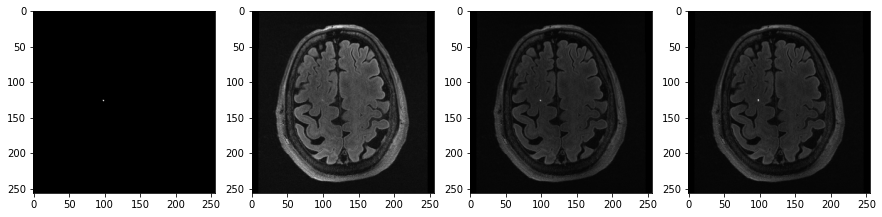

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 11.43it/s, acc=77.1356%, loss=0.2985]

<Figure size 432x288 with 0 Axes>

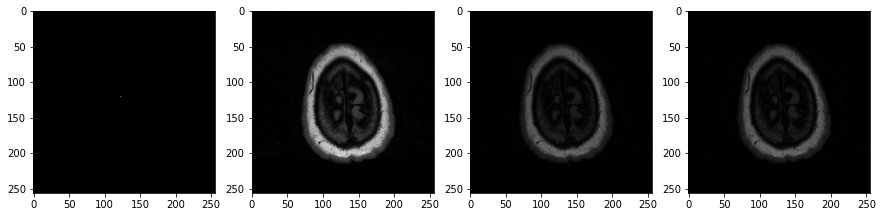

Train:   1%| | 1/157 [00:00<00:30,  5.08it/s, acc=89.5891%, loss=0.1169, lr=0.00

Val Acc 77.3346%	 Val Loss 0.2953


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=79.2129%, loss=0.2604]


Epoch 19/100: 
Train Acc 90.5235%	 Train Loss 0.1055	 Learning Rate 0.0001


<Figure size 432x288 with 0 Axes>

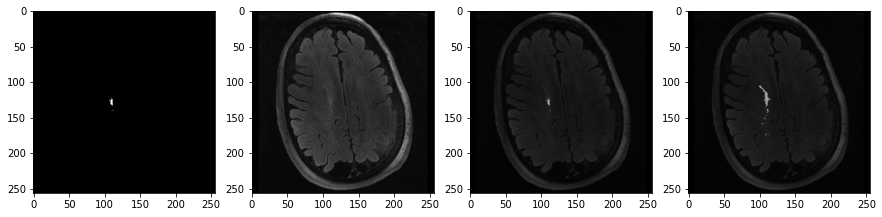

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.82it/s, acc=76.2793%, loss=0.3122]

<Figure size 432x288 with 0 Axes>

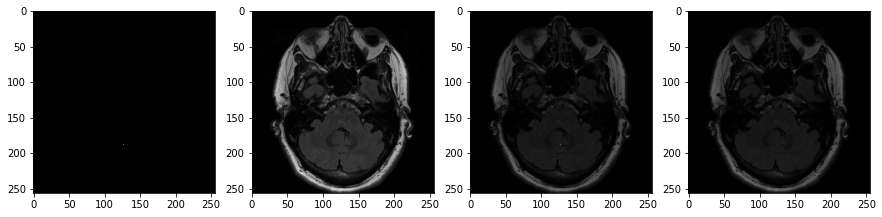

Val:  56%|██████▏    | 18/32 [00:02<00:01, 10.26it/s, acc=76.7785%, loss=0.3037]

<Figure size 432x288 with 0 Axes>

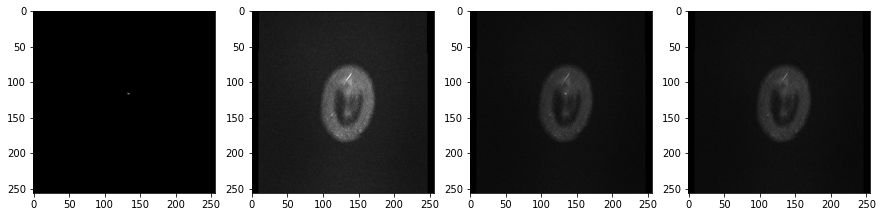

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 11.41it/s, acc=77.1707%, loss=0.2974]

<Figure size 432x288 with 0 Axes>

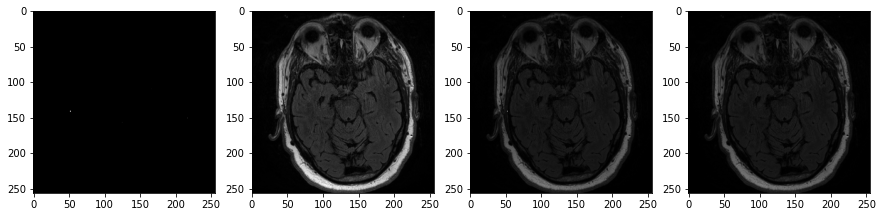

Train:   0%|      | 0/157 [00:00<?, ?it/s, acc=90.7968%, loss=0.1014, lr=0.0000]

Val Acc 77.0010%	 Val Loss 0.3002


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=75.8899%, loss=0.3192]


Epoch 20/100: 
Train Acc 90.8625%	 Train Loss 0.1015	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

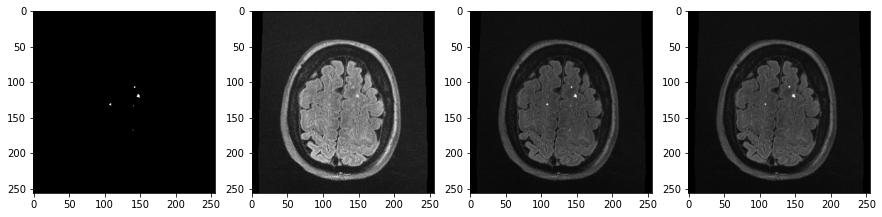

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.90it/s, acc=76.3829%, loss=0.3099]

<Figure size 432x288 with 0 Axes>

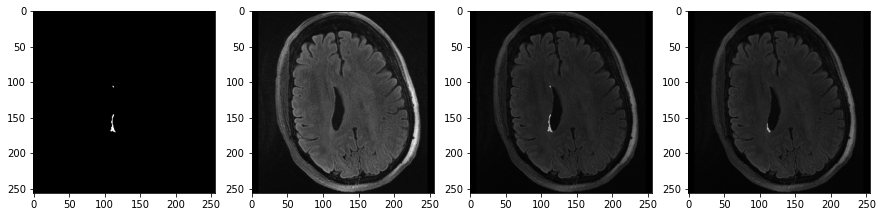

Val:  56%|██████▏    | 18/32 [00:02<00:01, 10.17it/s, acc=76.6689%, loss=0.3055]

<Figure size 432x288 with 0 Axes>

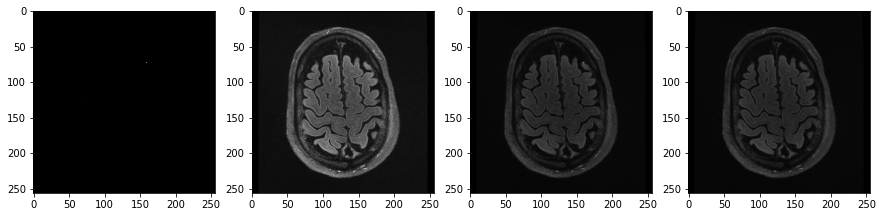

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 11.42it/s, acc=76.9561%, loss=0.3013]

<Figure size 432x288 with 0 Axes>

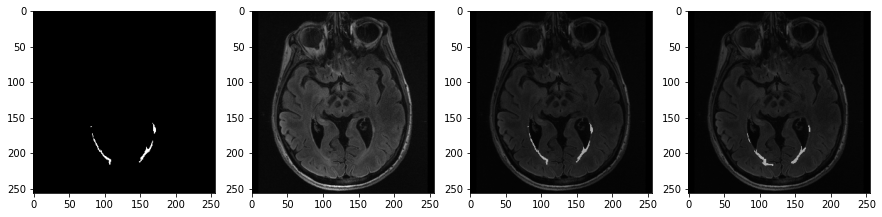

Train:   1%| | 1/157 [00:00<00:30,  5.08it/s, acc=91.5982%, loss=0.0916, lr=0.00

Val Acc 77.1461%	 Val Loss 0.2980


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=80.4355%, loss=0.2434]


Epoch 21/100: 
Train Acc 91.1121%	 Train Loss 0.0984	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

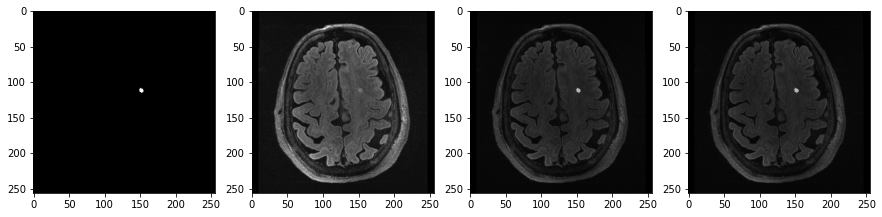

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.86it/s, acc=77.5311%, loss=0.2915]

<Figure size 432x288 with 0 Axes>

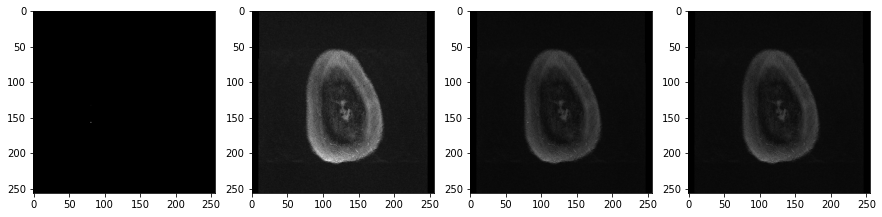

Val:  56%|██████▏    | 18/32 [00:02<00:01, 10.16it/s, acc=77.2980%, loss=0.2951]

<Figure size 432x288 with 0 Axes>

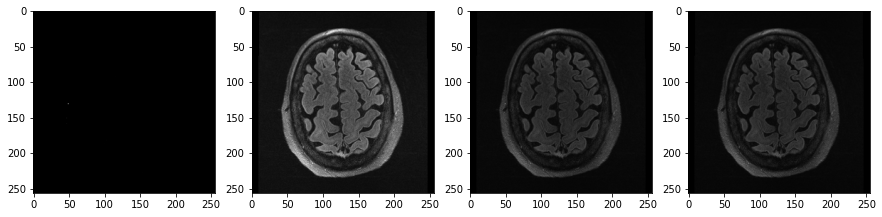

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 11.44it/s, acc=77.2598%, loss=0.2958]

<Figure size 432x288 with 0 Axes>

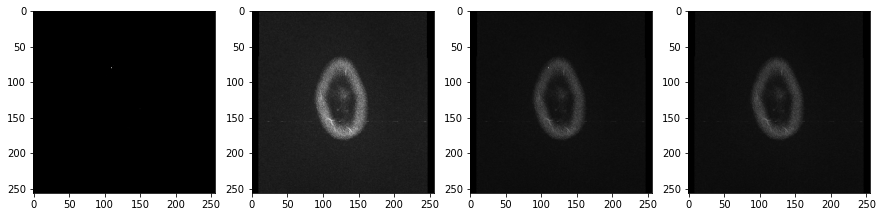

Train:   1%| | 1/157 [00:00<00:30,  5.08it/s, acc=91.1492%, loss=0.0974, lr=0.00

Val Acc 77.1960%	 Val Loss 0.2968


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=79.9143%, loss=0.2516]


Epoch 22/100: 
Train Acc 91.2002%	 Train Loss 0.0974	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

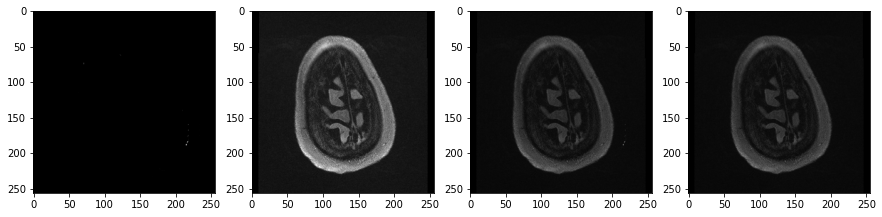

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.92it/s, acc=77.4084%, loss=0.2941]

<Figure size 432x288 with 0 Axes>

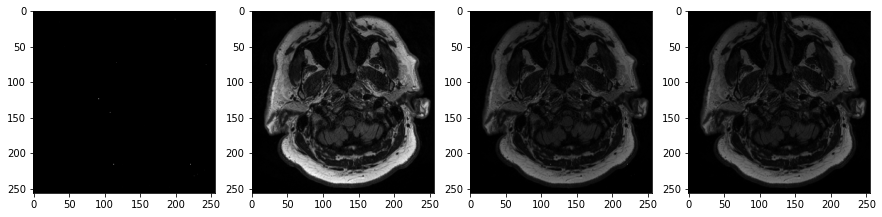

Val:  56%|██████▏    | 18/32 [00:02<00:01,  9.93it/s, acc=76.2724%, loss=0.3148]

<Figure size 432x288 with 0 Axes>

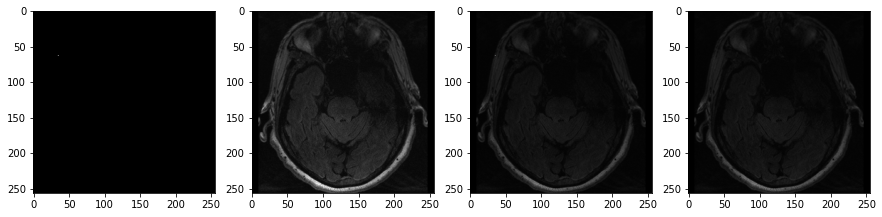

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 11.22it/s, acc=76.5236%, loss=0.3097]

<Figure size 432x288 with 0 Axes>

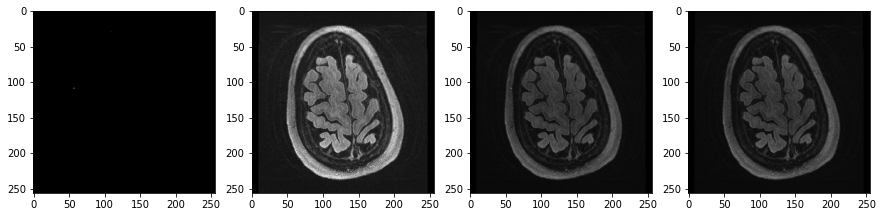

Train:   1%| | 1/157 [00:00<00:30,  5.07it/s, acc=91.6765%, loss=0.0911, lr=0.00

Val Acc 77.0097%	 Val Loss 0.3014


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=79.7649%, loss=0.2530]


Epoch 23/100: 
Train Acc 91.4417%	 Train Loss 0.0944	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

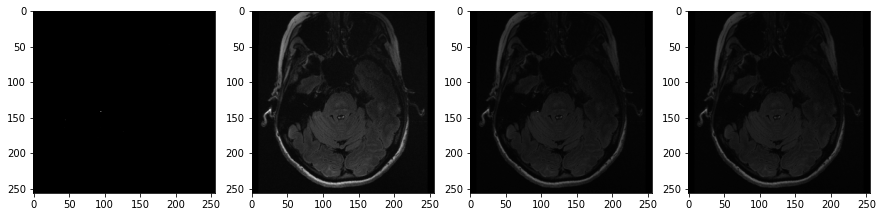

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.94it/s, acc=76.3870%, loss=0.3122]

<Figure size 432x288 with 0 Axes>

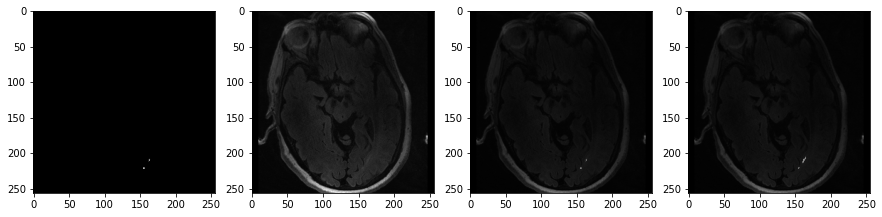

Val:  56%|██████▏    | 18/32 [00:02<00:01, 10.18it/s, acc=77.3935%, loss=0.2941]

<Figure size 432x288 with 0 Axes>

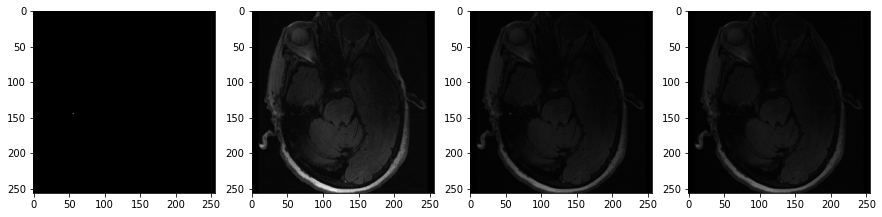

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 11.39it/s, acc=77.1892%, loss=0.2977]

<Figure size 432x288 with 0 Axes>

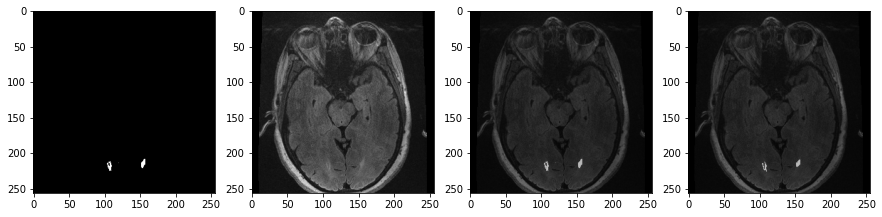

Train:   1%| | 1/157 [00:00<00:30,  5.07it/s, acc=92.0550%, loss=0.0864, lr=0.00

Val Acc 77.1747%	 Val Loss 0.2981


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=78.4238%, loss=0.2753]


Epoch 24/100: 
Train Acc 91.6625%	 Train Loss 0.0919	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

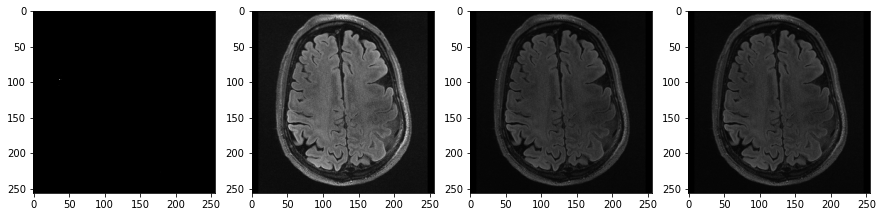

Val:  28%|███▍        | 9/32 [00:01<00:02,  8.22it/s, acc=76.3235%, loss=0.3131]

<Figure size 432x288 with 0 Axes>

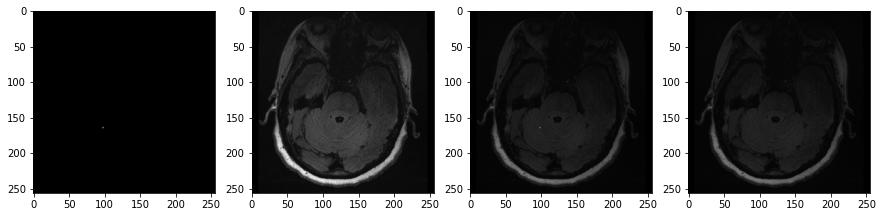

Val:  59%|██████▌    | 19/32 [00:02<00:01, 10.93it/s, acc=76.3662%, loss=0.3122]

<Figure size 432x288 with 0 Axes>

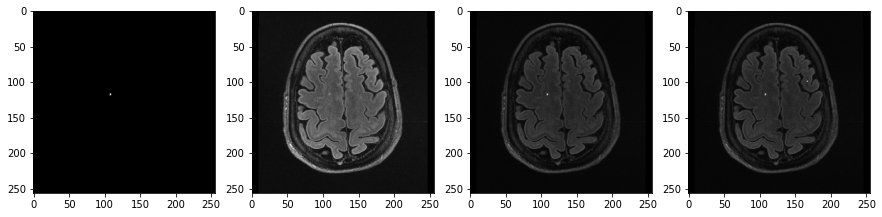

Val:  84%|█████████▎ | 27/32 [00:03<00:00, 10.16it/s, acc=76.6873%, loss=0.3061]

<Figure size 432x288 with 0 Axes>

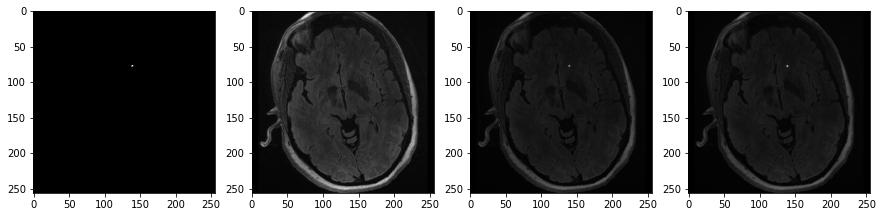

Train:   1%| | 1/157 [00:00<00:30,  5.09it/s, acc=88.5142%, loss=0.1291, lr=0.00

Val Acc 76.8786%	 Val Loss 0.3029


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=71.1533%, loss=0.4063]


Epoch 25/100: 
Train Acc 91.8884%	 Train Loss 0.0891	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

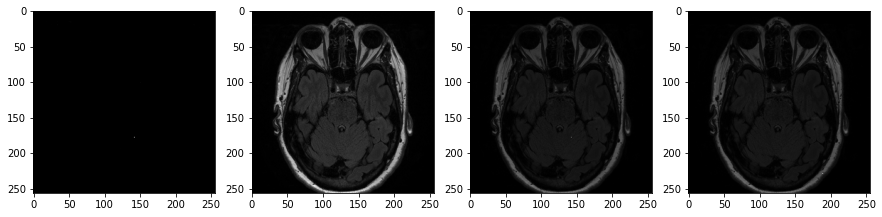

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.75it/s, acc=76.8298%, loss=0.3041]

<Figure size 432x288 with 0 Axes>

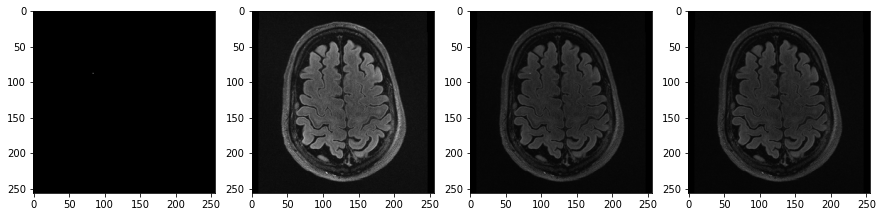

Val:  56%|██████▏    | 18/32 [00:02<00:01,  9.82it/s, acc=77.2278%, loss=0.2967]

<Figure size 432x288 with 0 Axes>

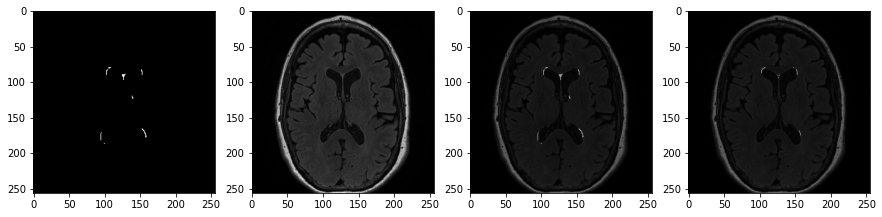

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 11.38it/s, acc=77.1769%, loss=0.2972]

<Figure size 432x288 with 0 Axes>

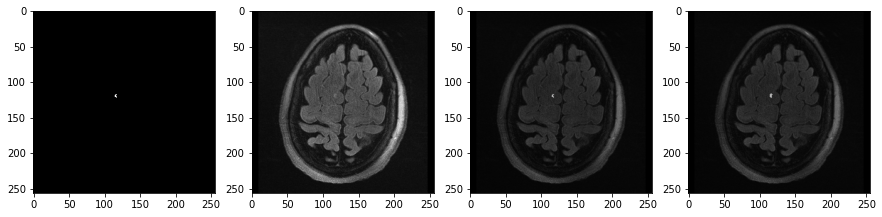

Train:   1%| | 1/157 [00:00<00:30,  5.12it/s, acc=93.1163%, loss=0.0748, lr=0.00

Val Acc 76.8893%	 Val Loss 0.3019


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=79.3758%, loss=0.2590]


Epoch 26/100: 
Train Acc 92.0417%	 Train Loss 0.0873	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

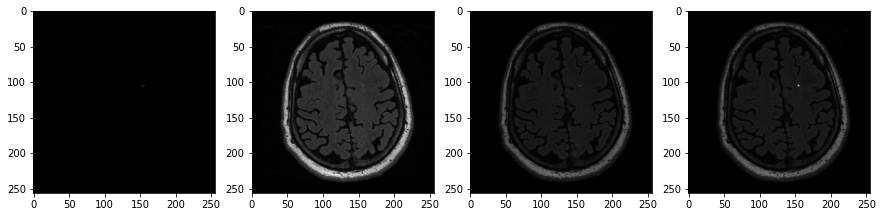

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.88it/s, acc=77.2048%, loss=0.2957]

<Figure size 432x288 with 0 Axes>

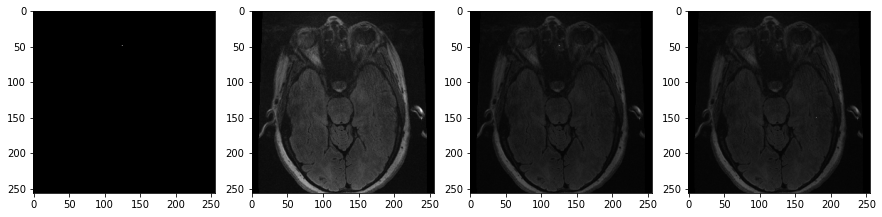

Val:  56%|██████▏    | 18/32 [00:02<00:01, 10.14it/s, acc=76.7177%, loss=0.3039]

<Figure size 432x288 with 0 Axes>

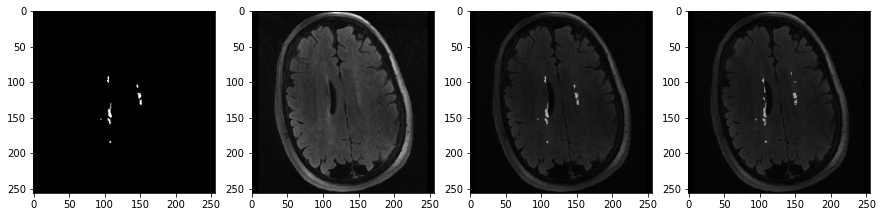

Val:  84%|█████████▎ | 27/32 [00:03<00:00, 10.88it/s, acc=77.2833%, loss=0.2946]

<Figure size 432x288 with 0 Axes>

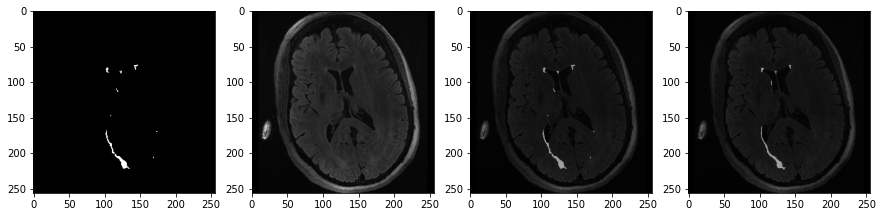

Train:   1%| | 1/157 [00:00<00:30,  5.13it/s, acc=90.9637%, loss=0.1001, lr=0.00

Val Acc 77.2973%	 Val Loss 0.2945


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=78.6669%, loss=0.2716]


Epoch 27/100: 
Train Acc 92.2442%	 Train Loss 0.0850	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

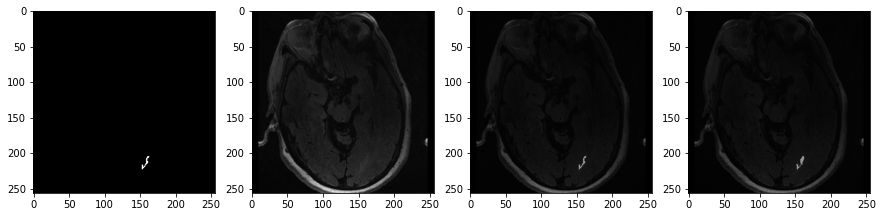

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.12it/s, acc=77.7154%, loss=0.2874]

<Figure size 432x288 with 0 Axes>

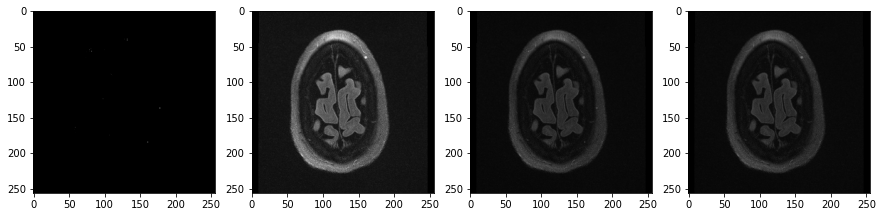

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.52it/s, acc=77.5605%, loss=0.2916]

<Figure size 432x288 with 0 Axes>

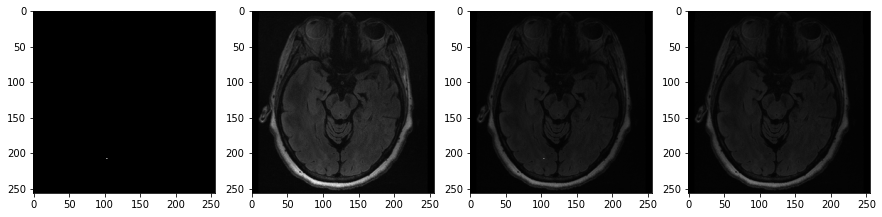

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.46it/s, acc=77.4858%, loss=0.2925]

<Figure size 432x288 with 0 Axes>

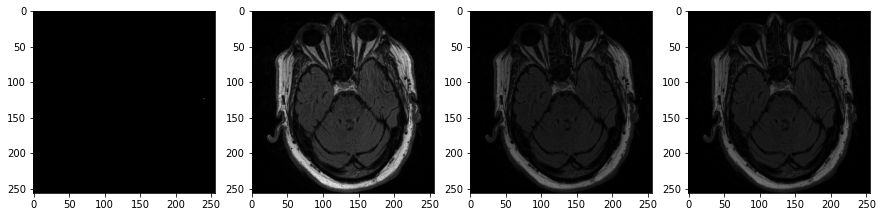

Train:   0%|      | 0/157 [00:00<?, ?it/s, acc=91.7725%, loss=0.0895, lr=0.0000]

Val Acc 77.3290%	 Val Loss 0.2950


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=71.1939%, loss=0.4039]


Epoch 28/100: 
Train Acc 92.3818%	 Train Loss 0.0834	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

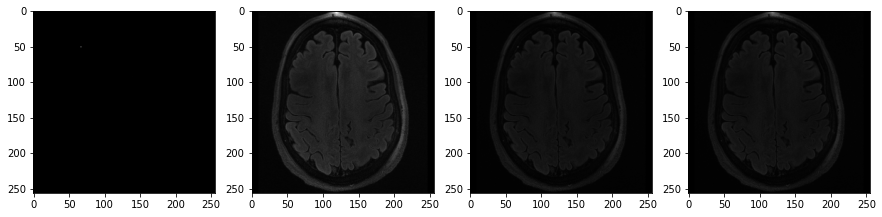

Val:  28%|███▍        | 9/32 [00:01<00:02,  8.50it/s, acc=77.4396%, loss=0.2927]

<Figure size 432x288 with 0 Axes>

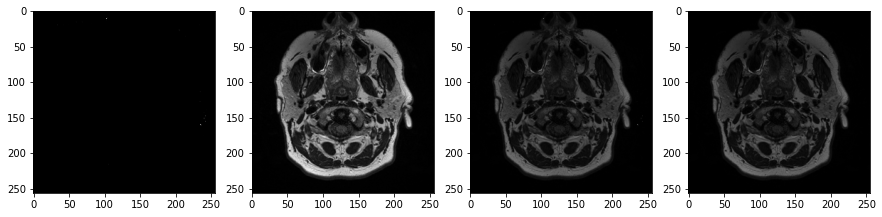

Val:  59%|██████▌    | 19/32 [00:02<00:01, 11.24it/s, acc=77.2454%, loss=0.2959]

<Figure size 432x288 with 0 Axes>

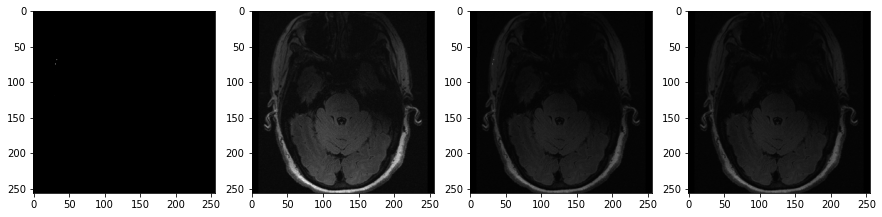

Val:  84%|█████████▎ | 27/32 [00:02<00:00, 11.04it/s, acc=77.2163%, loss=0.2961]

<Figure size 432x288 with 0 Axes>

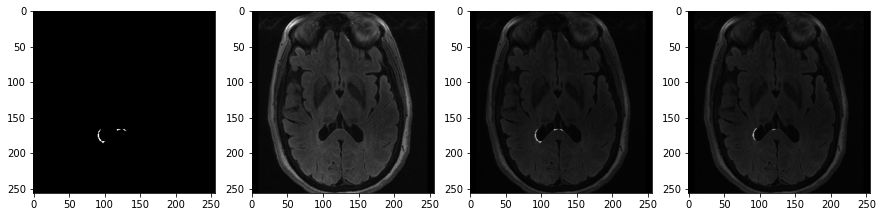

Train:   1%| | 1/157 [00:00<00:30,  5.10it/s, acc=93.9556%, loss=0.0655, lr=0.00

Val Acc 77.4090%	 Val Loss 0.2928


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=73.2274%, loss=0.3641]


Epoch 29/100: 
Train Acc 92.6168%	 Train Loss 0.0808	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

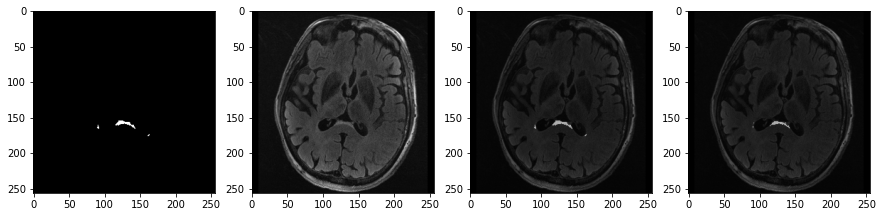

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.00it/s, acc=76.1363%, loss=0.3138]

<Figure size 432x288 with 0 Axes>

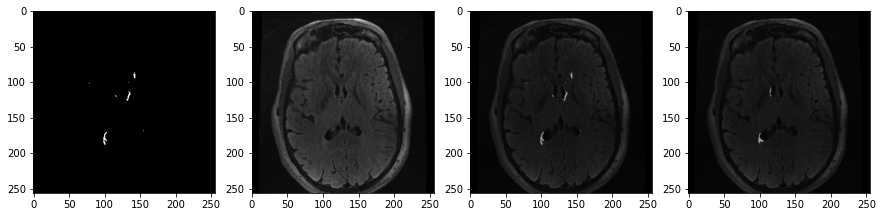

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.40it/s, acc=77.3106%, loss=0.2950]

<Figure size 432x288 with 0 Axes>

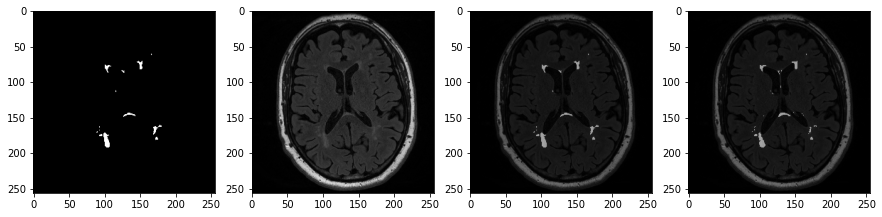

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.54it/s, acc=77.4272%, loss=0.2934]

<Figure size 432x288 with 0 Axes>

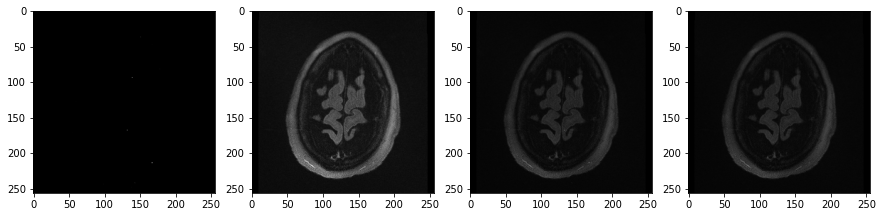

Train:   1%| | 1/157 [00:00<00:30,  5.14it/s, acc=93.2255%, loss=0.0738, lr=0.00

Val Acc 77.2708%	 Val Loss 0.2963


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=75.4260%, loss=0.3256]


Epoch 30/100: 
Train Acc 92.6636%	 Train Loss 0.0801	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

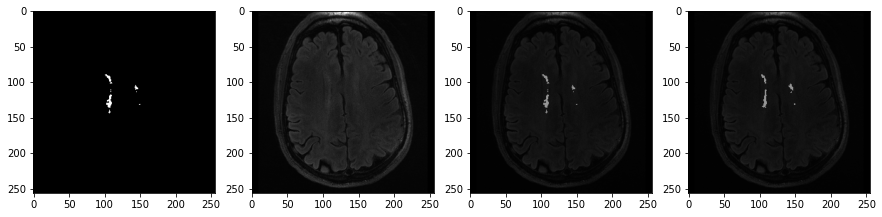

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.97it/s, acc=77.1472%, loss=0.2987]

<Figure size 432x288 with 0 Axes>

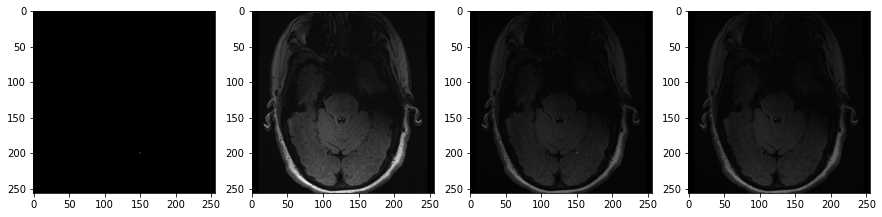

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.46it/s, acc=77.3967%, loss=0.2938]

<Figure size 432x288 with 0 Axes>

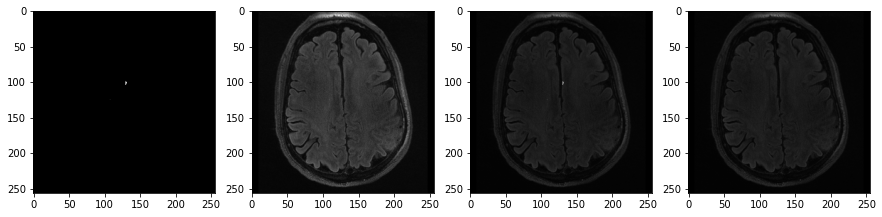

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.68it/s, acc=77.7087%, loss=0.2886]

<Figure size 432x288 with 0 Axes>

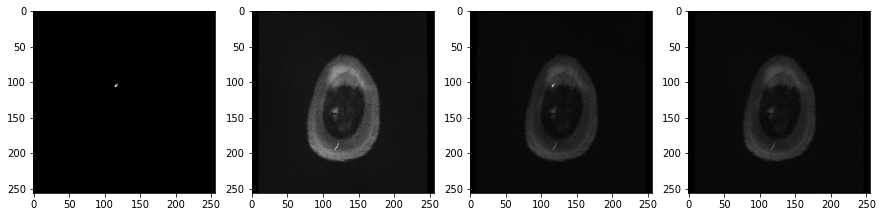

Val Acc 77.7262%	 Val Loss 0.2881
Saving model


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=76.5277%, loss=0.3061]


Epoch 31/100: 
Train Acc 92.2110%	 Train Loss 0.0855	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

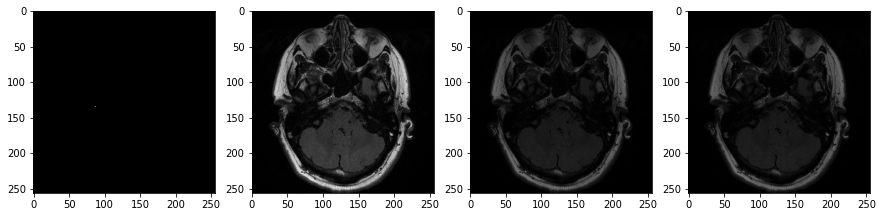

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.04it/s, acc=77.5247%, loss=0.2926]

<Figure size 432x288 with 0 Axes>

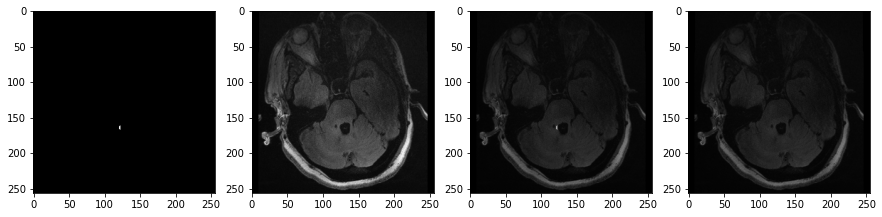

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.36it/s, acc=77.7086%, loss=0.2895]

<Figure size 432x288 with 0 Axes>

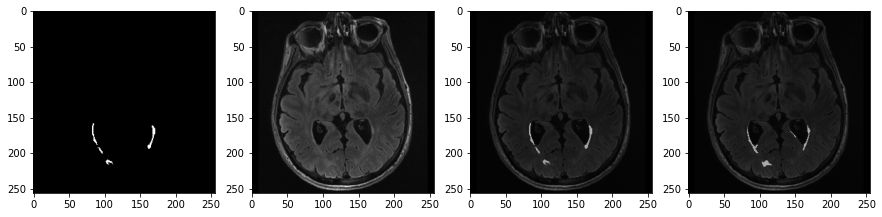

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.73it/s, acc=76.9533%, loss=0.3020]

<Figure size 432x288 with 0 Axes>

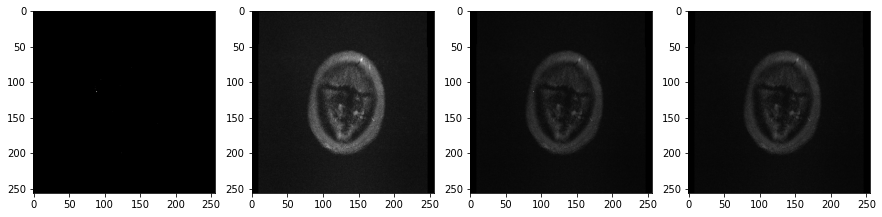

Train:   1%| | 1/157 [00:00<00:30,  5.10it/s, acc=93.2418%, loss=0.0736, lr=0.00

Val Acc 76.5293%	 Val Loss 0.3105


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=74.3720%, loss=0.3441]


Epoch 32/100: 
Train Acc 92.6393%	 Train Loss 0.0804	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

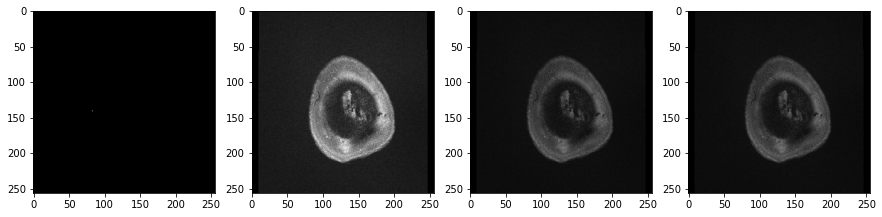

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.17it/s, acc=76.2808%, loss=0.3136]

<Figure size 432x288 with 0 Axes>

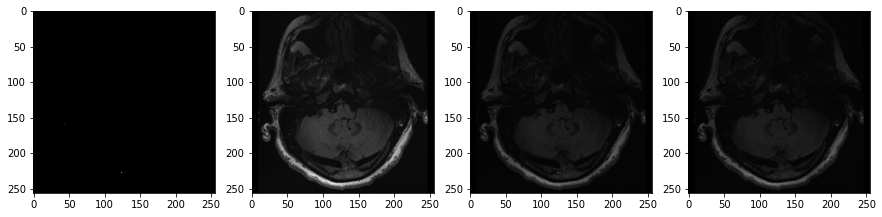

Val:  56%|██████▏    | 18/32 [00:02<00:01,  9.81it/s, acc=76.7221%, loss=0.3061]

<Figure size 432x288 with 0 Axes>

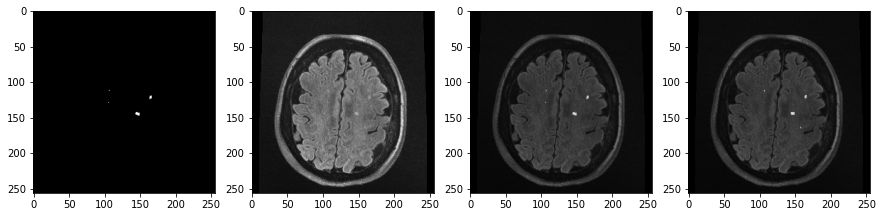

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.57it/s, acc=77.1077%, loss=0.2998]

<Figure size 432x288 with 0 Axes>

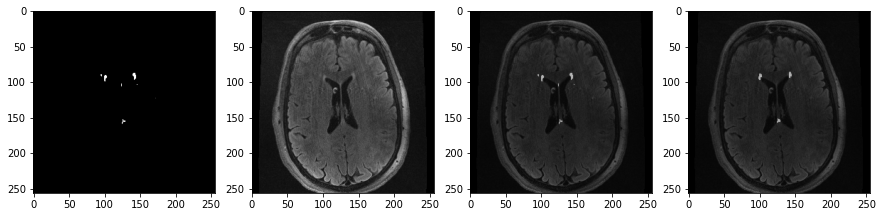

Train:   1%| | 1/157 [00:00<00:30,  5.20it/s, acc=92.0924%, loss=0.0871, lr=0.00

Val Acc 76.9948%	 Val Loss 0.3015


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=70.7931%, loss=0.4099]


Epoch 33/100: 
Train Acc 92.8470%	 Train Loss 0.0780	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

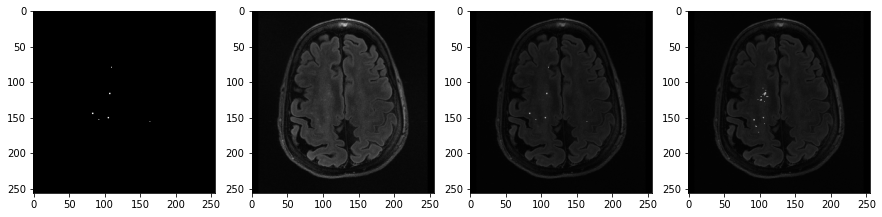

Val:  31%|███▍       | 10/32 [00:01<00:02,  8.38it/s, acc=76.0894%, loss=0.3177]

<Figure size 432x288 with 0 Axes>

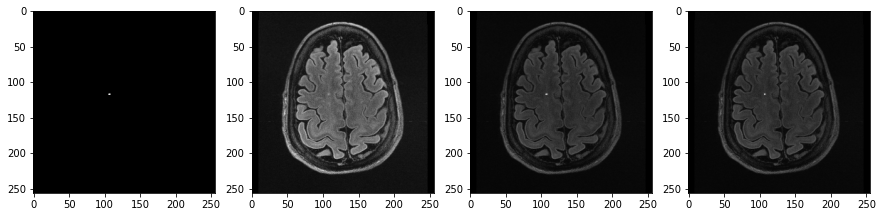

Val:  56%|██████▏    | 18/32 [00:02<00:01, 10.26it/s, acc=75.6841%, loss=0.3239]

<Figure size 432x288 with 0 Axes>

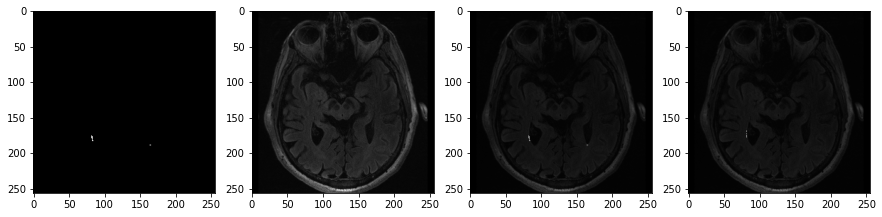

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 11.65it/s, acc=76.8235%, loss=0.3049]

<Figure size 432x288 with 0 Axes>

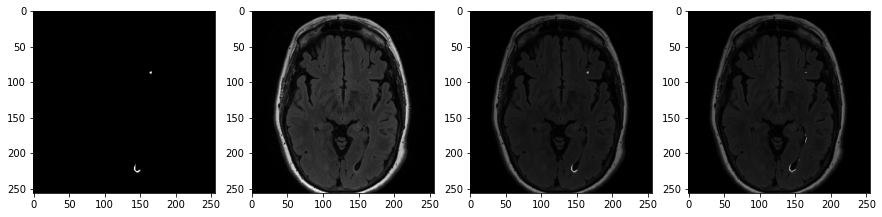

Train:   1%| | 1/157 [00:00<00:30,  5.08it/s, acc=93.4107%, loss=0.0702, lr=0.00

Val Acc 76.8808%	 Val Loss 0.3041


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=76.9323%, loss=0.3010]


Epoch 34/100: 
Train Acc 93.0149%	 Train Loss 0.0760	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

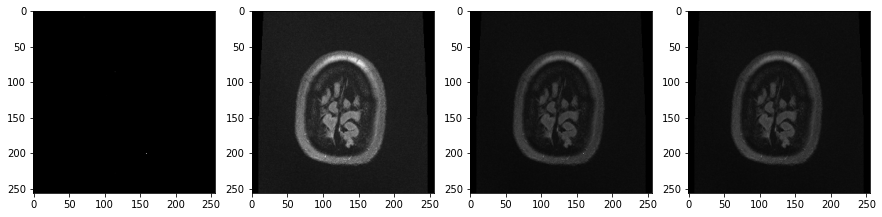

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.16it/s, acc=77.0004%, loss=0.3004]

<Figure size 432x288 with 0 Axes>

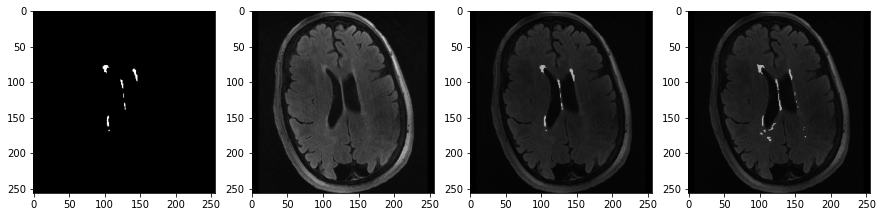

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.48it/s, acc=77.6396%, loss=0.2896]

<Figure size 432x288 with 0 Axes>

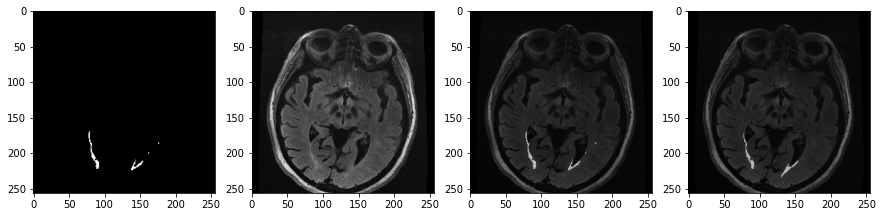

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.58it/s, acc=77.2945%, loss=0.2955]

<Figure size 432x288 with 0 Axes>

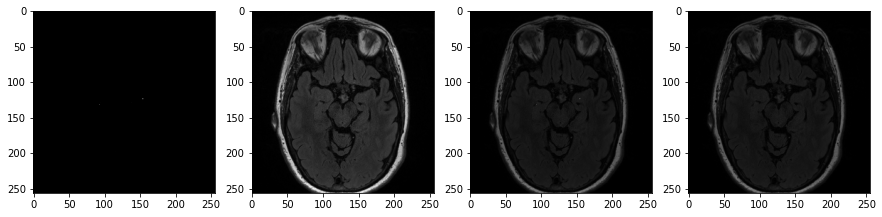

Train:   1%| | 1/157 [00:00<00:30,  5.08it/s, acc=93.2725%, loss=0.0730, lr=0.00

Val Acc 76.9810%	 Val Loss 0.3007


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=76.6879%, loss=0.3039]


Epoch 35/100: 
Train Acc 93.1848%	 Train Loss 0.0740	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

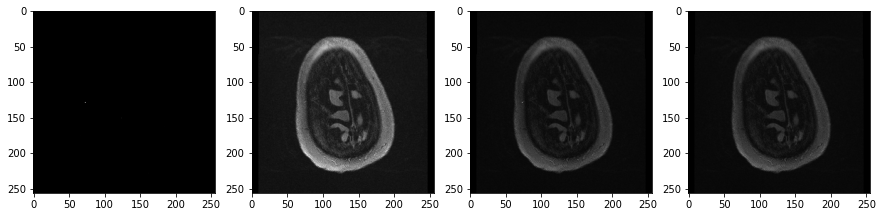

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.16it/s, acc=76.4252%, loss=0.3094]

<Figure size 432x288 with 0 Axes>

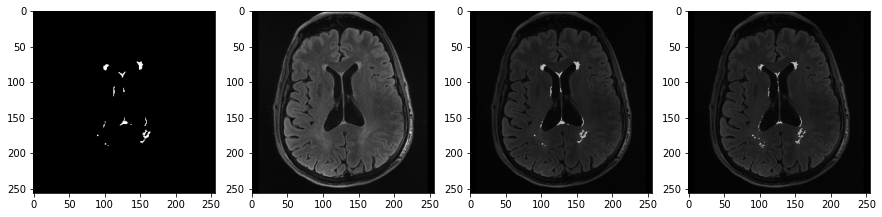

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.42it/s, acc=77.1990%, loss=0.2978]

<Figure size 432x288 with 0 Axes>

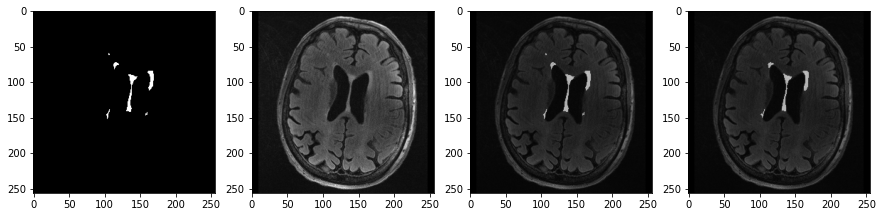

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.80it/s, acc=77.0083%, loss=0.3005]

<Figure size 432x288 with 0 Axes>

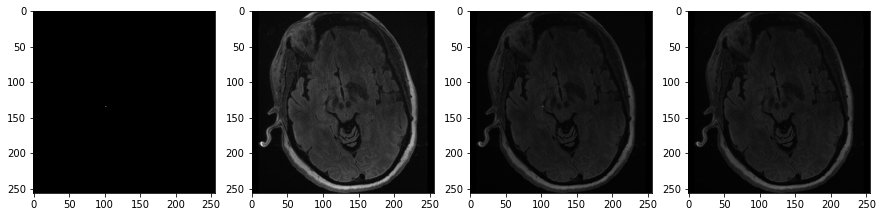

Train:   1%| | 1/157 [00:00<00:30,  5.12it/s, acc=94.2767%, loss=0.0615, lr=0.00

Val Acc 76.9831%	 Val Loss 0.3007


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=79.9712%, loss=0.2496]


Epoch 36/100: 
Train Acc 93.2771%	 Train Loss 0.0730	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

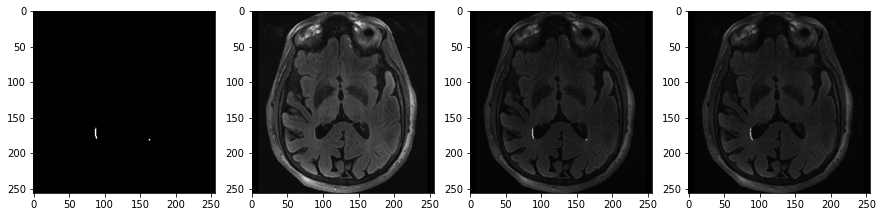

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.10it/s, acc=77.4312%, loss=0.2934]

<Figure size 432x288 with 0 Axes>

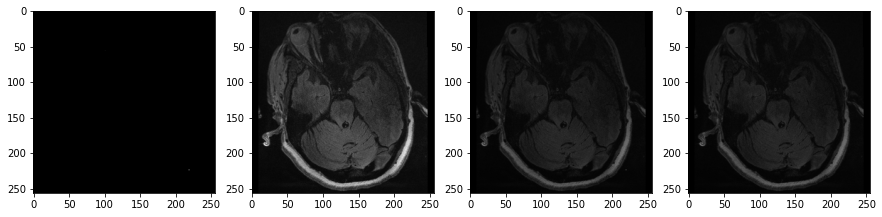

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.40it/s, acc=76.8115%, loss=0.3052]

<Figure size 432x288 with 0 Axes>

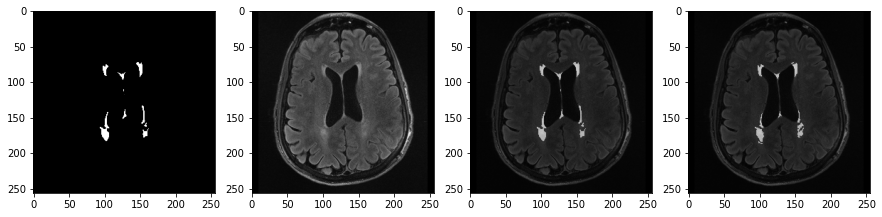

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.73it/s, acc=76.7556%, loss=0.3058]

<Figure size 432x288 with 0 Axes>

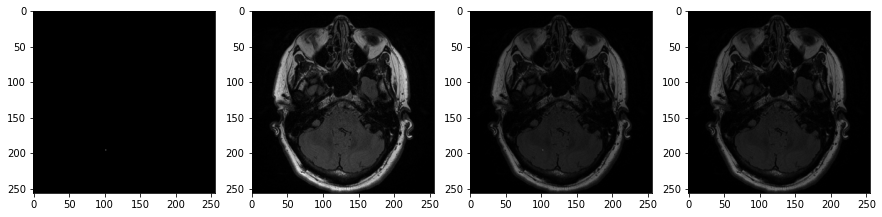

Train:   1%| | 1/157 [00:00<00:30,  5.12it/s, acc=93.7474%, loss=0.0670, lr=0.00

Val Acc 76.8013%	 Val Loss 0.3047


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=74.4146%, loss=0.3435]


Epoch 37/100: 
Train Acc 93.4248%	 Train Loss 0.0712	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

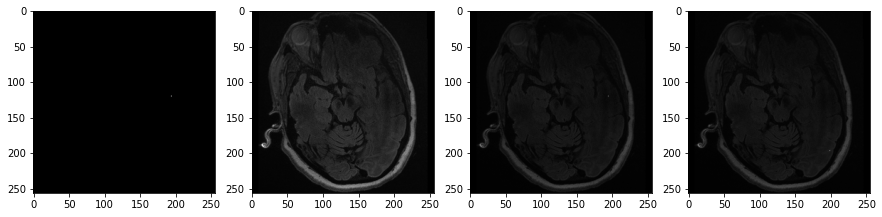

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.15it/s, acc=77.0290%, loss=0.3009]

<Figure size 432x288 with 0 Axes>

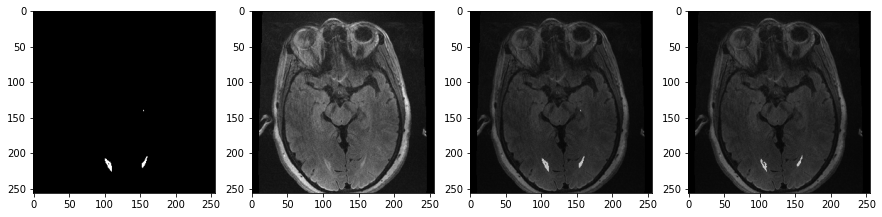

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.42it/s, acc=77.5489%, loss=0.2914]

<Figure size 432x288 with 0 Axes>

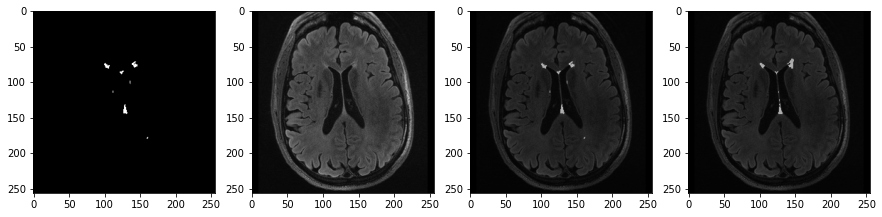

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.77it/s, acc=76.6225%, loss=0.3082]

<Figure size 432x288 with 0 Axes>

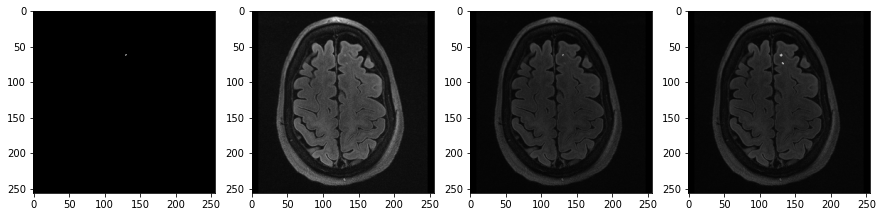

Train:   1%| | 1/157 [00:00<00:30,  5.03it/s, acc=94.6712%, loss=0.0567, lr=0.00

Val Acc 76.6890%	 Val Loss 0.3072


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=78.6017%, loss=0.2716]


Epoch 38/100: 
Train Acc 93.5428%	 Train Loss 0.0699	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

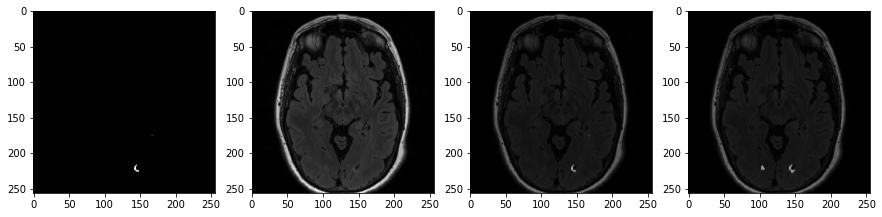

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.09it/s, acc=78.1305%, loss=0.2814]

<Figure size 432x288 with 0 Axes>

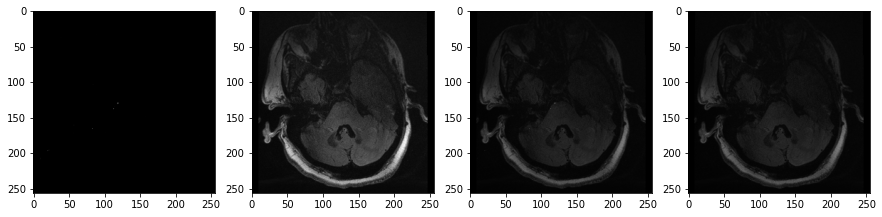

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.42it/s, acc=78.0919%, loss=0.2821]

<Figure size 432x288 with 0 Axes>

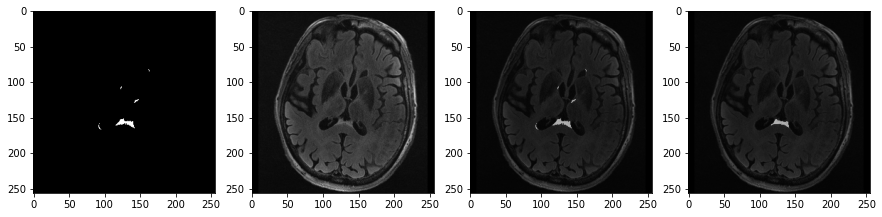

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.74it/s, acc=77.3705%, loss=0.2943]

<Figure size 432x288 with 0 Axes>

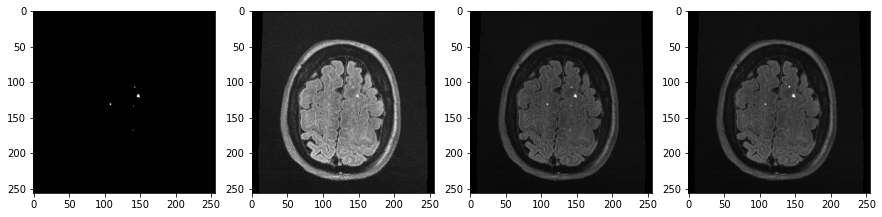

Train:   1%| | 1/157 [00:00<00:30,  5.13it/s, acc=94.7116%, loss=0.0560, lr=0.00

Val Acc 77.2824%	 Val Loss 0.2959


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=73.8812%, loss=0.3530]


Epoch 39/100: 
Train Acc 93.5522%	 Train Loss 0.0697	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

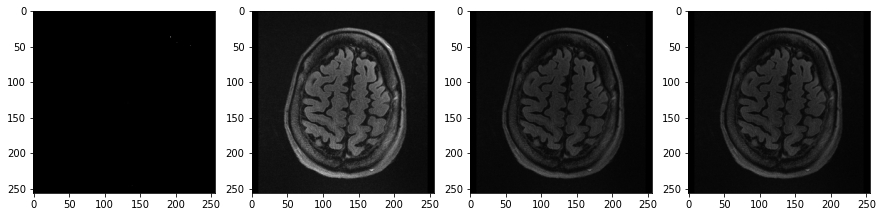

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.12it/s, acc=75.4279%, loss=0.3262]

<Figure size 432x288 with 0 Axes>

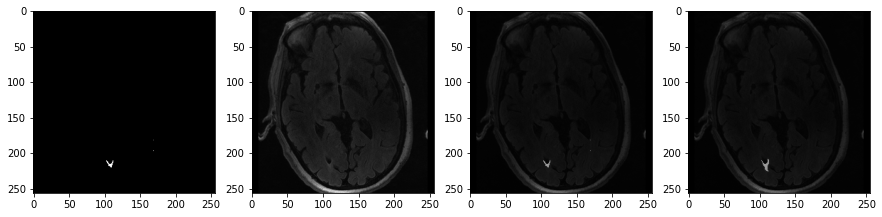

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.40it/s, acc=76.6238%, loss=0.3070]

<Figure size 432x288 with 0 Axes>

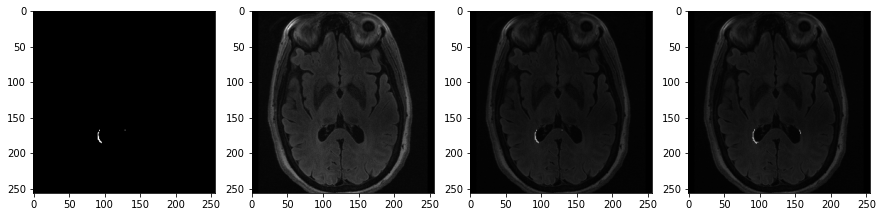

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.79it/s, acc=77.1466%, loss=0.2977]

<Figure size 432x288 with 0 Axes>

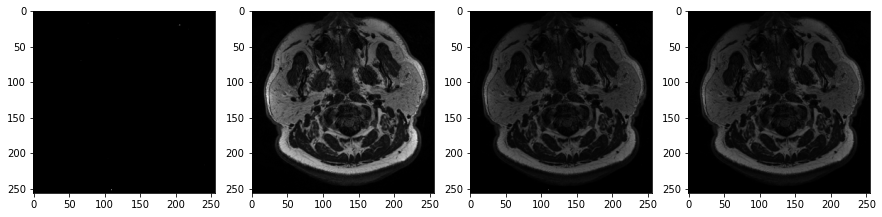

Train:   1%| | 1/157 [00:00<00:30,  5.15it/s, acc=93.6545%, loss=0.0684, lr=0.00

Val Acc 77.2151%	 Val Loss 0.2964


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=73.4271%, loss=0.3632]


Epoch 40/100: 
Train Acc 93.7203%	 Train Loss 0.0679	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

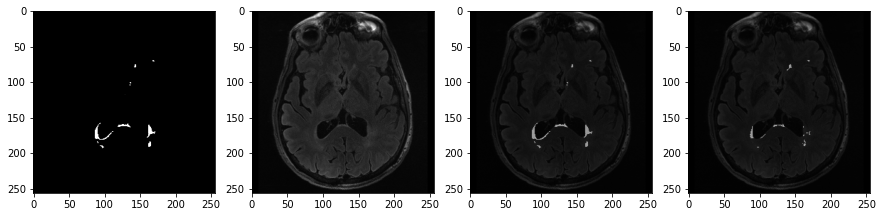

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.15it/s, acc=76.3550%, loss=0.3117]

<Figure size 432x288 with 0 Axes>

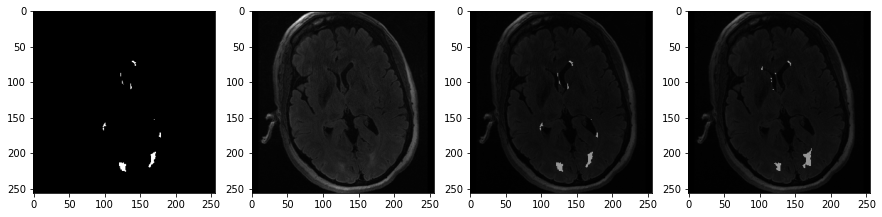

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.43it/s, acc=76.5375%, loss=0.3077]

<Figure size 432x288 with 0 Axes>

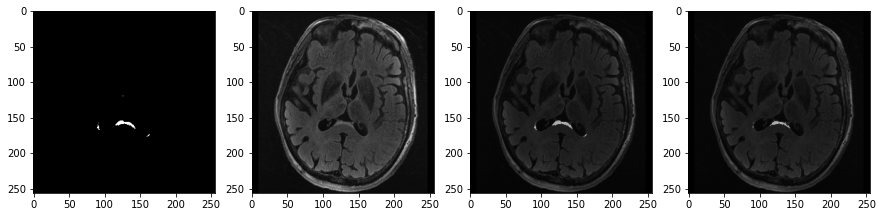

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.76it/s, acc=77.2035%, loss=0.2966]

<Figure size 432x288 with 0 Axes>

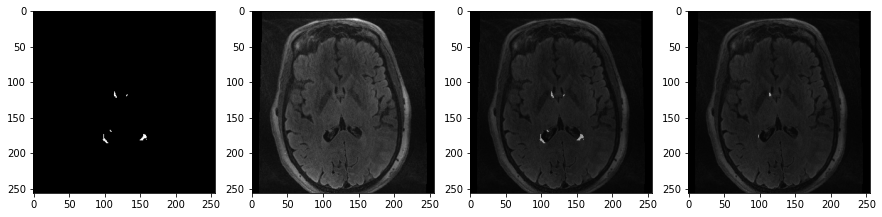

Train:   1%| | 1/157 [00:00<00:30,  5.14it/s, acc=93.4627%, loss=0.0710, lr=0.00

Val Acc 77.2485%	 Val Loss 0.2961


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=76.2549%, loss=0.3110]


Epoch 41/100: 
Train Acc 93.7605%	 Train Loss 0.0674	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

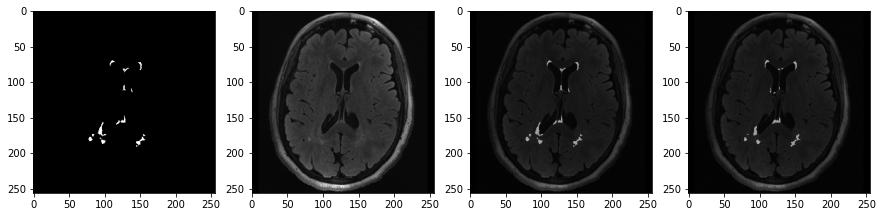

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.11it/s, acc=77.8662%, loss=0.2846]

<Figure size 432x288 with 0 Axes>

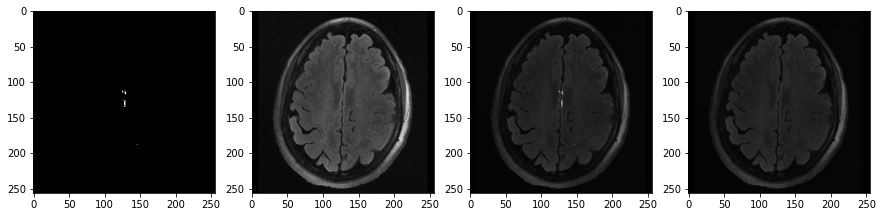

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.41it/s, acc=76.9057%, loss=0.3018]

<Figure size 432x288 with 0 Axes>

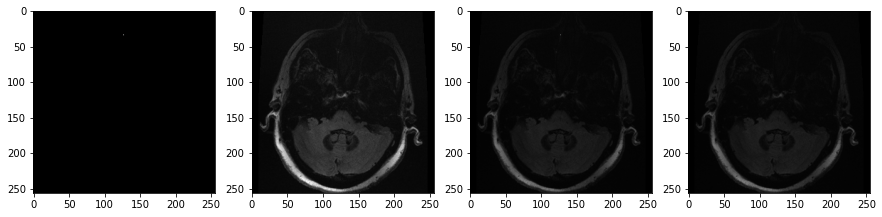

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.79it/s, acc=76.7033%, loss=0.3049]

<Figure size 432x288 with 0 Axes>

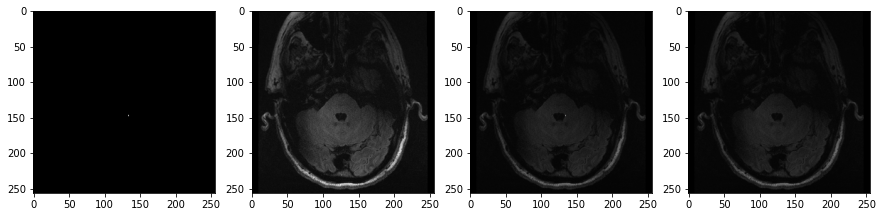

Train:   1%| | 1/157 [00:00<00:30,  5.15it/s, acc=92.9865%, loss=0.0758, lr=0.00

Val Acc 76.7621%	 Val Loss 0.3038


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=71.2062%, loss=0.4033]


Epoch 42/100: 
Train Acc 93.7879%	 Train Loss 0.0671	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

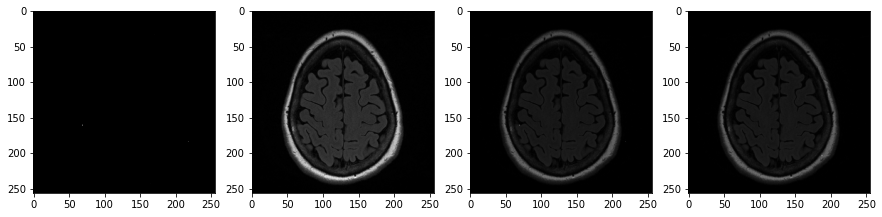

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.19it/s, acc=75.6531%, loss=0.3229]

<Figure size 432x288 with 0 Axes>

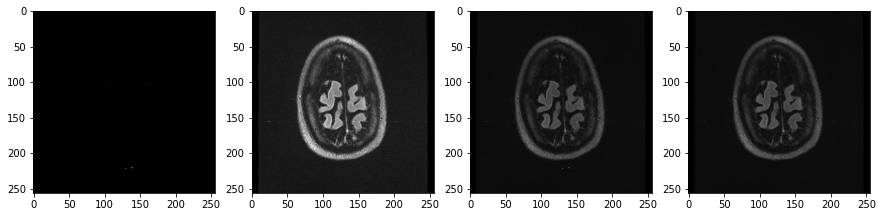

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.45it/s, acc=76.8399%, loss=0.3032]

<Figure size 432x288 with 0 Axes>

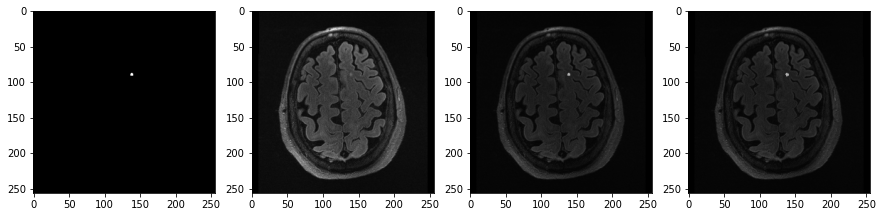

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.82it/s, acc=77.3653%, loss=0.2942]

<Figure size 432x288 with 0 Axes>

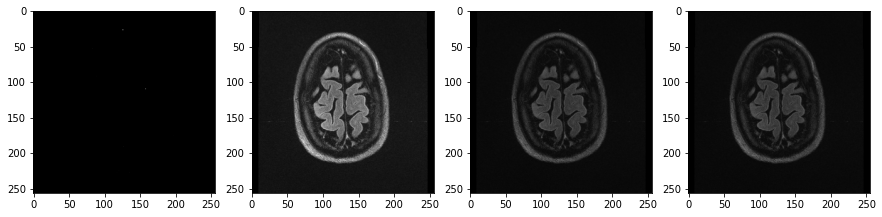

Train:   1%| | 1/157 [00:00<00:30,  5.12it/s, acc=94.8078%, loss=0.0558, lr=0.00

Val Acc 77.2342%	 Val Loss 0.2966


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=75.8688%, loss=0.3161]


Epoch 43/100: 
Train Acc 93.9530%	 Train Loss 0.0653	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

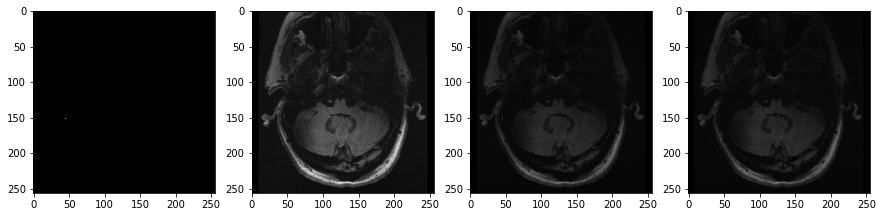

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.11it/s, acc=76.4760%, loss=0.3082]

<Figure size 432x288 with 0 Axes>

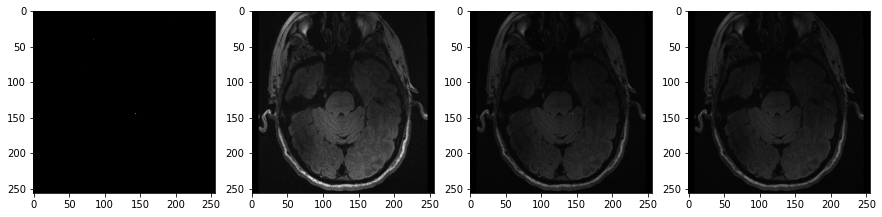

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.40it/s, acc=77.3791%, loss=0.2935]

<Figure size 432x288 with 0 Axes>

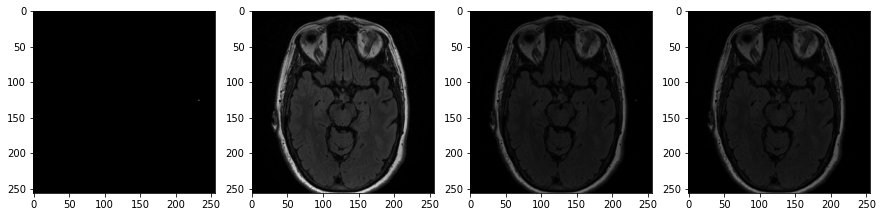

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.78it/s, acc=76.9944%, loss=0.3004]

<Figure size 432x288 with 0 Axes>

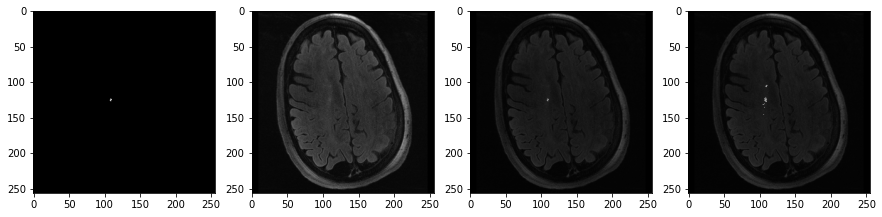

Train:   1%| | 1/157 [00:00<00:30,  5.13it/s, acc=95.2363%, loss=0.0500, lr=0.00

Val Acc 77.0992%	 Val Loss 0.2985


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=69.9169%, loss=0.4305]


Epoch 44/100: 
Train Acc 94.0305%	 Train Loss 0.0643	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

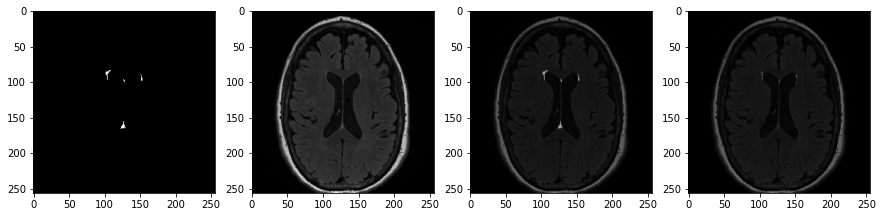

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.14it/s, acc=75.9309%, loss=0.3194]

<Figure size 432x288 with 0 Axes>

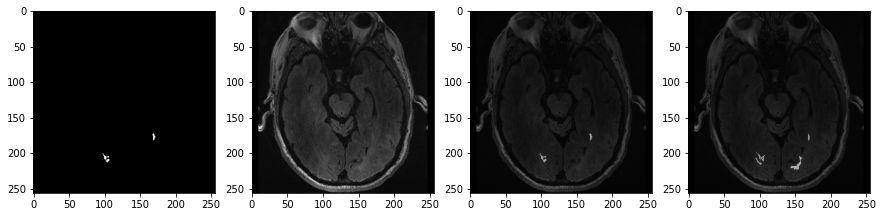

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.41it/s, acc=76.9776%, loss=0.3009]

<Figure size 432x288 with 0 Axes>

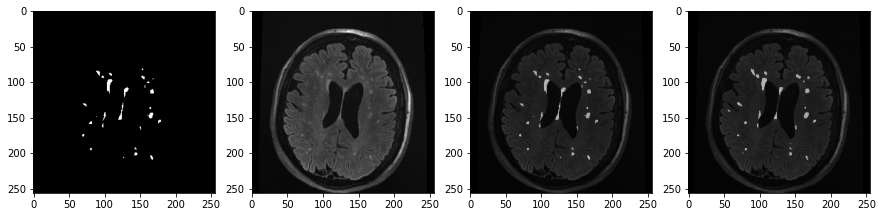

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.75it/s, acc=77.0969%, loss=0.2984]

<Figure size 432x288 with 0 Axes>

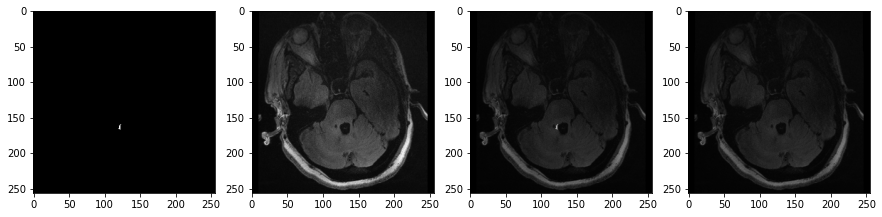

Train:   1%| | 1/157 [00:00<00:30,  5.11it/s, acc=93.9416%, loss=0.0660, lr=0.00

Val Acc 77.1841%	 Val Loss 0.2968


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=82.6345%, loss=0.2109]


Epoch 45/100: 
Train Acc 94.0964%	 Train Loss 0.0636	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

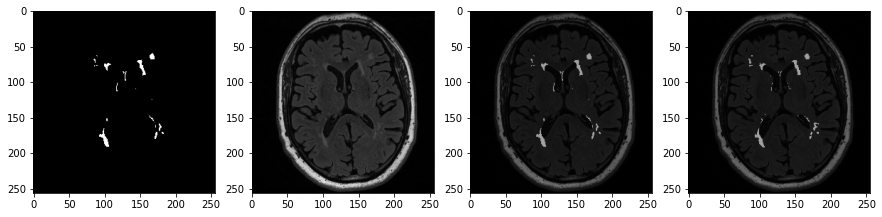

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.02it/s, acc=77.5945%, loss=0.2905]

<Figure size 432x288 with 0 Axes>

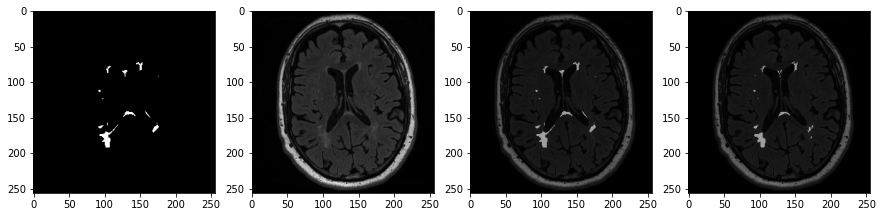

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.49it/s, acc=76.8279%, loss=0.3037]

<Figure size 432x288 with 0 Axes>

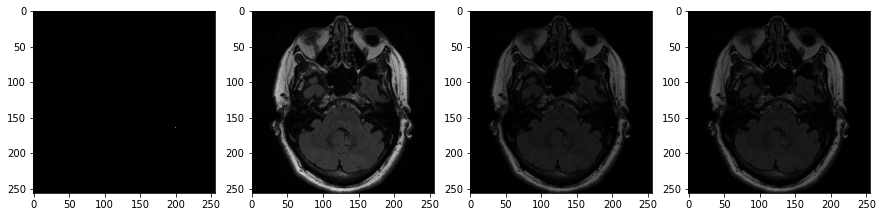

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.72it/s, acc=76.9629%, loss=0.3012]

<Figure size 432x288 with 0 Axes>

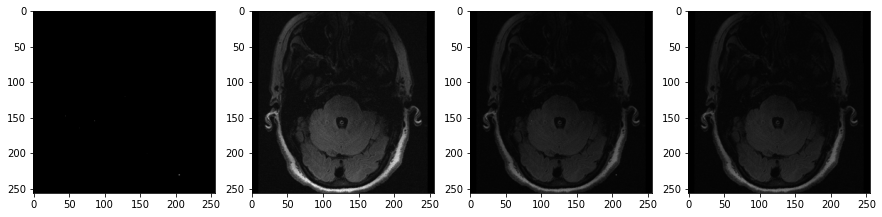

Train:   0%|      | 0/157 [00:00<?, ?it/s, acc=92.5083%, loss=0.0820, lr=0.0000]

Val Acc 76.9852%	 Val Loss 0.3006


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=76.7228%, loss=0.3041]


Epoch 46/100: 
Train Acc 94.1743%	 Train Loss 0.0627	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

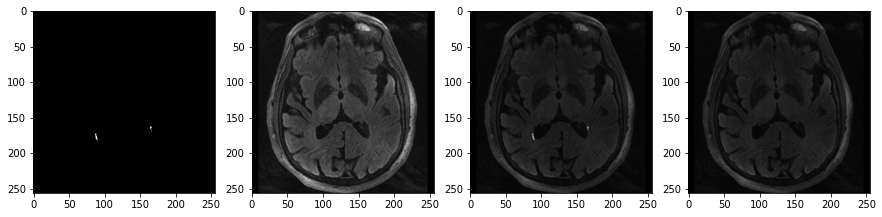

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.14it/s, acc=75.9181%, loss=0.3205]

<Figure size 432x288 with 0 Axes>

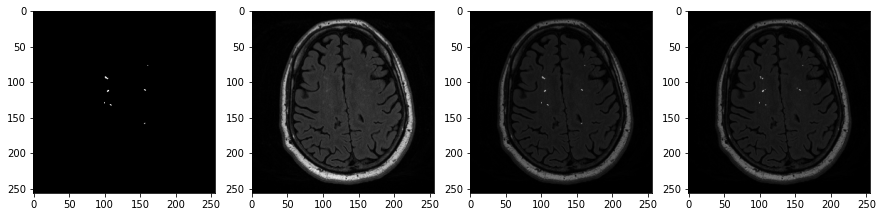

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.42it/s, acc=77.4084%, loss=0.2949]

<Figure size 432x288 with 0 Axes>

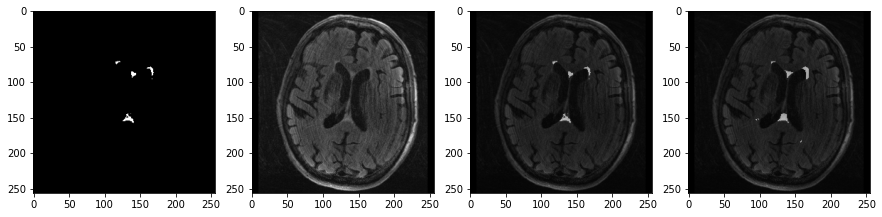

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.75it/s, acc=76.9854%, loss=0.3015]

<Figure size 432x288 with 0 Axes>

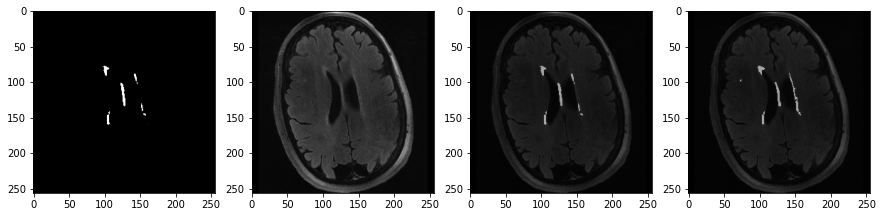

Train:   1%| | 1/157 [00:00<00:30,  5.16it/s, acc=94.0298%, loss=0.0640, lr=0.00

Val Acc 77.0330%	 Val Loss 0.3004


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=79.1088%, loss=0.2639]


Epoch 47/100: 
Train Acc 94.2477%	 Train Loss 0.0619	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

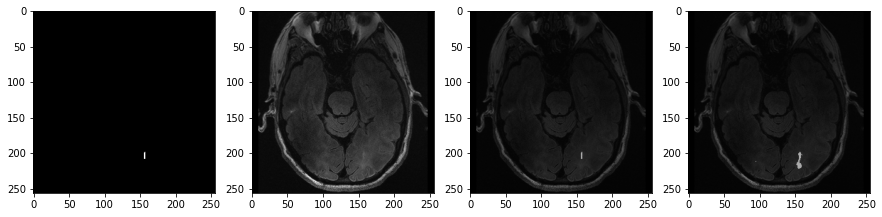

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.16it/s, acc=77.7524%, loss=0.2880]

<Figure size 432x288 with 0 Axes>

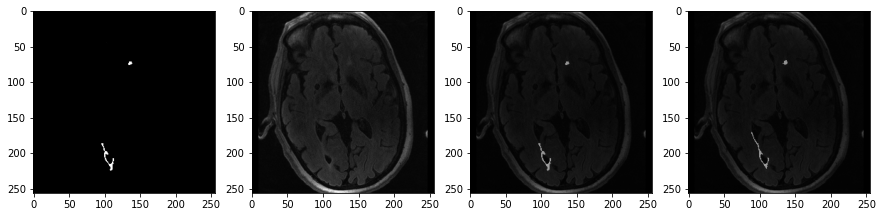

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.42it/s, acc=77.0913%, loss=0.2988]

<Figure size 432x288 with 0 Axes>

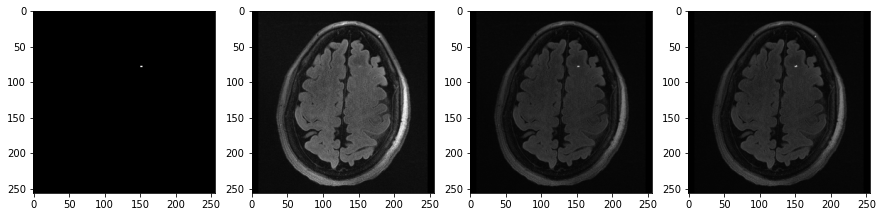

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.74it/s, acc=77.3475%, loss=0.2950]

<Figure size 432x288 with 0 Axes>

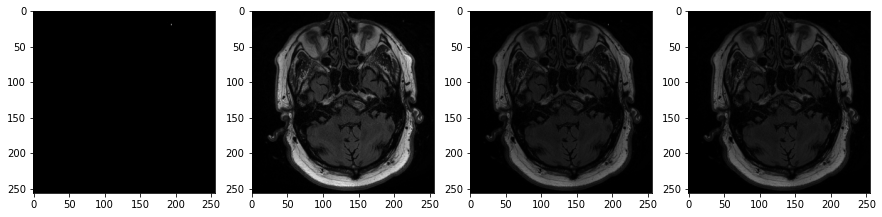

Train:   1%| | 1/157 [00:00<00:30,  5.15it/s, acc=93.2842%, loss=0.0730, lr=0.00

Val Acc 77.1832%	 Val Loss 0.2979


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=77.7405%, loss=0.2854]


Epoch 48/100: 
Train Acc 94.2105%	 Train Loss 0.0623	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

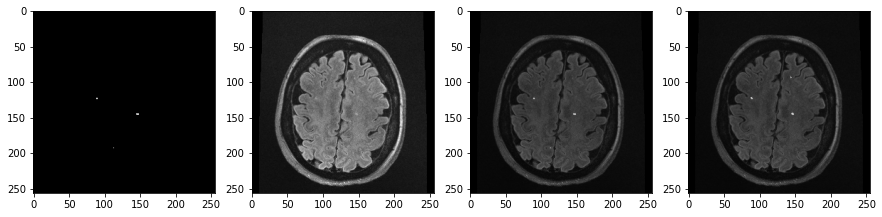

Val:  31%|███▍       | 10/32 [00:01<00:02,  7.68it/s, acc=76.3157%, loss=0.3114]

<Figure size 432x288 with 0 Axes>

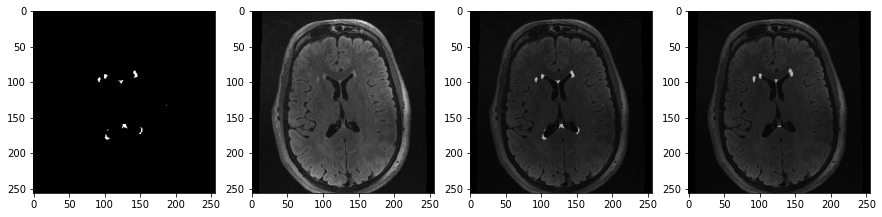

Val:  56%|██████▏    | 18/32 [00:02<00:01,  9.89it/s, acc=76.5853%, loss=0.3072]

<Figure size 432x288 with 0 Axes>

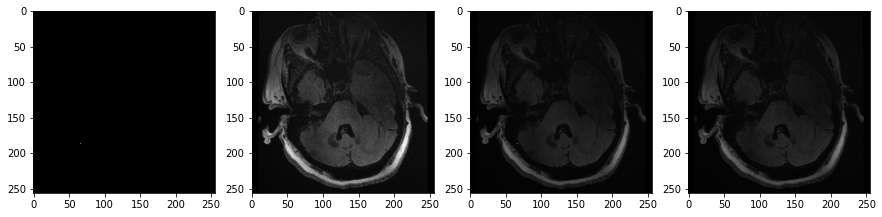

Val:  88%|█████████▋ | 28/32 [00:03<00:00, 11.66it/s, acc=77.1260%, loss=0.2978]

<Figure size 432x288 with 0 Axes>

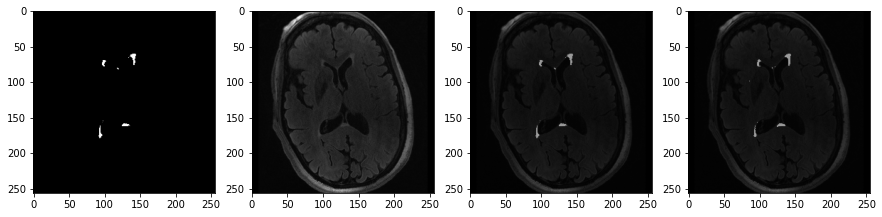

Train:   1%| | 1/157 [00:00<00:30,  5.13it/s, acc=93.9054%, loss=0.0662, lr=0.00

Val Acc 77.2375%	 Val Loss 0.2960


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=80.0017%, loss=0.2499]


Epoch 49/100: 
Train Acc 94.2531%	 Train Loss 0.0619	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

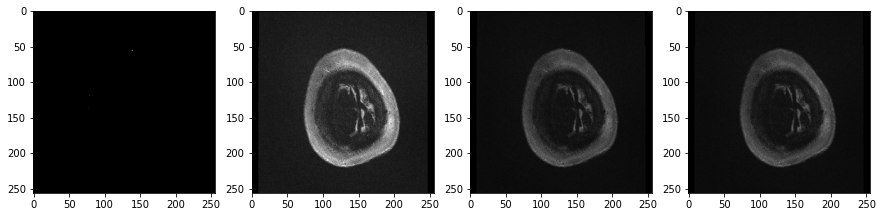

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.20it/s, acc=77.9216%, loss=0.2842]

<Figure size 432x288 with 0 Axes>

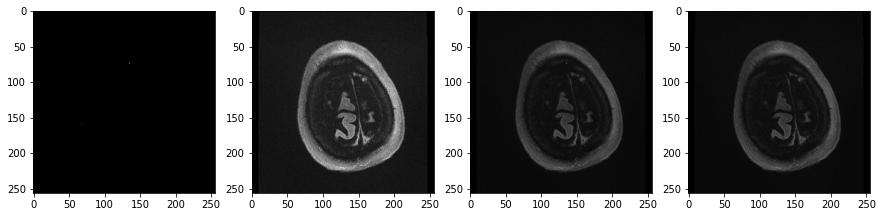

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.45it/s, acc=77.5300%, loss=0.2907]

<Figure size 432x288 with 0 Axes>

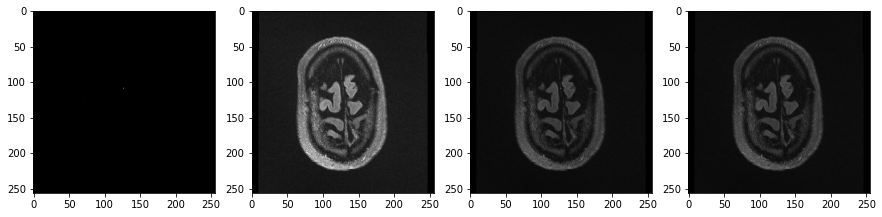

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.77it/s, acc=77.3214%, loss=0.2941]

<Figure size 432x288 with 0 Axes>

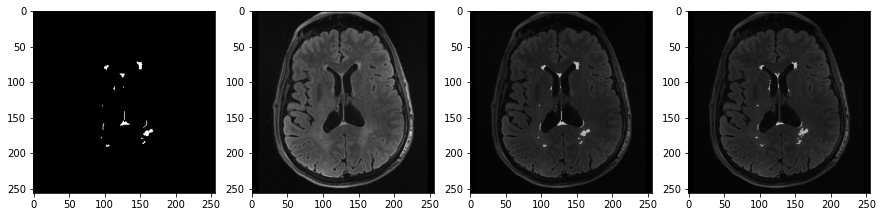

Train:   1%| | 1/157 [00:00<00:30,  5.08it/s, acc=94.6360%, loss=0.0570, lr=0.00

Val Acc 77.3221%	 Val Loss 0.2940


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=77.6975%, loss=0.2860]


Epoch 50/100: 
Train Acc 94.3479%	 Train Loss 0.0608	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

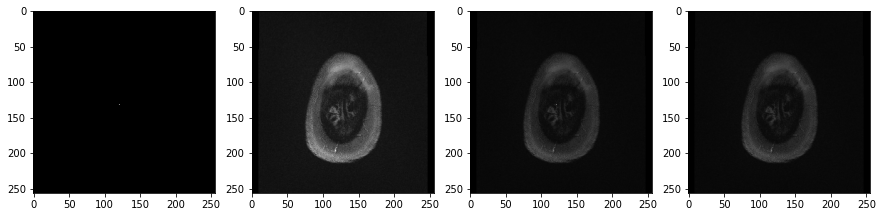

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.15it/s, acc=76.6984%, loss=0.3048]

<Figure size 432x288 with 0 Axes>

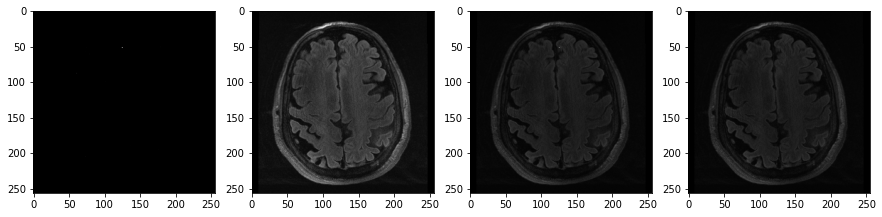

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.43it/s, acc=77.2157%, loss=0.2963]

<Figure size 432x288 with 0 Axes>

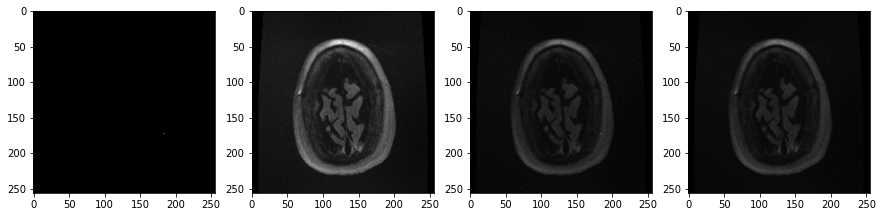

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.77it/s, acc=77.3830%, loss=0.2938]

<Figure size 432x288 with 0 Axes>

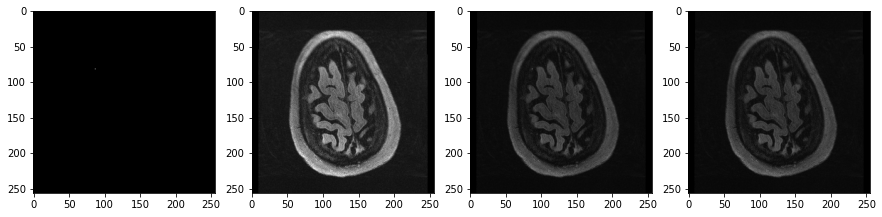

Train:   1%| | 1/157 [00:00<00:30,  5.13it/s, acc=94.3784%, loss=0.0599, lr=0.00

Val Acc 77.0062%	 Val Loss 0.3004


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=78.9953%, loss=0.2657]


Epoch 51/100: 
Train Acc 94.4202%	 Train Loss 0.0599	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

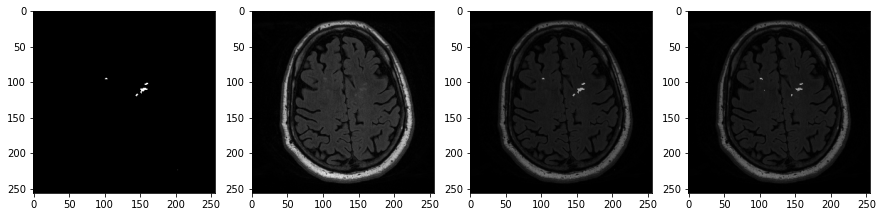

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.14it/s, acc=76.4281%, loss=0.3096]

<Figure size 432x288 with 0 Axes>

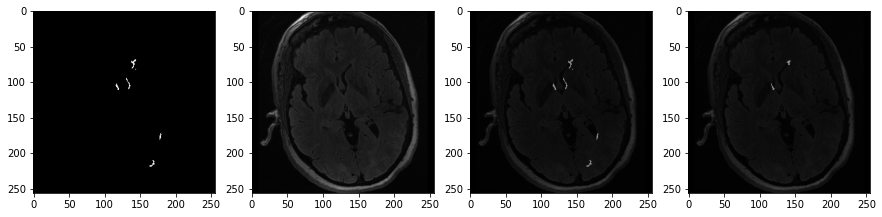

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.35it/s, acc=77.4420%, loss=0.2939]

<Figure size 432x288 with 0 Axes>

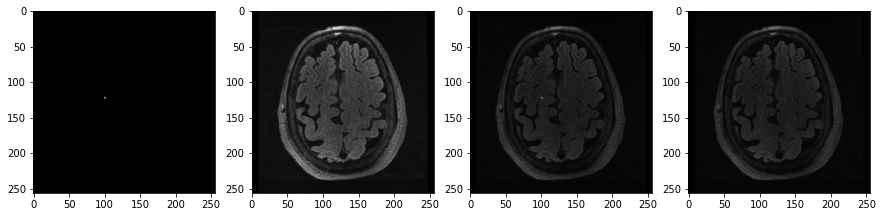

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.77it/s, acc=76.9808%, loss=0.3013]

<Figure size 432x288 with 0 Axes>

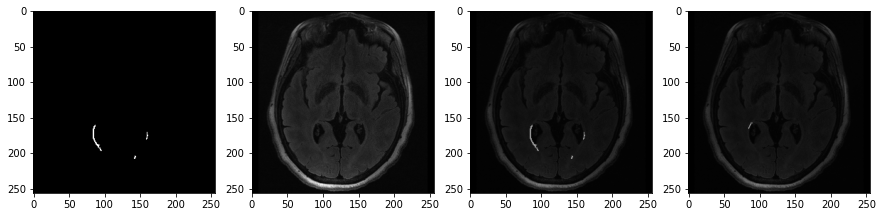

Train:   1%| | 1/157 [00:00<00:30,  5.15it/s, acc=94.1885%, loss=0.0620, lr=0.00

Val Acc 76.9291%	 Val Loss 0.3018


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=70.6875%, loss=0.4123]


Epoch 52/100: 
Train Acc 94.1196%	 Train Loss 0.0599	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

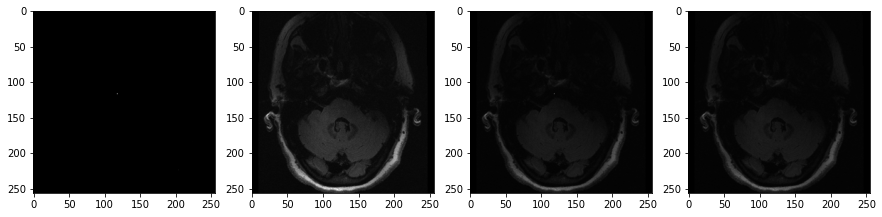

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.19it/s, acc=76.1030%, loss=0.3176]

<Figure size 432x288 with 0 Axes>

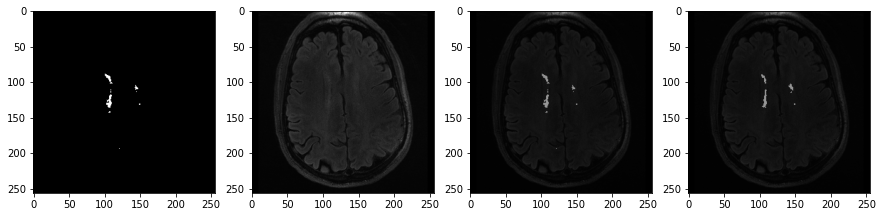

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.41it/s, acc=76.8103%, loss=0.3045]

<Figure size 432x288 with 0 Axes>

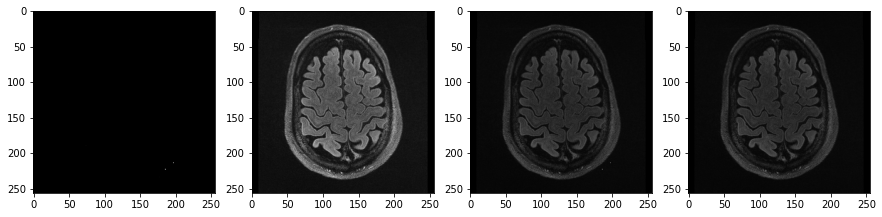

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.78it/s, acc=76.6494%, loss=0.3068]

<Figure size 432x288 with 0 Axes>

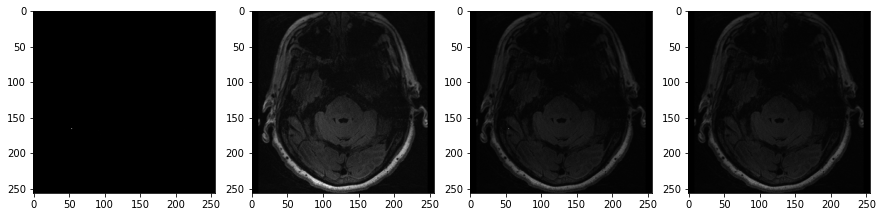

Train:   1%| | 1/157 [00:00<00:30,  5.10it/s, acc=95.6417%, loss=0.0459, lr=0.00

Val Acc 76.6631%	 Val Loss 0.3067


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=79.1723%, loss=0.2630]


Epoch 53/100: 
Train Acc 94.4346%	 Train Loss 0.0598	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

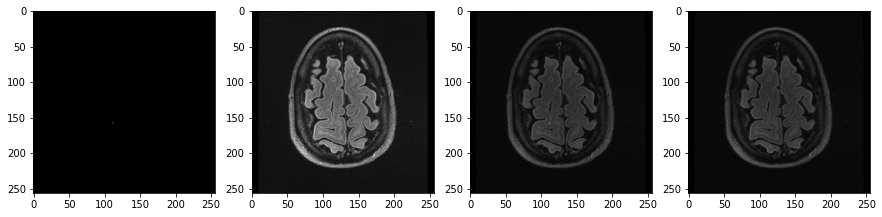

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.12it/s, acc=77.2432%, loss=0.2961]

<Figure size 432x288 with 0 Axes>

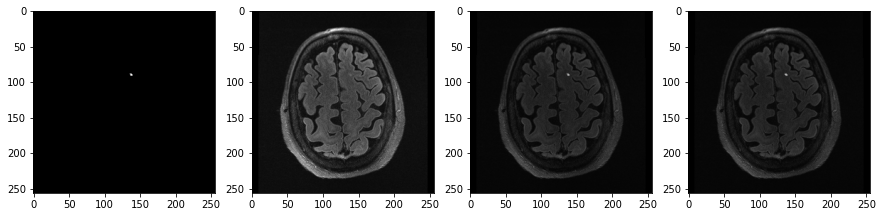

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.51it/s, acc=76.7395%, loss=0.3047]

<Figure size 432x288 with 0 Axes>

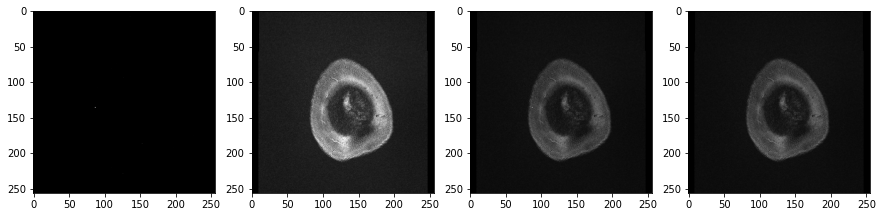

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.73it/s, acc=77.0587%, loss=0.2999]

<Figure size 432x288 with 0 Axes>

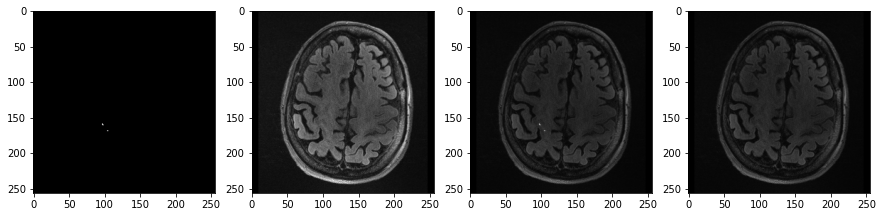

Train:   0%|      | 0/157 [00:00<?, ?it/s, acc=94.3087%, loss=0.0611, lr=0.0000]

Val Acc 77.2249%	 Val Loss 0.2970


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=77.7845%, loss=0.2845]


Epoch 54/100: 
Train Acc 94.4642%	 Train Loss 0.0595	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

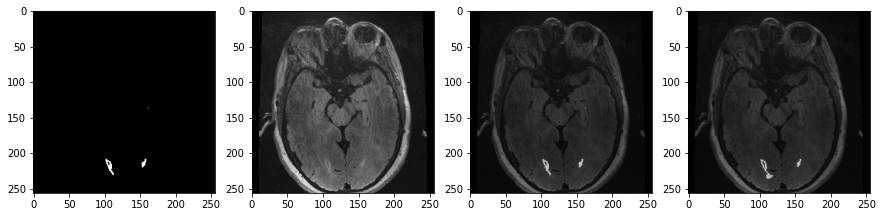

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.17it/s, acc=76.6362%, loss=0.3073]

<Figure size 432x288 with 0 Axes>

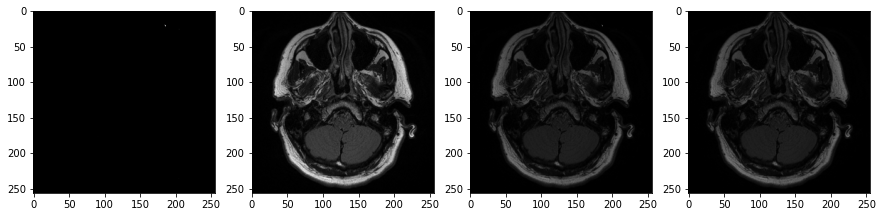

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.45it/s, acc=76.7621%, loss=0.3052]

<Figure size 432x288 with 0 Axes>

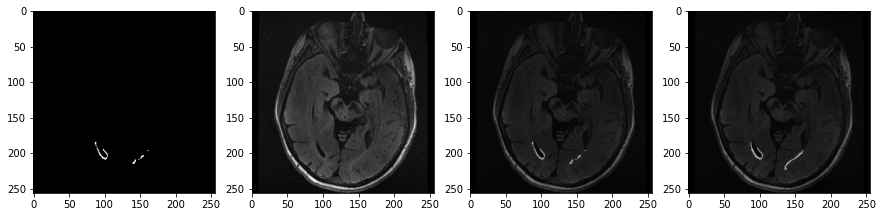

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.80it/s, acc=76.9217%, loss=0.3021]

<Figure size 432x288 with 0 Axes>

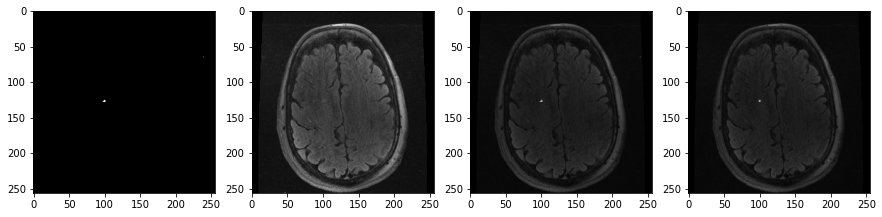

Train:   1%| | 1/157 [00:00<00:30,  5.14it/s, acc=96.0831%, loss=0.0415, lr=0.00

Val Acc 76.8854%	 Val Loss 0.3026


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=71.9342%, loss=0.3884]


Epoch 55/100: 
Train Acc 94.4670%	 Train Loss 0.0594	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

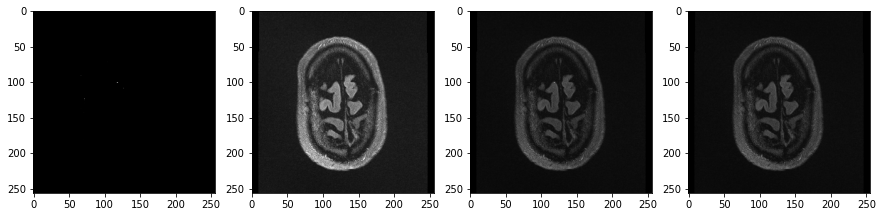

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.13it/s, acc=77.2996%, loss=0.2960]

<Figure size 432x288 with 0 Axes>

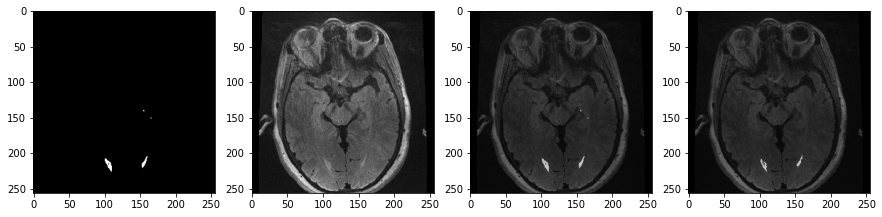

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.40it/s, acc=77.5662%, loss=0.2910]

<Figure size 432x288 with 0 Axes>

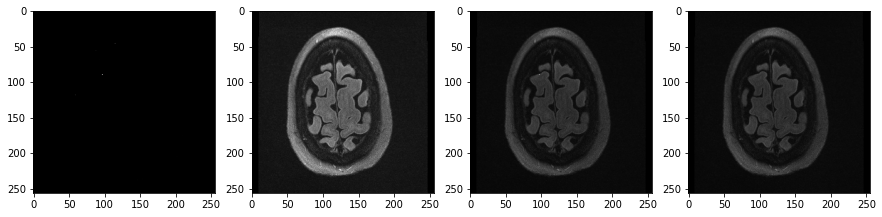

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.76it/s, acc=77.2899%, loss=0.2956]

<Figure size 432x288 with 0 Axes>

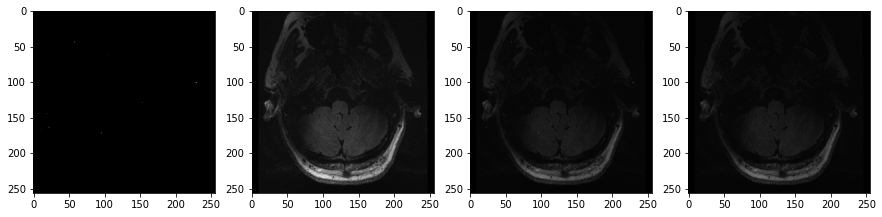

Train:   1%| | 1/157 [00:00<00:30,  5.09it/s, acc=95.3381%, loss=0.0494, lr=0.00

Val Acc 77.1740%	 Val Loss 0.2975


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=75.2321%, loss=0.3307]


Epoch 56/100: 
Train Acc 94.5239%	 Train Loss 0.0588	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

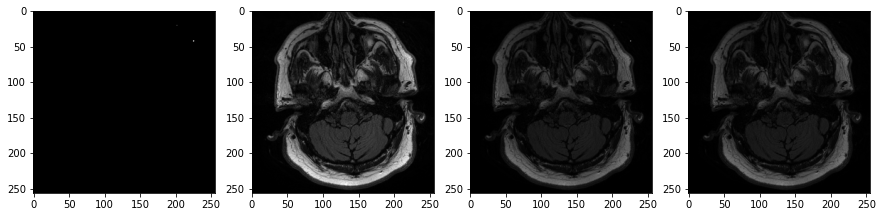

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.14it/s, acc=76.5263%, loss=0.3081]

<Figure size 432x288 with 0 Axes>

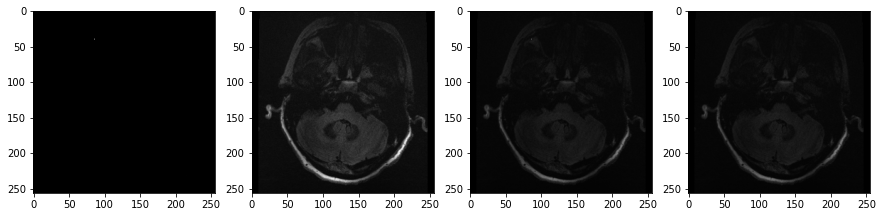

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.44it/s, acc=76.5834%, loss=0.3069]

<Figure size 432x288 with 0 Axes>

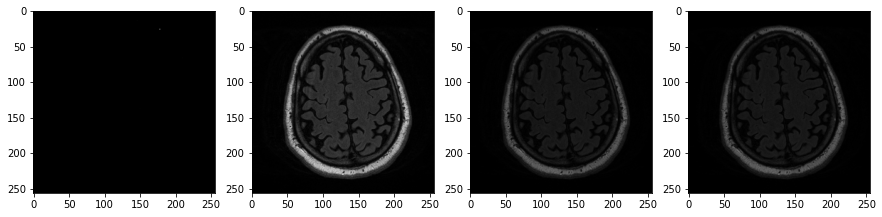

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.79it/s, acc=77.2082%, loss=0.2967]

<Figure size 432x288 with 0 Axes>

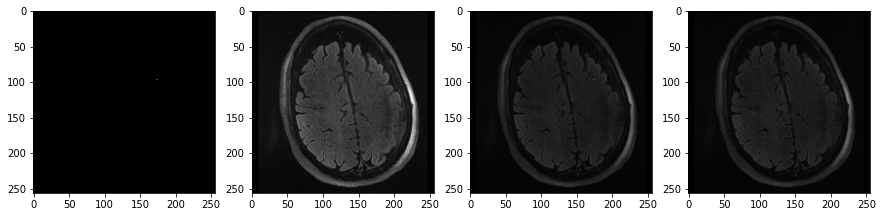

Train:   1%| | 1/157 [00:00<00:30,  5.11it/s, acc=95.4737%, loss=0.0478, lr=0.00

Val Acc 77.0156%	 Val Loss 0.2998


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=76.5437%, loss=0.3065]


Epoch 57/100: 
Train Acc 94.5082%	 Train Loss 0.0590	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

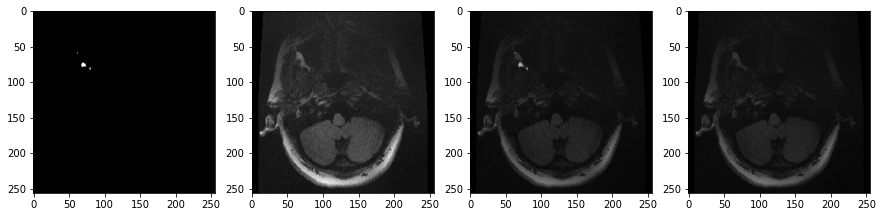

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.13it/s, acc=75.9137%, loss=0.3181]

<Figure size 432x288 with 0 Axes>

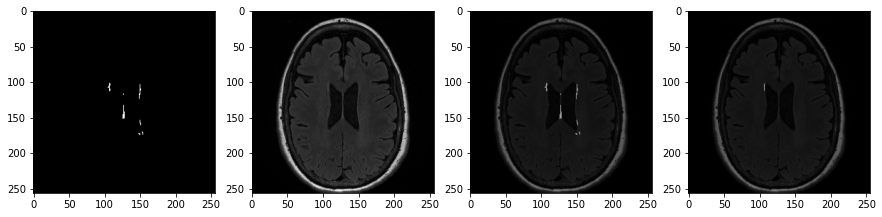

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.44it/s, acc=76.7471%, loss=0.3044]

<Figure size 432x288 with 0 Axes>

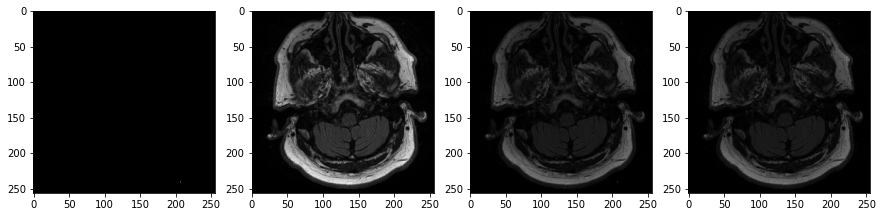

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.77it/s, acc=77.3057%, loss=0.2951]

<Figure size 432x288 with 0 Axes>

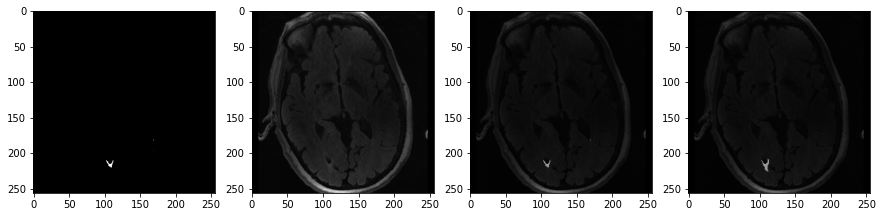

Train:   1%| | 1/157 [00:00<00:30,  5.09it/s, acc=94.8145%, loss=0.0552, lr=0.00

Val Acc 77.2550%	 Val Loss 0.2958


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=79.6819%, loss=0.2543]


Epoch 58/100: 
Train Acc 94.5017%	 Train Loss 0.0590	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

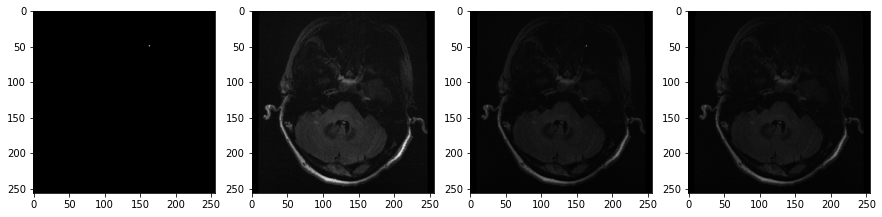

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.06it/s, acc=75.7510%, loss=0.3230]

<Figure size 432x288 with 0 Axes>

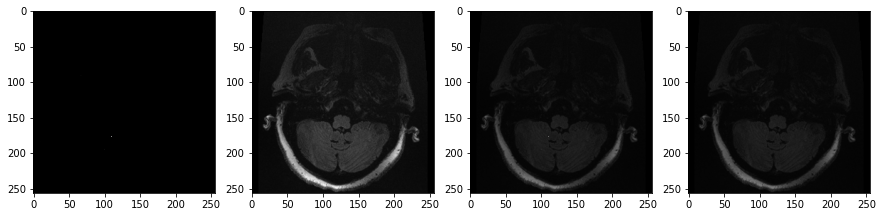

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.41it/s, acc=76.6665%, loss=0.3061]

<Figure size 432x288 with 0 Axes>

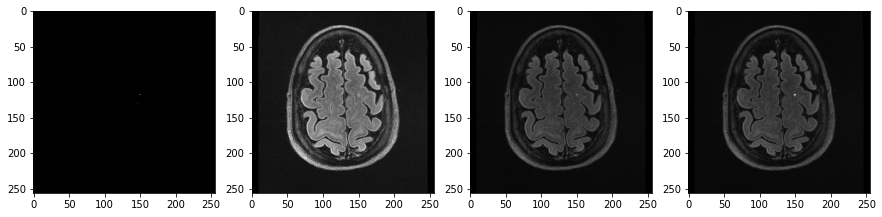

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.76it/s, acc=77.5251%, loss=0.2920]

<Figure size 432x288 with 0 Axes>

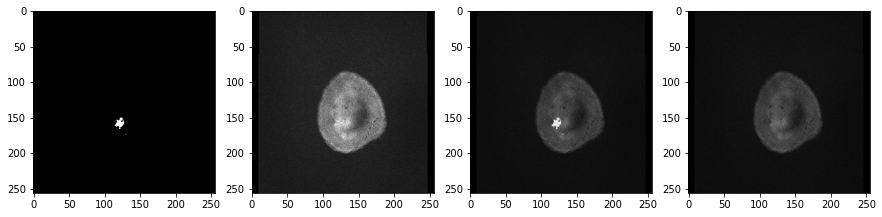

Train:   1%| | 1/157 [00:00<00:30,  5.13it/s, acc=95.2455%, loss=0.0505, lr=0.00

Val Acc 76.8853%	 Val Loss 0.3030


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=75.9822%, loss=0.3145]


Epoch 59/100: 
Train Acc 94.5345%	 Train Loss 0.0586	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

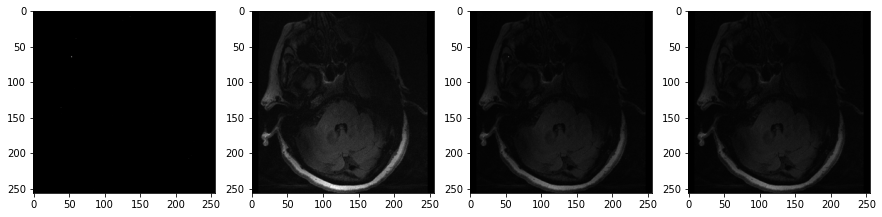

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.16it/s, acc=77.4431%, loss=0.2938]

<Figure size 432x288 with 0 Axes>

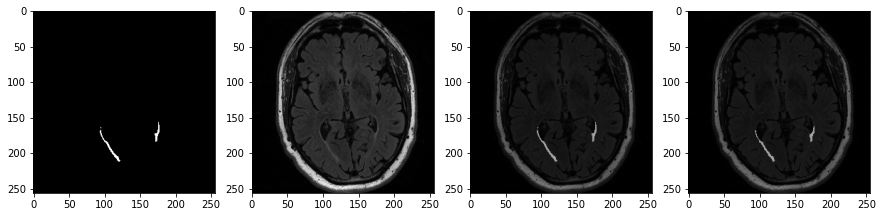

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.39it/s, acc=77.1079%, loss=0.2992]

<Figure size 432x288 with 0 Axes>

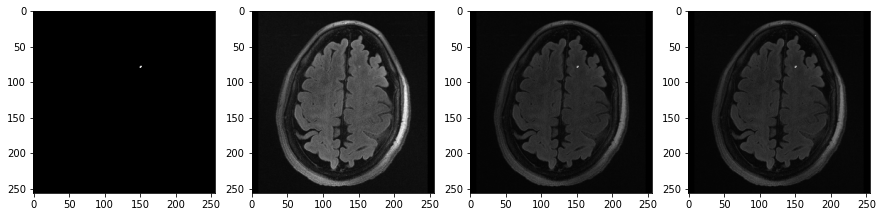

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.77it/s, acc=76.5693%, loss=0.3083]

<Figure size 432x288 with 0 Axes>

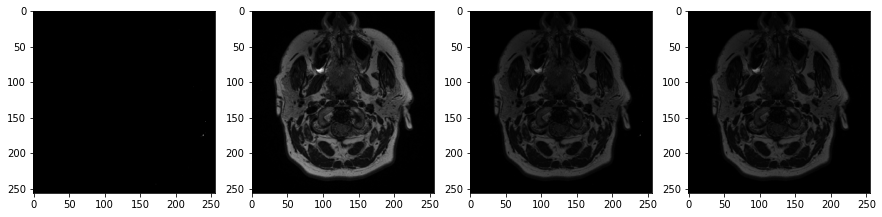

Train:   1%| | 1/157 [00:00<00:30,  5.13it/s, acc=95.6648%, loss=0.0455, lr=0.00

Val Acc 76.8836%	 Val Loss 0.3028


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=77.1333%, loss=0.2972]


Epoch 60/100: 
Train Acc 94.5795%	 Train Loss 0.0581	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

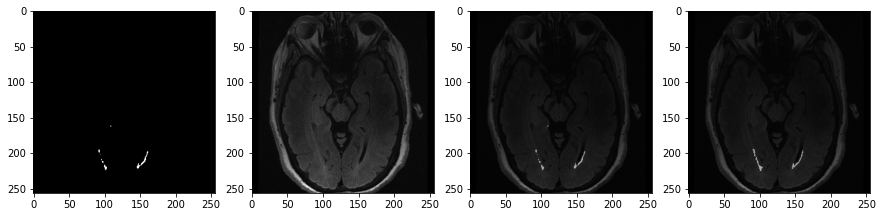

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.08it/s, acc=76.9982%, loss=0.2999]

<Figure size 432x288 with 0 Axes>

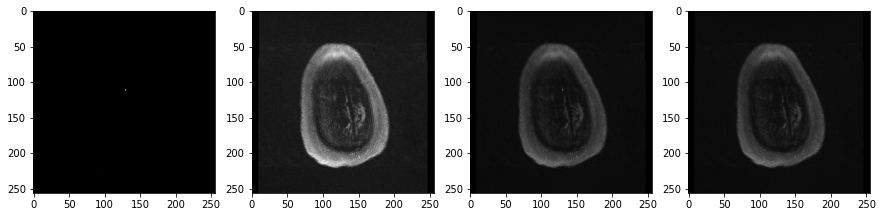

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.48it/s, acc=76.8317%, loss=0.3030]

<Figure size 432x288 with 0 Axes>

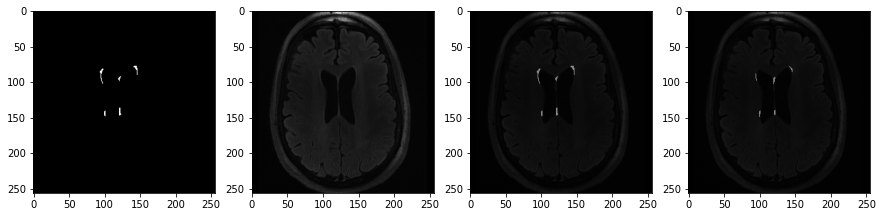

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.70it/s, acc=77.0052%, loss=0.3007]

<Figure size 432x288 with 0 Axes>

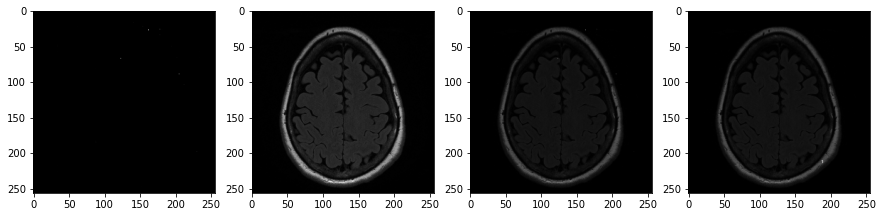

Train:   0%|      | 0/157 [00:00<?, ?it/s, acc=95.0803%, loss=0.0527, lr=0.0000]

Val Acc 77.0887%	 Val Loss 0.2992


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=76.5898%, loss=0.3065]


Epoch 61/100: 
Train Acc 94.6003%	 Train Loss 0.0579	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

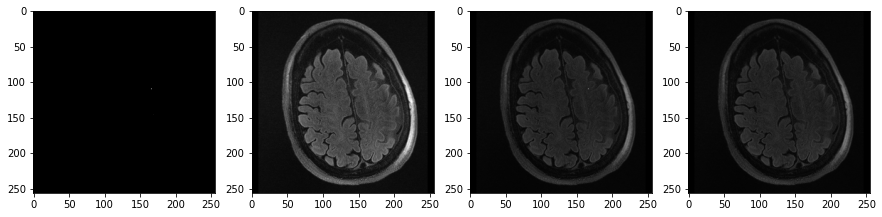

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.15it/s, acc=77.4392%, loss=0.2921]

<Figure size 432x288 with 0 Axes>

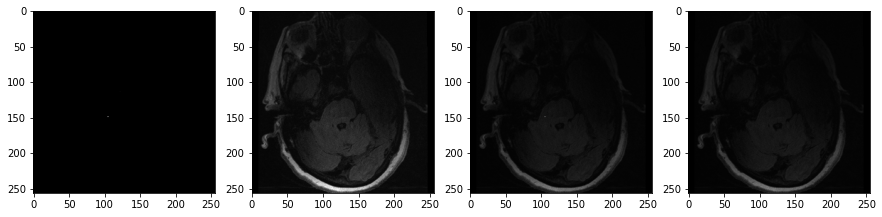

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.52it/s, acc=77.6246%, loss=0.2894]

<Figure size 432x288 with 0 Axes>

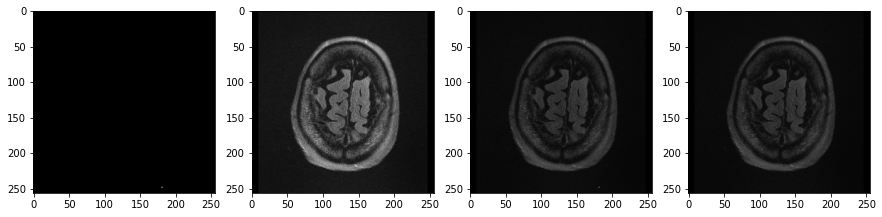

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.87it/s, acc=76.9993%, loss=0.3004]

<Figure size 432x288 with 0 Axes>

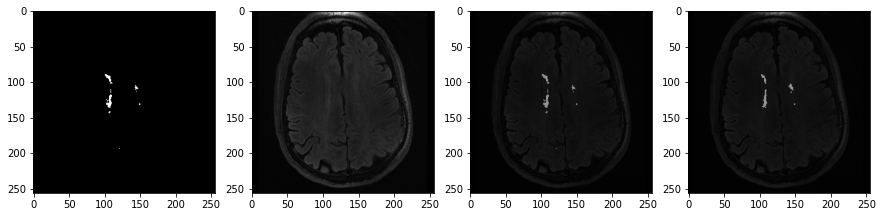

Train:   1%| | 1/157 [00:00<00:31,  5.03it/s, acc=92.2378%, loss=0.0835, lr=0.00

Val Acc 76.9079%	 Val Loss 0.3018


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=75.1202%, loss=0.3314]


Epoch 62/100: 
Train Acc 94.5883%	 Train Loss 0.0580	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

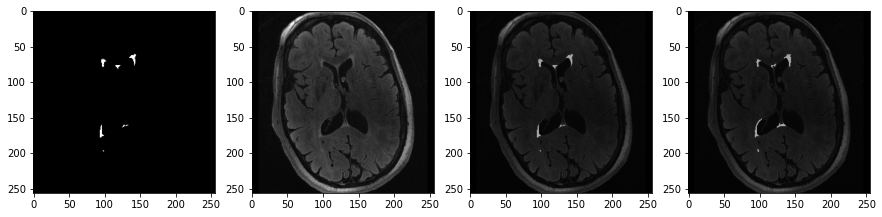

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.14it/s, acc=76.6494%, loss=0.3068]

<Figure size 432x288 with 0 Axes>

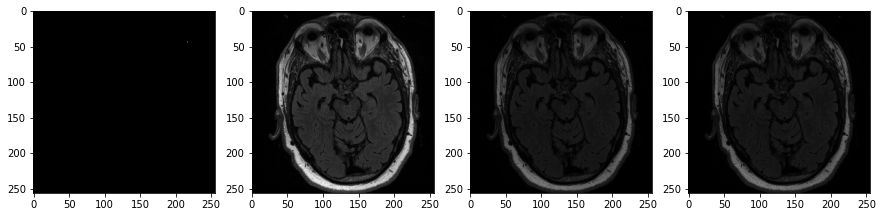

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.42it/s, acc=76.9290%, loss=0.3022]

<Figure size 432x288 with 0 Axes>

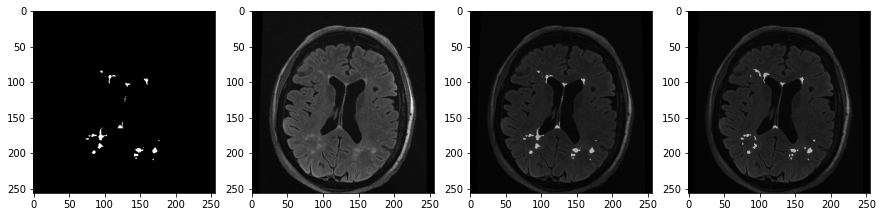

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.79it/s, acc=76.9269%, loss=0.3018]

<Figure size 432x288 with 0 Axes>

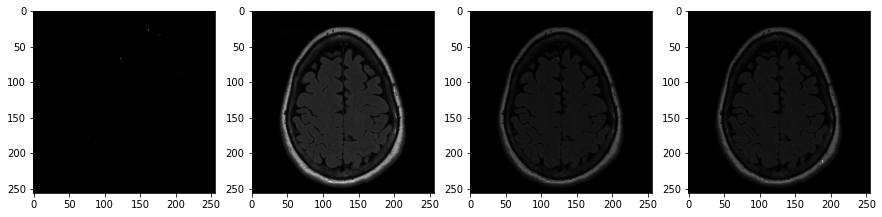

Train:   1%| | 1/157 [00:00<00:30,  5.09it/s, acc=94.5855%, loss=0.0578, lr=0.00

Val Acc 77.1555%	 Val Loss 0.2977


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=83.0002%, loss=0.2047]


Epoch 63/100: 
Train Acc 94.6202%	 Train Loss 0.0576	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

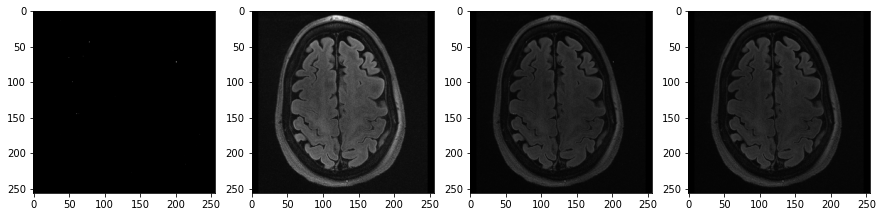

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.11it/s, acc=77.5866%, loss=0.2921]

<Figure size 432x288 with 0 Axes>

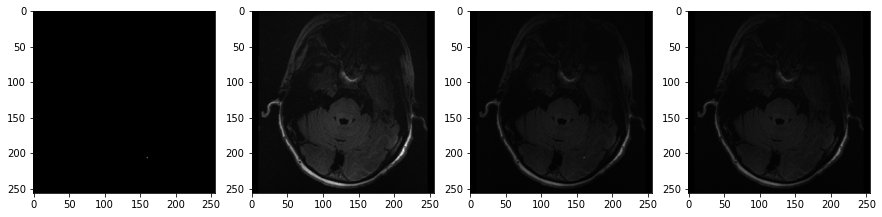

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.52it/s, acc=77.4504%, loss=0.2932]

<Figure size 432x288 with 0 Axes>

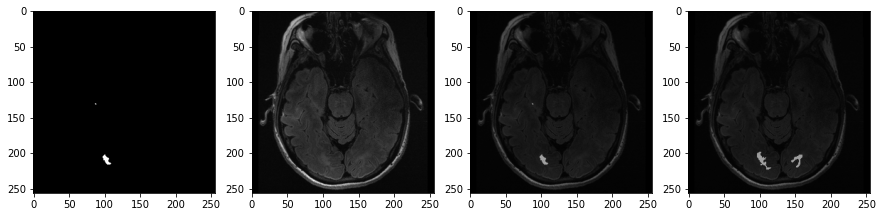

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.70it/s, acc=77.2879%, loss=0.2960]

<Figure size 432x288 with 0 Axes>

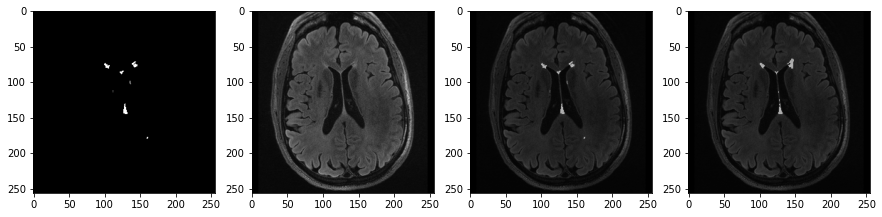

Train:   0%|      | 0/157 [00:00<?, ?it/s, acc=94.4611%, loss=0.0591, lr=0.0000]

Val Acc 76.9681%	 Val Loss 0.3013


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=79.9265%, loss=0.2500]


Epoch 64/100: 
Train Acc 94.5568%	 Train Loss 0.0584	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

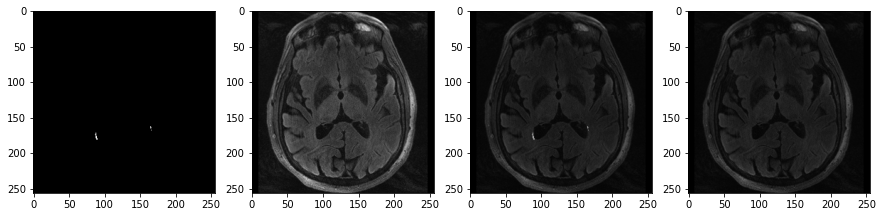

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.14it/s, acc=77.3986%, loss=0.2942]

<Figure size 432x288 with 0 Axes>

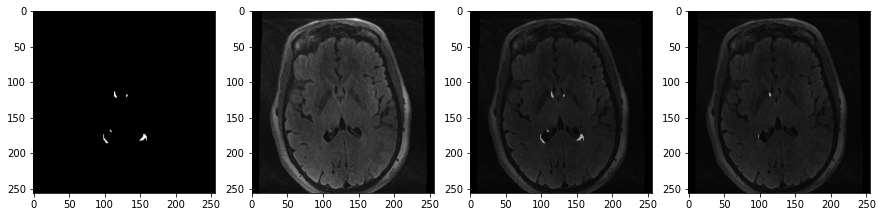

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.55it/s, acc=77.3461%, loss=0.2945]

<Figure size 432x288 with 0 Axes>

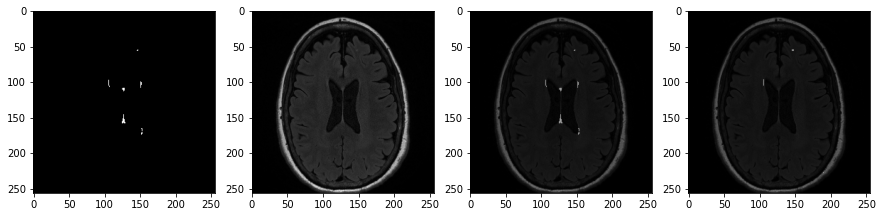

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.96it/s, acc=76.9408%, loss=0.3016]

<Figure size 432x288 with 0 Axes>

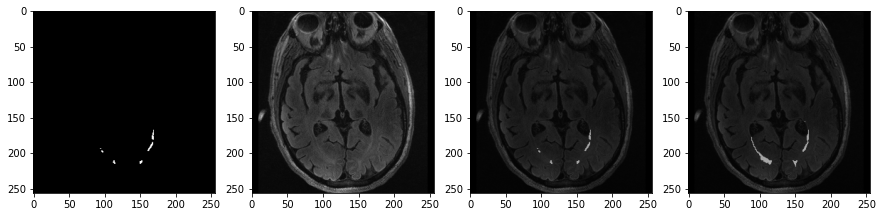

Train:   1%| | 1/157 [00:00<00:30,  5.19it/s, acc=94.8058%, loss=0.0557, lr=0.00

Val Acc 77.1648%	 Val Loss 0.2979


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=80.7215%, loss=0.2376]


Epoch 65/100: 
Train Acc 94.7069%	 Train Loss 0.0567	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

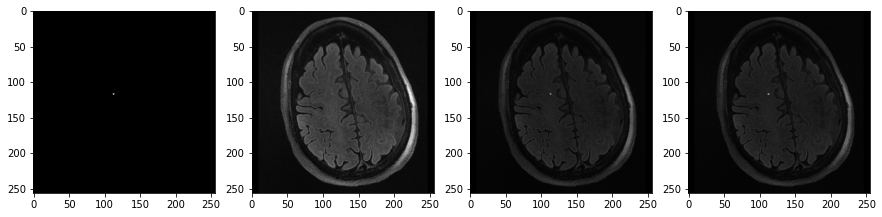

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.13it/s, acc=77.2330%, loss=0.2956]

<Figure size 432x288 with 0 Axes>

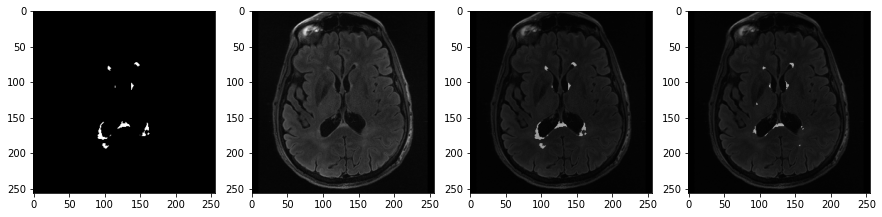

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.50it/s, acc=77.0657%, loss=0.2994]

<Figure size 432x288 with 0 Axes>

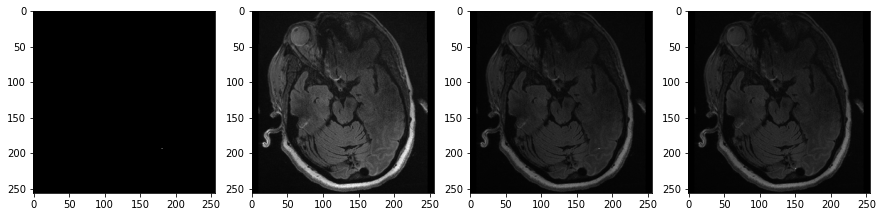

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.71it/s, acc=76.8948%, loss=0.3022]

<Figure size 432x288 with 0 Axes>

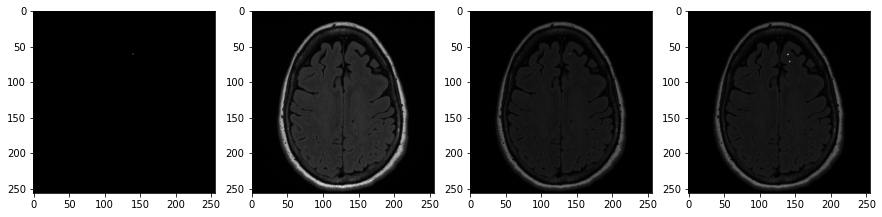

Train:   1%| | 1/157 [00:00<00:30,  5.11it/s, acc=95.6800%, loss=0.0465, lr=0.00

Val Acc 77.0131%	 Val Loss 0.3002


Val:   0%|                    | 0/32 [00:00<?, ?it/s, acc=80.0480%, loss=0.2483]


Epoch 66/100: 
Train Acc 94.6816%	 Train Loss 0.0570	 Learning Rate 0.0000


<Figure size 432x288 with 0 Axes>

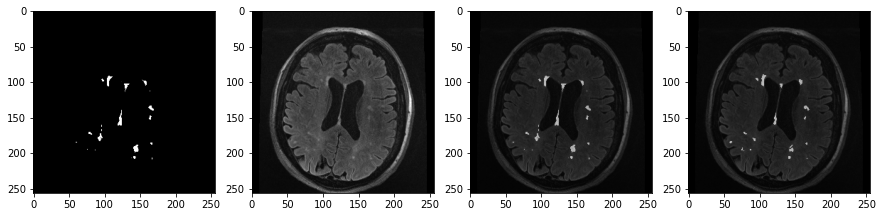

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.22it/s, acc=77.3733%, loss=0.2945]

<Figure size 432x288 with 0 Axes>

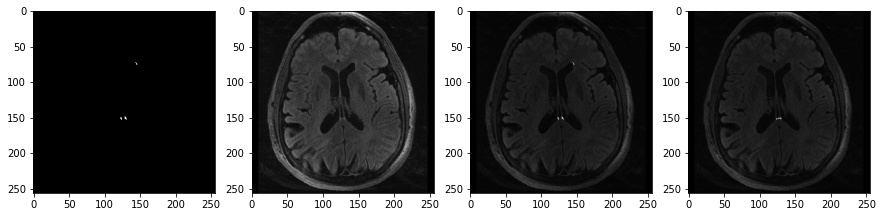

Val:  56%|██████▏    | 18/32 [00:01<00:01, 10.51it/s, acc=76.8329%, loss=0.3040]

<Figure size 432x288 with 0 Axes>

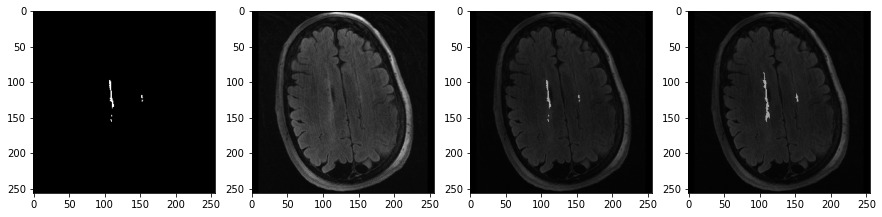

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.77it/s, acc=77.1361%, loss=0.2983]

<Figure size 432x288 with 0 Axes>

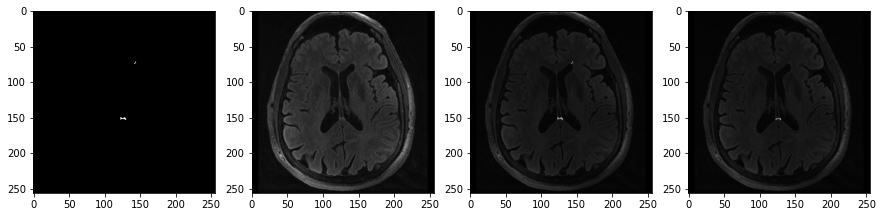

Train:   1%| | 1/157 [00:00<00:30,  5.13it/s, acc=95.5455%, loss=0.0476, lr=0.00

Val Acc 77.0146%	 Val Loss 0.3005


Train:  94%|▉| 148/157 [00:29<00:01,  5.10it/s, acc=94.5699%, loss=0.0582, lr=0.

KeyboardInterrupt: 

In [21]:
best_valacc = 0.0

for epoch in range(config['epochs']):
    
    # if epoch %49 == 0:
    #     optimizer = torch.optim.Adam(model.parameters(), lr=config['lr'], betas=(0.9, 0.999), eps=1e-08)
    #     scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode="min", factor=0.8, patience=2)
    #     curr_lr = float(optimizer.param_groups[0]['lr'])
    #     print(f'Epoch: {epoch}, Learning rate: {curr_lr}')

    epoch_train_acc, epoch_train_loss = train(model, epoch, train_loader, optimizer, criterion)
    curr_lr = float(optimizer.param_groups[0]['lr'])
    print("\nEpoch {}/{}: \nTrain Acc {:.04f}%\t Train Loss {:.04f}\t Learning Rate {:.04f}".format(
        epoch + 1,
        config['epochs'],
        epoch_train_acc,
        epoch_train_loss,
        curr_lr))
    epoch_test_acc, epoch_test_loss = validate(model, test_loader, criterion)
    scheduler.step(epoch_test_loss)
    
    print("Val Acc {:.04f}%\t Val Loss {:.04f}".format(epoch_test_acc, epoch_test_loss))
    
    wandb.log({"train_loss":epoch_train_loss, 'train_Acc': epoch_train_acc, 'validation_Acc':epoch_test_acc, 
               'validation_loss': epoch_test_loss, "learning_Rate": curr_lr})
    
    if epoch_test_acc >= best_valacc:
      #path = os.path.join(root, model_directory, 'checkpoint' + '.pth')
      print("Saving model")
      torch.save({'model_state_dict':model.state_dict(),
                  'optimizer_state_dict':optimizer.state_dict(),
                  #'scheduler_state_dict':scheduler.state_dict(),
                  'val_acc': epoch_test_acc, 
                  'epoch': epoch}, './7T_No_Norm.pth')
      best_valacc = epoch_test_acc
      # wandb.save('7T_no_Norm.pth')
run.finish()

In [24]:
loss

0.2969843337657954

Val:   3%|▍           | 1/32 [00:00<00:03,  9.87it/s, acc=72.1264%, loss=0.3863]

<Figure size 432x288 with 0 Axes>

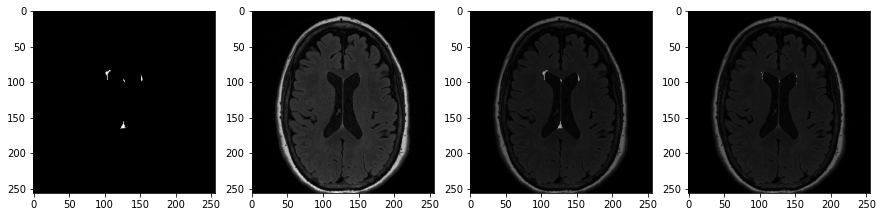

Val:  31%|███▍       | 10/32 [00:01<00:02,  9.91it/s, acc=76.0058%, loss=0.3172]

<Figure size 432x288 with 0 Axes>

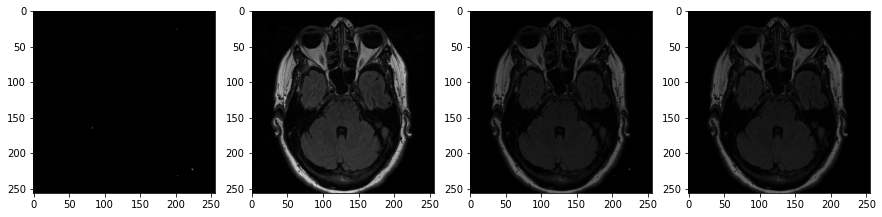

Val:  56%|██████▏    | 18/32 [00:02<00:01, 10.82it/s, acc=77.1918%, loss=0.2968]

<Figure size 432x288 with 0 Axes>

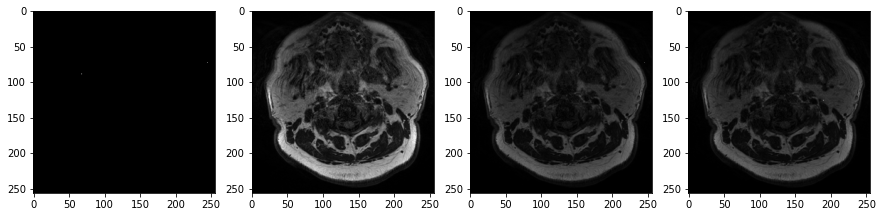

Val:  88%|█████████▋ | 28/32 [00:02<00:00, 11.86it/s, acc=77.2642%, loss=0.2954]

<Figure size 432x288 with 0 Axes>

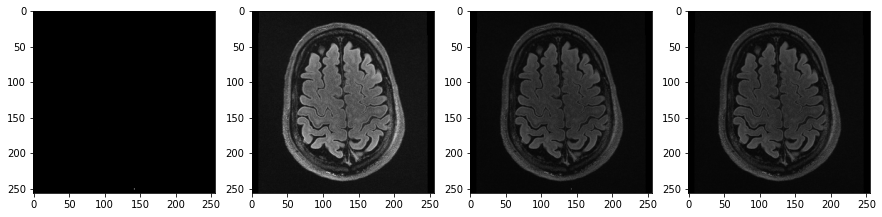

In [22]:
acc, loss = validate(model, test_loader, criterion)